## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

## Packages

In [256]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from ipywidgets import interact, interactive, fixed

%matplotlib inline
# %matplotlib qt

## Compute the camera calibration using chessboard images

The images are in the `./camera_cal` folder. Use the CV2 `findChessboardCorners` function to find the corners and add them to the image points list. We can then use this list and the list of object points in the CV2 `calibrateCamera` function to get the camera distortion coefficients.

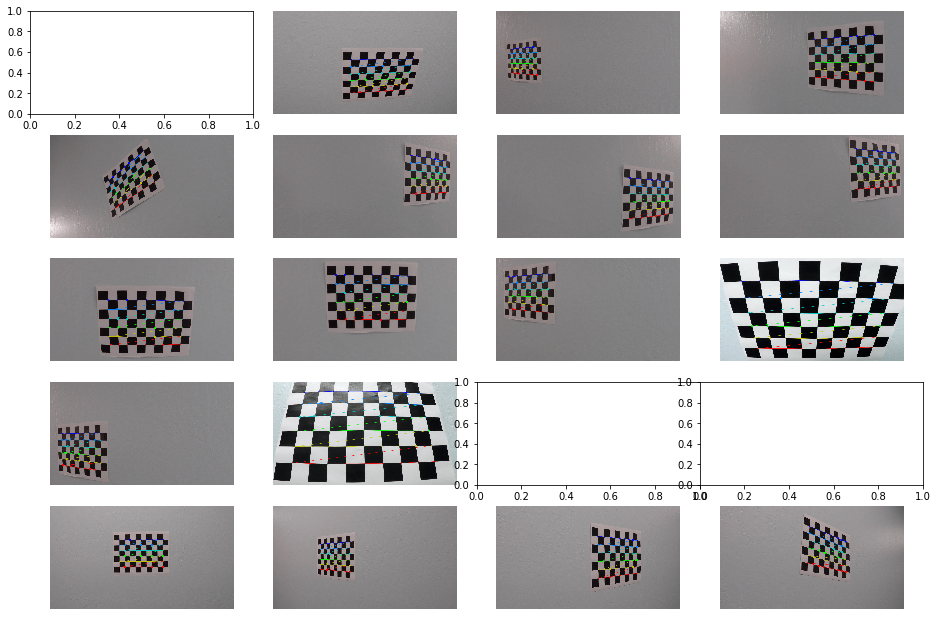

In [257]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

fig, axs = plt.subplots(5,4, figsize=(16, 11))
fig.subplots_adjust(hspace = .2, wspace=.001)
axs = axs.ravel()

# Step through the list and search for chessboard corners

for i, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        
        axs[i].axis('off')
        axs[i].imshow(img)

*** Note that some of the images do not show because the chessboard corners were not found (ret == False).

### Calculate the disortion coefficients

In [258]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

print("Camera Matrix")
print(mtx)
print("Distortion Coeffs")
print(dist)

Camera Matrix
[[  1.15396093e+03   0.00000000e+00   6.69705357e+02]
 [  0.00000000e+00   1.14802496e+03   3.85656234e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]
Distortion Coeffs
[[ -2.41017956e-01  -5.30721173e-02  -1.15810355e-03  -1.28318856e-04
    2.67125290e-02]]


### Helper function to apply the distortion correction to an image

In [259]:
def undistort(img, mtx, dist):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

### Example of applying distortion correction to an image

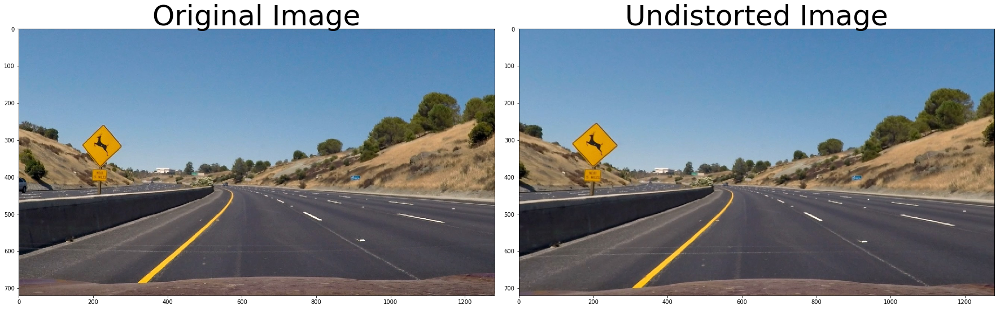

In [260]:
fname = './test_images/test2.jpg'

img = mpimg.imread(fname)

# Use the undistort function, with the mtx and dist calculated above
undist = undistort(img, mtx, dist)

### print an example plot of a comparison of a distorted and undistorted image
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undist)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

The undistorted image looks different around the sign and on the hood of the car.

# Perspective Transform

### Helper function to add lines to an image
this will help us view the prospective transforms

In [261]:
def add_lines(img, src):
    img2 = np.copy(img)
    color = [255, 0, 0] # Red
    thickness = 2
    x0, y0 = src[0]
    x1, y1 = src[1]
    x2, y2 = src[2]
    x3, y3 = src[3]
    cv2.line(img2, (x0, y0), (x1, y1), color, thickness)
    cv2.line(img2, (x1, y1), (x2, y2), color, thickness)
    cv2.line(img2, (x2, y2), (x3, y3), color, thickness)
    cv2.line(img2, (x3, y3), (x0, y0), color, thickness)
    return img2

In [262]:
def add_points(img, src):
    img2 = np.copy(img)
    color = [255, 0, 0] # Red
    thickness = -1
    radius = 15
    x0, y0 = src[0]
    x1, y1 = src[1]
    x2, y2 = src[2]
    x3, y3 = src[3]
    cv2.circle(img2, (x0, y0), radius, color, thickness)
    cv2.circle(img2, (x1, y1), radius, color, thickness)
    cv2.circle(img2, (x2, y2), radius, color, thickness)
    cv2.circle(img2, (x3, y3), radius, color, thickness)
    return img2

#### Function to warp images based on source and destination points

In [263]:
# Points for the original image

src = np.float32([
    [225, 660],
    [590, 450], 
    [695, 450], 
    [1075, 660]
])
# Points for the new image
dst = np.float32([
    [400, 720],
    [400, 0], 
    [w-400, 0], 
    [w-400, 720]
])


def warper(img):
    
    # Compute and apply perpective transform
    img_size = (img.shape[1], img.shape[0])
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)  # keep same size as input image

    return warped

def unwarp(img):
    
    # Compute and apply inverse perpective transform
    img_size = (img.shape[1], img.shape[0])
    Minv = cv2.getPerspectiveTransform(dst, src)
    unwarped = cv2.warpPerspective(img, Minv, img_size, flags=cv2.INTER_NEAREST)
    
    return unwarped

#### Generate warped perspectives for the straight lines to calibrate the points

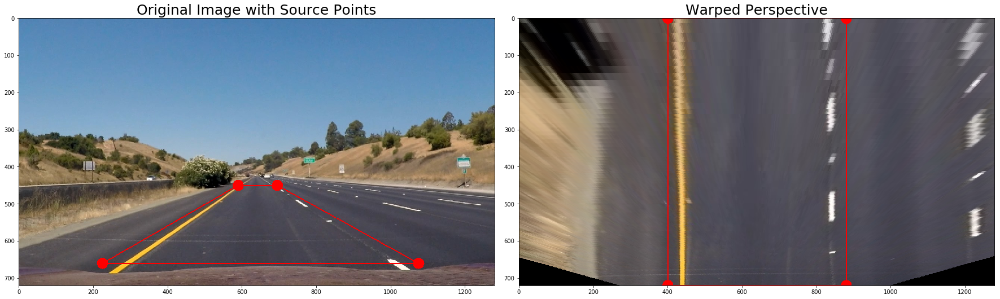

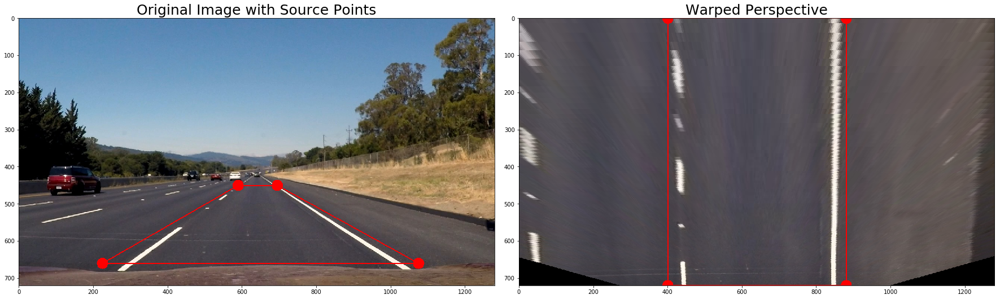

In [264]:
### get the straight test images from the test_images folder
images = glob.glob('./test_images/straight*.jpg')

for fname in images:
    
    img = mpimg.imread(fname)
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)
    
    # warp the image
    warped = warper(undist)

    # add the points to the og and warped images 
    src_points_img = add_points(img, src)
    src_points_img = add_lines(src_points_img, src)
    dst_points_warped = add_points(warped, dst)
    dst_points_warped = add_lines(dst_points_warped, dst)

    ### Plot the source points on the original image and the warped image
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(src_points_img)
    ax1.set_title('Original Image with Source Points', fontsize=25)
    ax2.imshow(dst_points_warped)
    ax2.set_title('Warped Perspective', fontsize=25)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


#### Run these settings over all the images and take a look

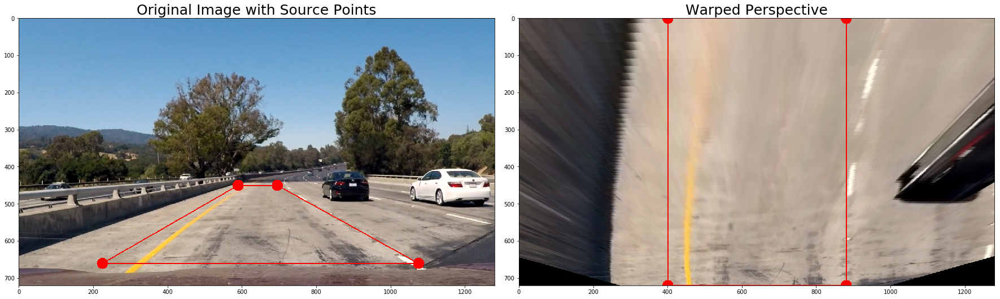

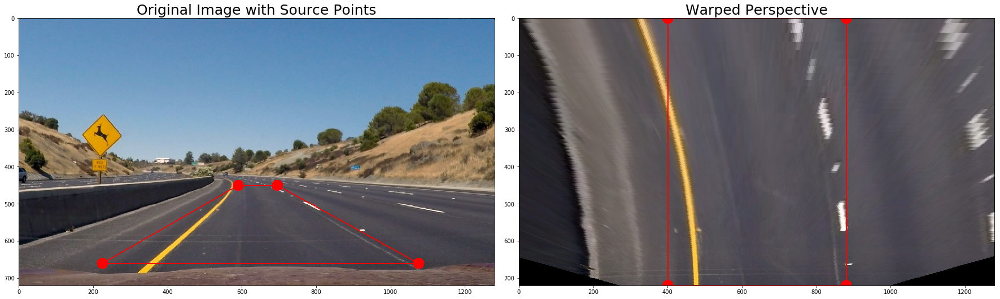

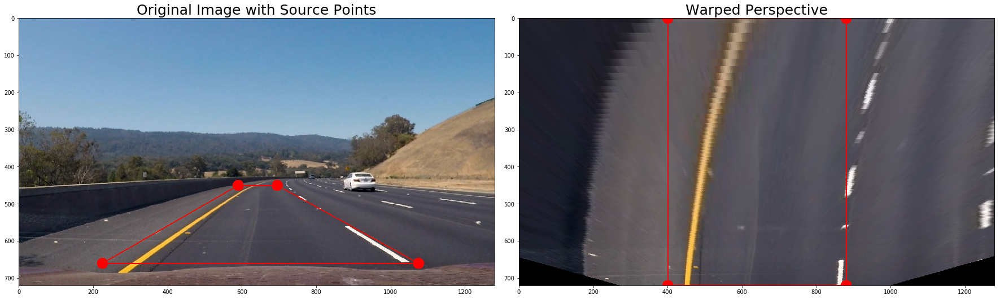

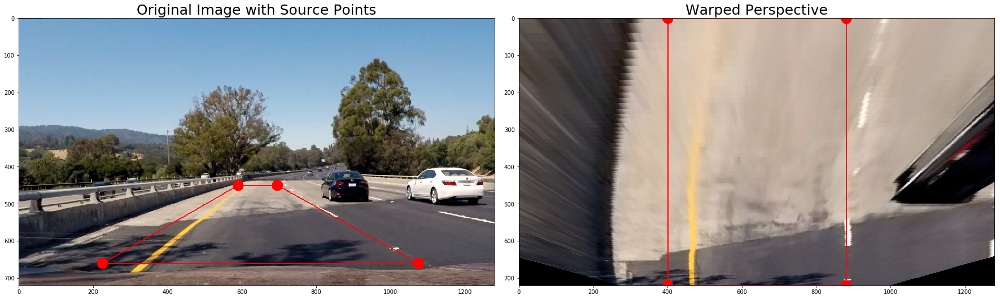

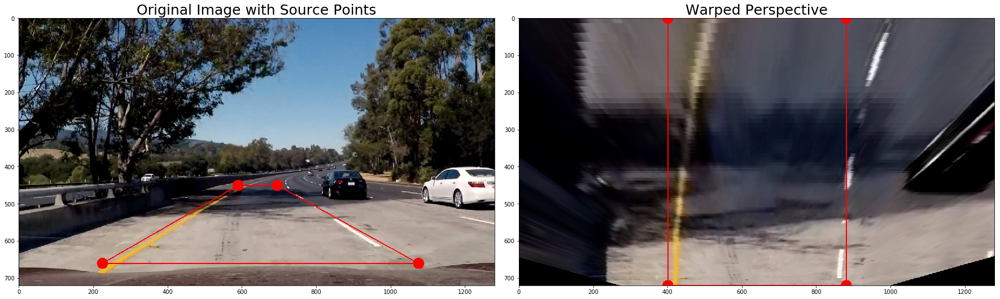

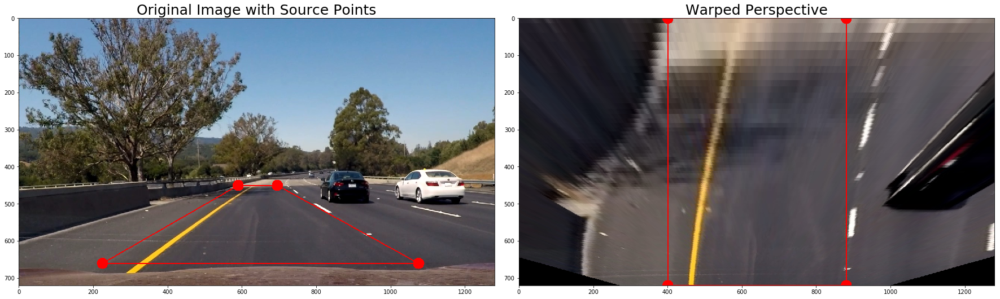

In [265]:
### get the straight test images from the test_images folder
images = glob.glob('./test_images/test*.jpg')

for fname in images:
    
    img = mpimg.imread(fname)
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image
    warped = warper(undist)

    # add the points to the og and warped images 
    src_points_img = add_points(img, src)
    src_points_img = add_lines(src_points_img, src)
    dst_points_warped = add_points(warped, dst)
    dst_points_warped = add_lines(dst_points_warped, dst)

    ### Plot the source points on the original image and the warped image
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(src_points_img)
    ax1.set_title('Original Image with Source Points', fontsize=25)
    ax2.imshow(dst_points_warped)
    ax2.set_title('Warped Perspective', fontsize=25)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

That looks pretty good! We're capturing most of the line information with the transform

# Investigation for binary threshold images

Loop through all the test images and take a look at the different channels for each type of color (RGB, HLS, HSV) to try and see which ones might work best for the binary thresholding

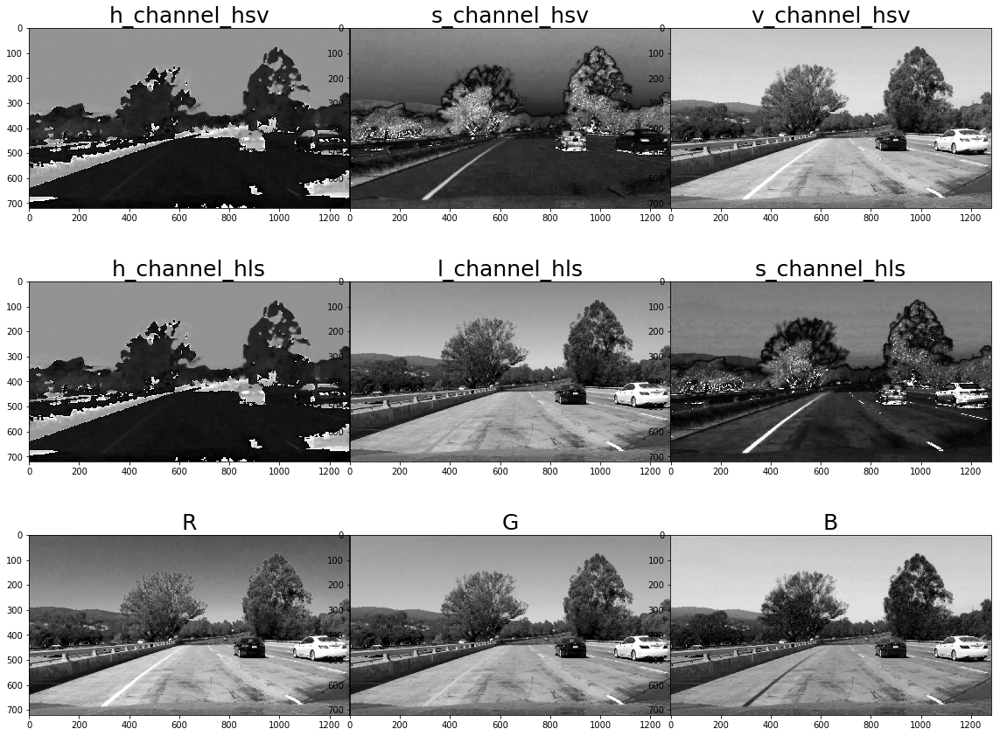

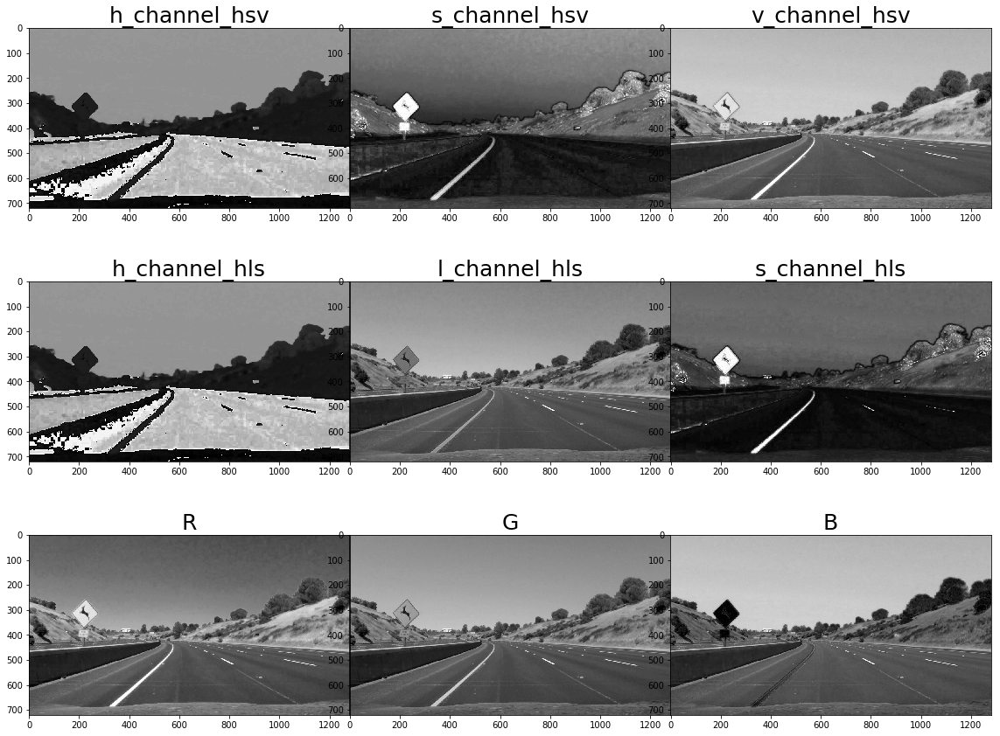

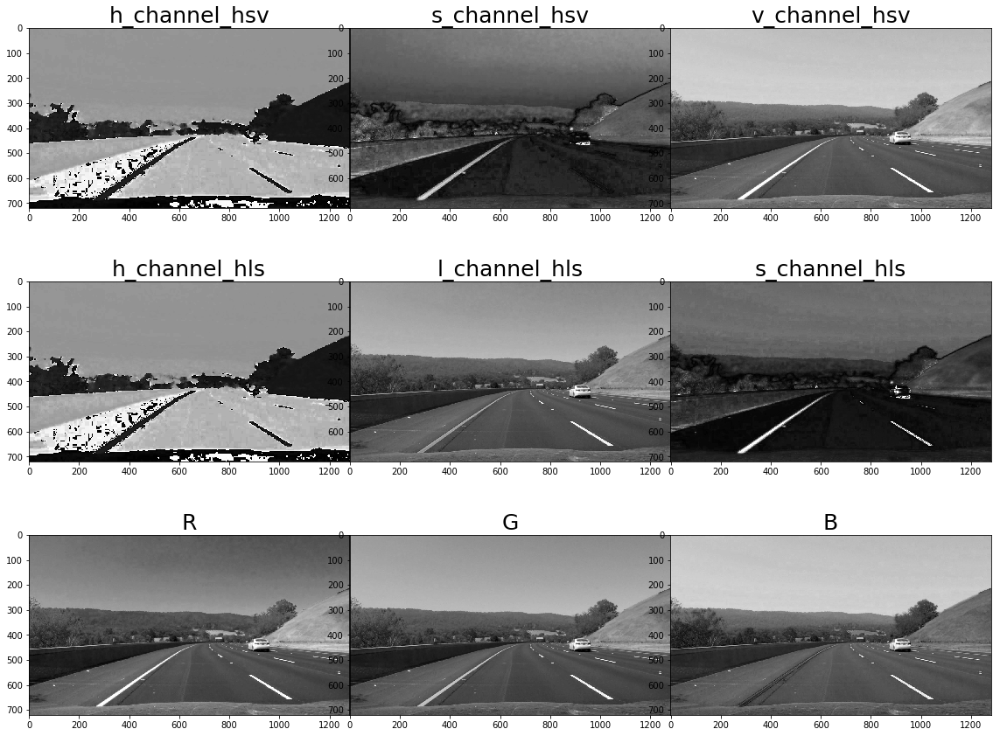

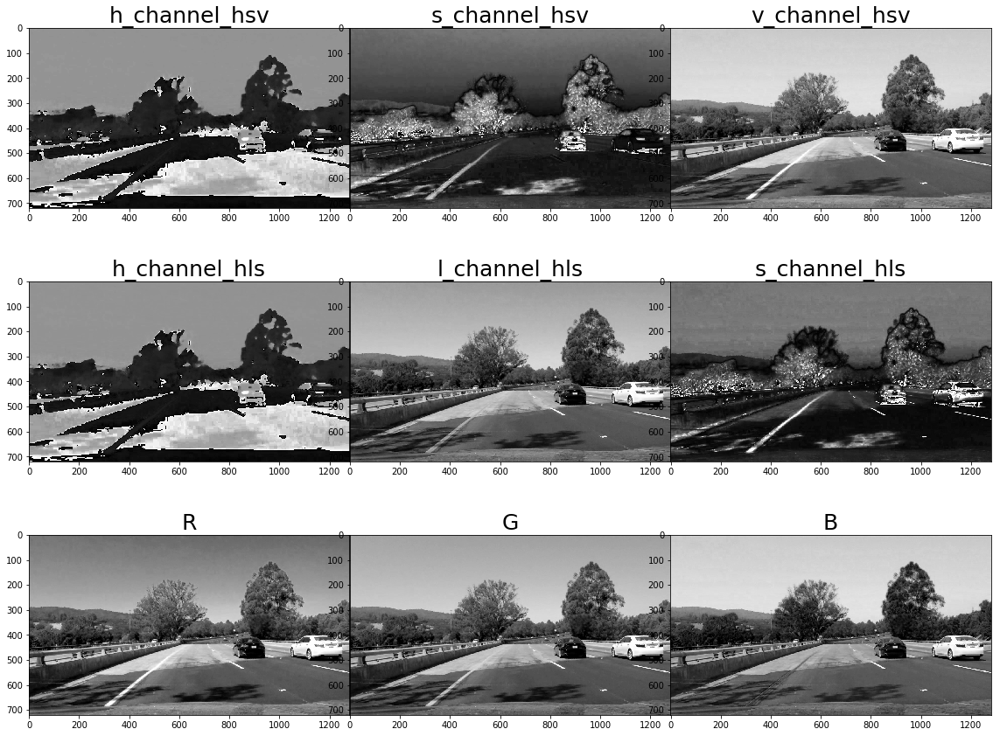

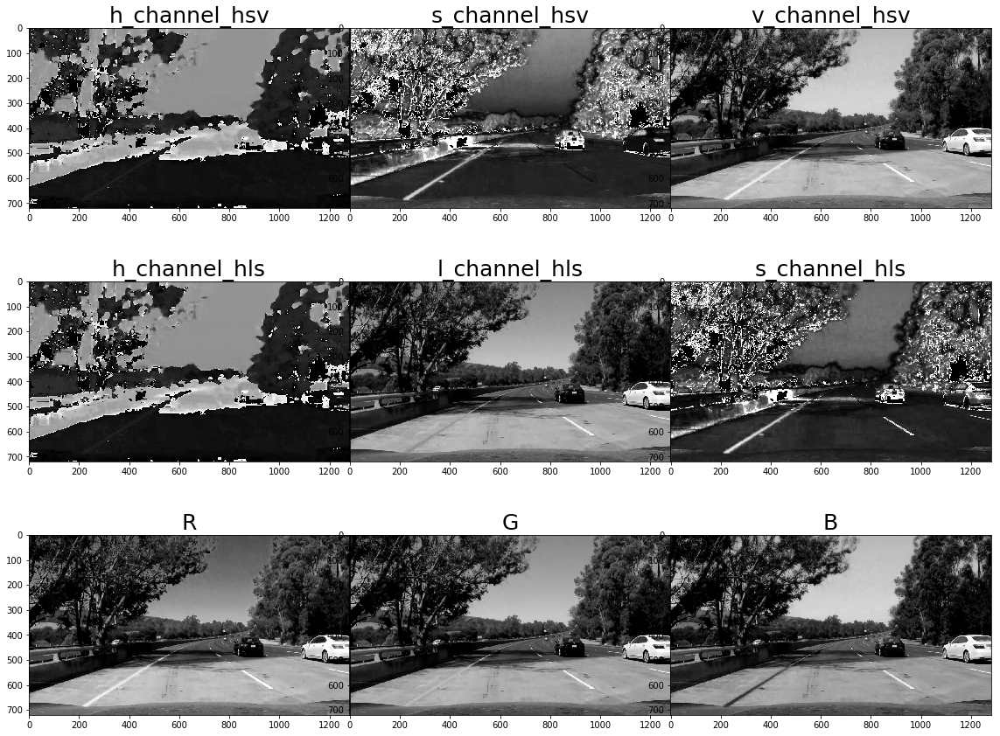

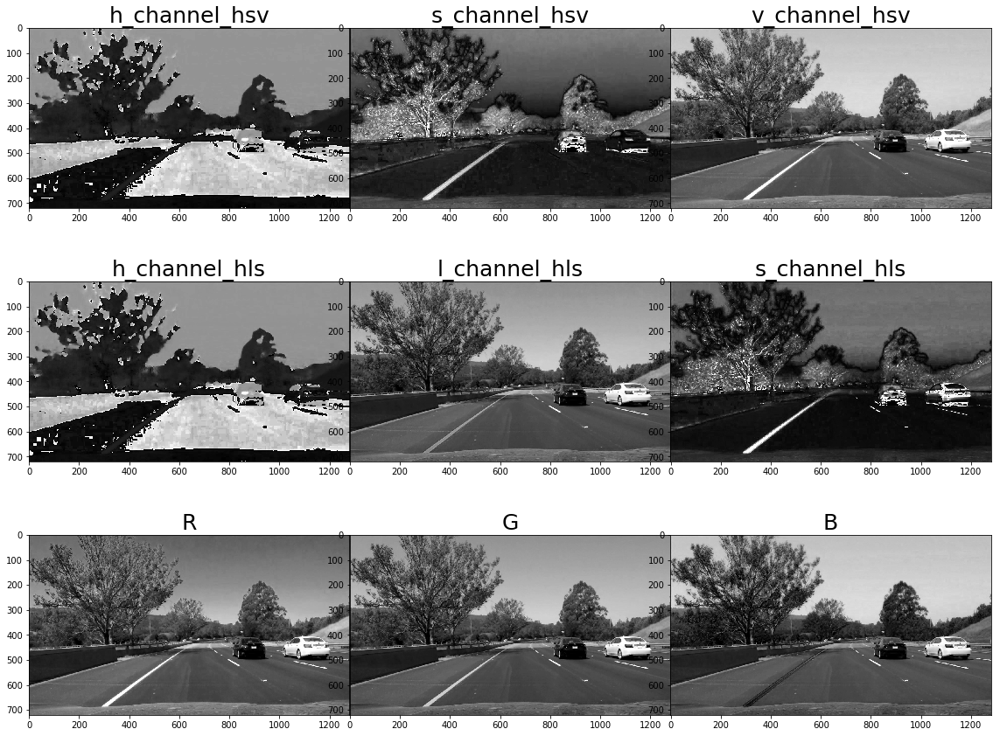

In [266]:
### get the test images from the test_images folder
images = glob.glob('./test_images/test*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY).astype(np.float)

    # Separate the RGB
    R = img[:,:,0]
    G = img[:,:,1]
    B = img[:,:,2]

    # Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel_hls = hls[:,:,0]
    l_channel_hls = hls[:,:,1]
    s_channel_hls = hls[:,:,2]

    # Convert to HSV color space
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV).astype(np.float)
    h_channel_hsv = hsv[:,:,0]
    s_channel_hsv = hsv[:,:,1]
    v_channel_hsv = hsv[:,:,2]

    ### Plot the source points on the original image and the warped image
    f, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3, 3, figsize=(16, 12))
    f.tight_layout()

    # Plot HSV colors
    ax1.imshow(h_channel_hsv, cmap='gray')
    ax1.set_title('h_channel_hsv', fontsize=25)
    ax2.imshow(s_channel_hsv, cmap='gray')
    ax2.set_title('s_channel_hsv', fontsize=25)
    ax3.imshow(v_channel_hsv, cmap='gray')
    ax3.set_title('v_channel_hsv', fontsize=25)
    
    # Plot HLS colors
    ax4.imshow(h_channel_hls, cmap='gray')
    ax4.set_title('h_channel_hls', fontsize=25)
    ax5.imshow(l_channel_hls, cmap='gray')
    ax5.set_title('l_channel_hls', fontsize=25)
    ax6.imshow(s_channel_hls, cmap='gray')
    ax6.set_title('s_channel_hls', fontsize=25)

    # Plot RGB
    ax7.imshow(R, cmap='gray')
    ax7.set_title('R', fontsize=25)
    ax8.imshow(G, cmap='gray')
    ax8.set_title('G', fontsize=25)
    ax9.imshow(B, cmap='gray')
    ax9.set_title('B', fontsize=25)

    plt.subplots_adjust(hspace = .2, wspace=.001)
    

From these images, it looks like the saturation channels could provide good data, also the V from HSV and the L from HLS. The Red channel from RGB could be promising as well.

### Do the same thing, but look at images with perspective transform

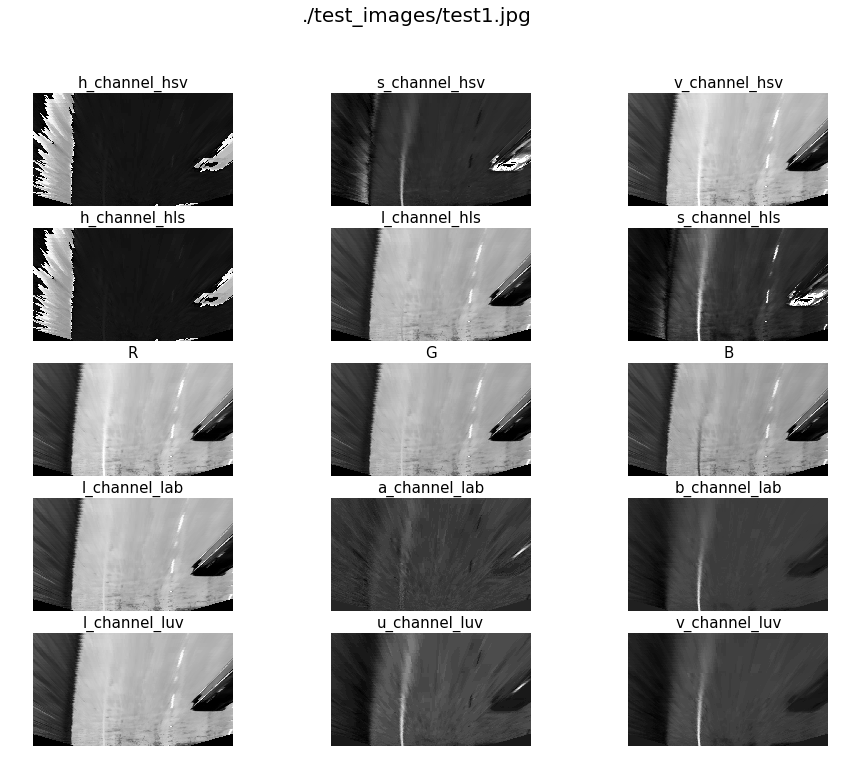

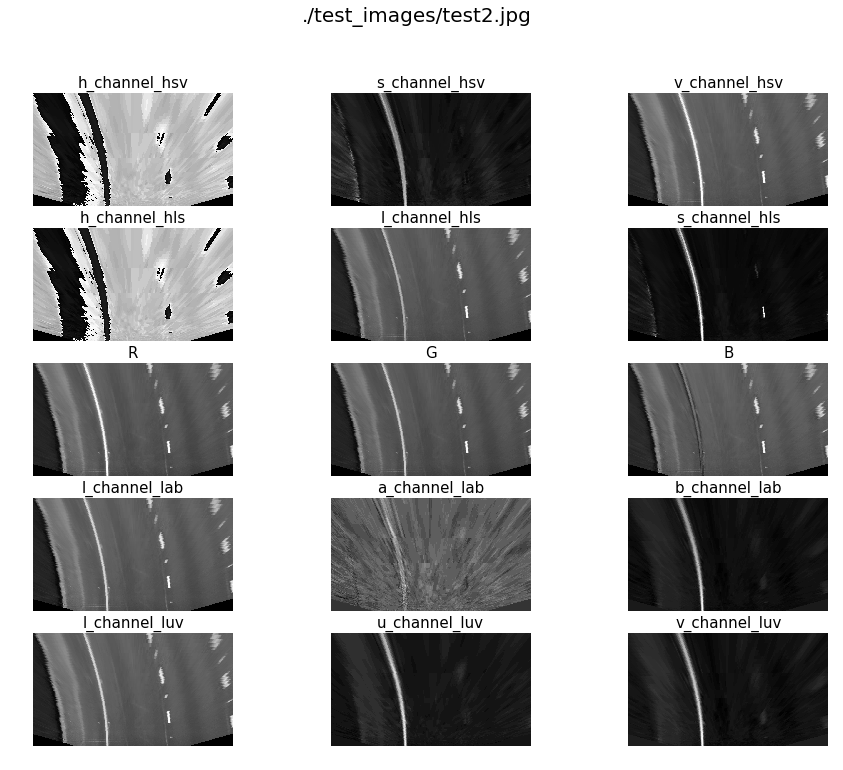

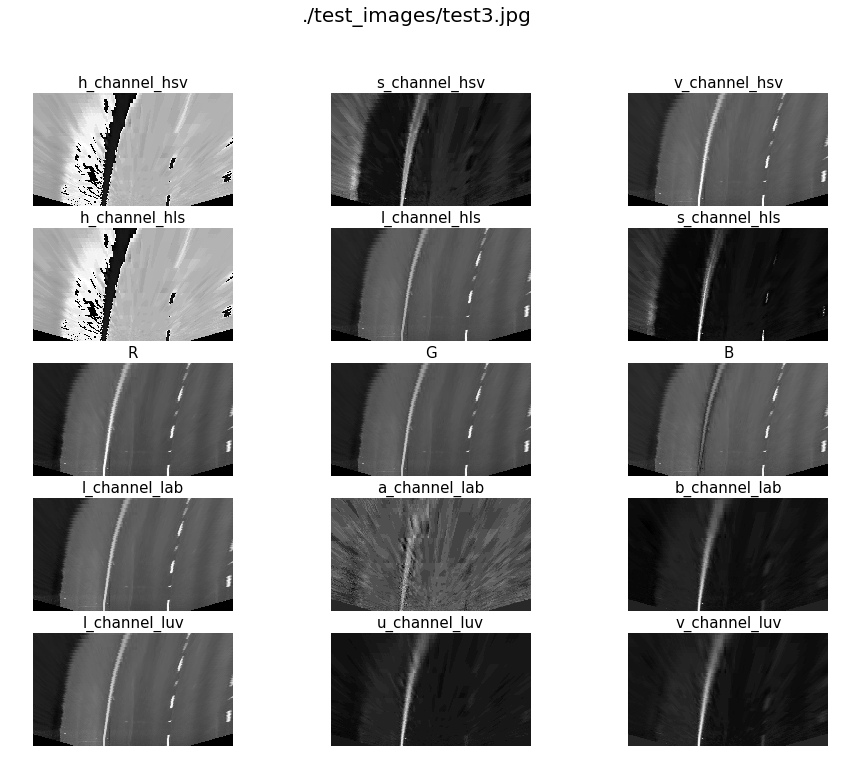

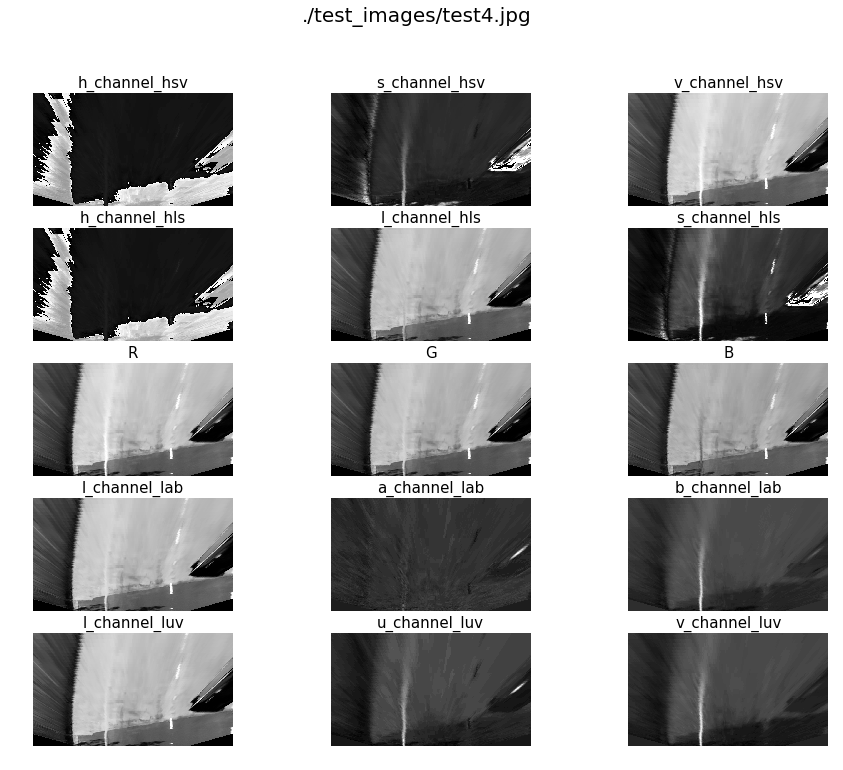

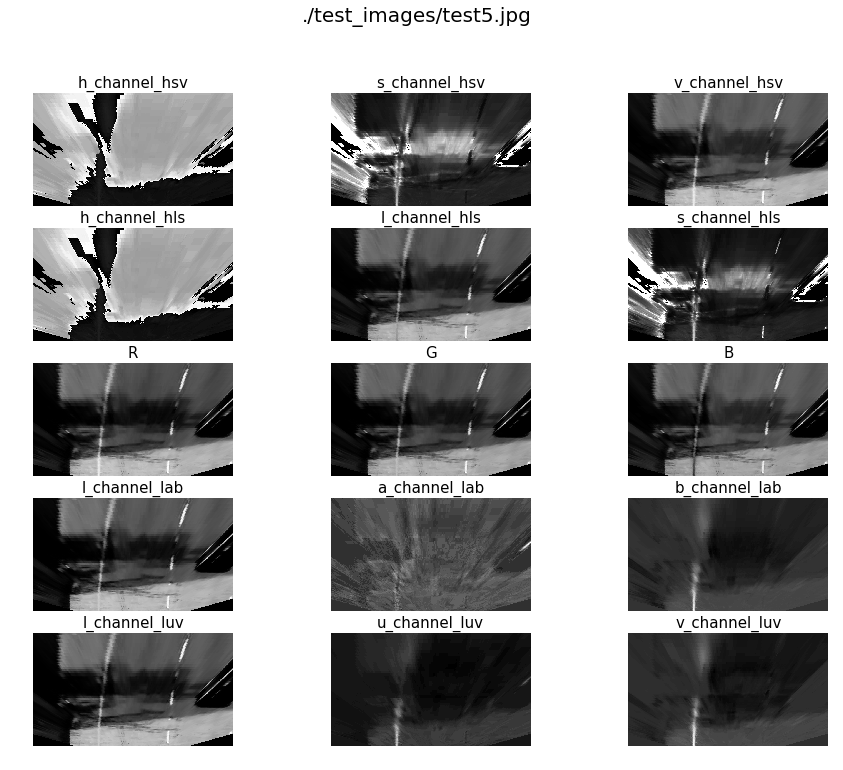

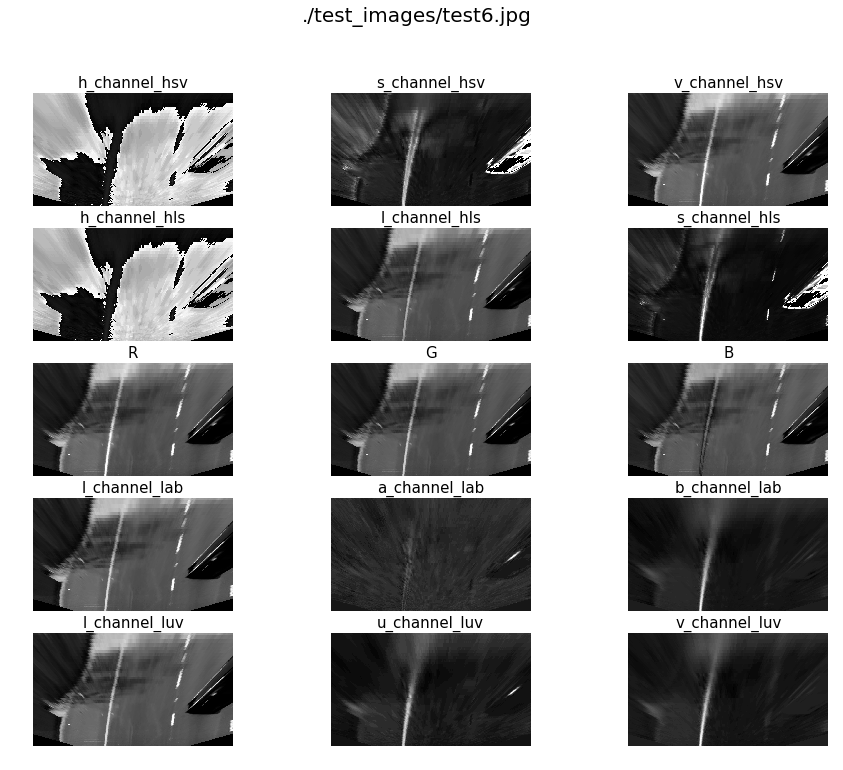

In [267]:
### get the test images from the test_images folder
images = glob.glob('./test_images/test*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)
    # warp the image
    warped = warper(undist)

    # Separate the RGB
    R = warped[:,:,0]
    G = warped[:,:,1]
    B = warped[:,:,2]

    # Convert to HLS color space
    hls = cv2.cvtColor(warped, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel_hls = hls[:,:,0]
    l_channel_hls = hls[:,:,1]
    s_channel_hls = hls[:,:,2]

    # Convert to HSV color space
    hsv = cv2.cvtColor(warped, cv2.COLOR_RGB2HSV).astype(np.float)
    h_channel_hsv = hsv[:,:,0]
    s_channel_hsv = hsv[:,:,1]
    v_channel_hsv = hsv[:,:,2]

    # Convert to LAB color space
    lab = cv2.cvtColor(warped, cv2.COLOR_RGB2Lab).astype(np.float)
    l_channel_lab = lab[:,:,0]
    a_channel_lab = lab[:,:,1]
    b_channel_lab = lab[:,:,2]
    
    # Convert to LUV color space
    luv = cv2.cvtColor(warped, cv2.COLOR_RGB2Luv).astype(np.float)
    l_channel_luv = luv[:,:,0]
    u_channel_luv = luv[:,:,1]
    v_channel_luv = luv[:,:,2]

    
    ### Plot the source points on the original image and the warped image
    f, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9),(ax10, ax11, ax12),(ax13, ax14, ax15)) = plt.subplots(5, 3, figsize=(16, 12))
#     f.tight_layout()
    f.suptitle(fname, fontsize=20)
    
    # Plot HSV colors
    ax1.imshow(h_channel_hsv, cmap='gray')
    ax1.axis('off')
    ax1.set_title('h_channel_hsv', fontsize=15)
    ax2.imshow(s_channel_hsv, cmap='gray')
    ax2.set_title('s_channel_hsv', fontsize=15)
    ax2.axis('off')
    ax3.imshow(v_channel_hsv, cmap='gray')
    ax3.set_title('v_channel_hsv', fontsize=15)
    ax3.axis('off')
    
    # Plot HLS colors
    ax4.imshow(h_channel_hls, cmap='gray')
    ax4.axis('off')
    ax4.set_title('h_channel_hls', fontsize=15)
    ax5.imshow(l_channel_hls, cmap='gray')
    ax5.set_title('l_channel_hls', fontsize=15)
    ax5.axis('off')
    ax6.imshow(s_channel_hls, cmap='gray')
    ax6.set_title('s_channel_hls', fontsize=15)
    ax6.axis('off')
    
    # Plot RGB
    ax7.imshow(R, cmap='gray')
    ax7.set_title('R', fontsize=15)
    ax7.axis('off')
    ax8.imshow(G, cmap='gray')
    ax8.set_title('G', fontsize=15)
    ax8.axis('off')
    ax9.imshow(B, cmap='gray')
    ax9.set_title('B', fontsize=15)
    ax9.axis('off')
    
    # Plot LAB
    ax10.imshow(l_channel_lab, cmap='gray')
    ax10.axis('off')
    ax10.set_title('l_channel_lab', fontsize=15)
    ax11.imshow(a_channel_lab, cmap='gray')
    ax11.axis('off')
    ax11.set_title('a_channel_lab', fontsize=15)
    ax12.imshow(b_channel_lab, cmap='gray')
    ax12.set_title('b_channel_lab', fontsize=15)
    ax12.axis('off')
    
    # Plot LUV
    ax13.imshow(l_channel_luv, cmap='gray')
    ax13.axis('off')
    ax13.set_title('l_channel_luv', fontsize=15)
    ax14.imshow(u_channel_luv, cmap='gray')
    ax14.set_title('u_channel_luv', fontsize=15)
    ax14.axis('off')
    ax15.imshow(v_channel_luv, cmap='gray')
    ax15.set_title('v_channel_luv', fontsize=15)
    ax15.axis('off')
    
    plt.subplots_adjust(hspace = .2, wspace=.001)

### Look at binary outputs from these different channels on one of the images, and fiddle with the thresholds

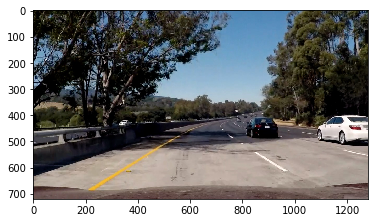

In [268]:
fname = glob.glob('./test_images/test5.jpg')
img = mpimg.imread(fname[0])

# Undistort the image based on the camera calibration
undist = undistort(img, mtx, dist)

# warp the image
warped = warper(undist)

fname

plt.imshow(img)

#### Helper function to apply the given thresholds to a gvien image color channel

In [269]:
def applyThreshold(channel, thresh):
    # 2) Apply a threshold to the S channel
    binary_output = np.zeros_like(channel)
    
    # Inclusive thresholds 
    binary_output[(channel >= thresh[0]) & (channel <= thresh[1])] = 1
    
    # 3) Return a binary image of threshold result
    return binary_output

#### HLS Saturation Channel 

In [270]:

def hls_sthresh(img, thresh=(125, 255)):
    # Convert to HLS
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # Pull out the S channelc
    s_channel = hls[:,:,2]
    # Return the applied threshold binary image
    return applyThreshold(s_channel, thresh)
    

<function __main__.hls_sthresh_update>

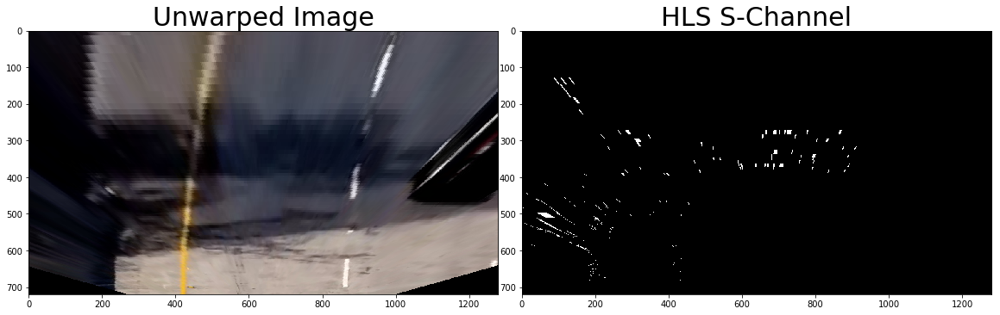

In [271]:
def hls_sthresh_update(min_thresh, max_thresh):
    
    img_sthresh = hls_sthresh(warped, (min_thresh, max_thresh))
    
    # Plot the warped image and the result of the thresholding
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(warped)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(img_sthresh, cmap='gray')
    ax2.set_title('HLS S-Channel', fontsize=30)

interact(hls_sthresh_update,
         min_thresh=(0,255), 
         max_thresh=(0,255))

#### HLS L Channel

In [272]:
def hls_lthresh(img, thresh=(125, 255)):
    # Convert to HLS
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # Pull out the L channelc
    channel = hls[:,:,1]
    # Return the applied threshold binary image
    return applyThreshold(channel, thresh)
    

<function __main__.hls_lthresh_update>

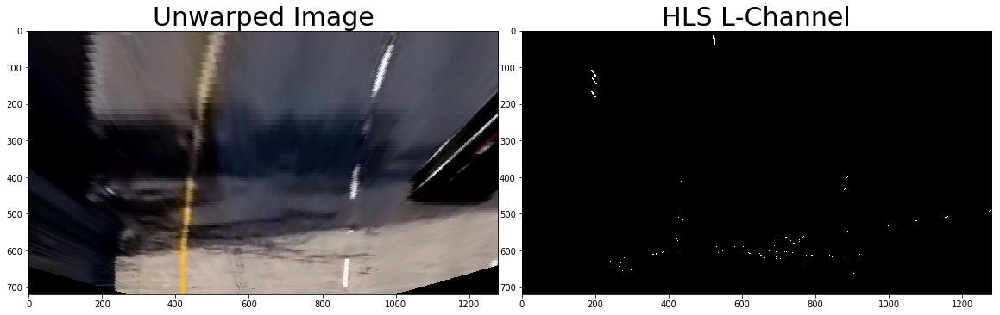

In [273]:
def hls_lthresh_update(min_thresh, max_thresh):
    
    img_lthresh = hls_lthresh(warped, (min_thresh, max_thresh))
    
    # Plot the warped image and the result of the thresholding
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(warped)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(img_lthresh, cmap='gray')
    ax2.set_title('HLS L-Channel', fontsize=30)

interact(hls_lthresh_update,
         min_thresh=(0,255), 
         max_thresh=(0,255))

#### HSV V channel

In [274]:
def hsv_vthresh(img, thresh=(125, 255)):
    # Convert to HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    # Pull out the V channelc
    channel = hsv[:,:,1]
    # Return the applied threshold binary image
    return applyThreshold(channel, thresh)

<function __main__.hsv_vthresh_update>

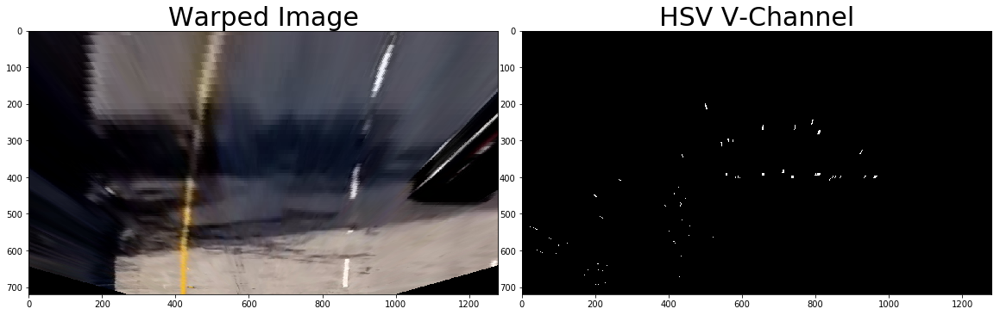

In [275]:
def hsv_vthresh_update(min_thresh, max_thresh):
    
    thresh_img = hsv_vthresh(warped, (min_thresh, max_thresh))
    
    # Plot the warped image and the result of the thresholding
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(warped)
    ax1.set_title('Warped Image', fontsize=30)
    ax2.imshow(thresh_img, cmap='gray')
    ax2.set_title('HSV V-Channel', fontsize=30)

interact(hsv_vthresh_update,
         min_thresh=(0,255), 
         max_thresh=(0,255))

### RGB Red Channel

In [276]:
def rgb_rthresh(img, thresh=(125, 255)):
    # Pull out the R channelc
    channel = img[:,:,0]
    # Return the applied threshold binary image
    return applyThreshold(channel, thresh)

<function __main__.rgb_rthresh_update>

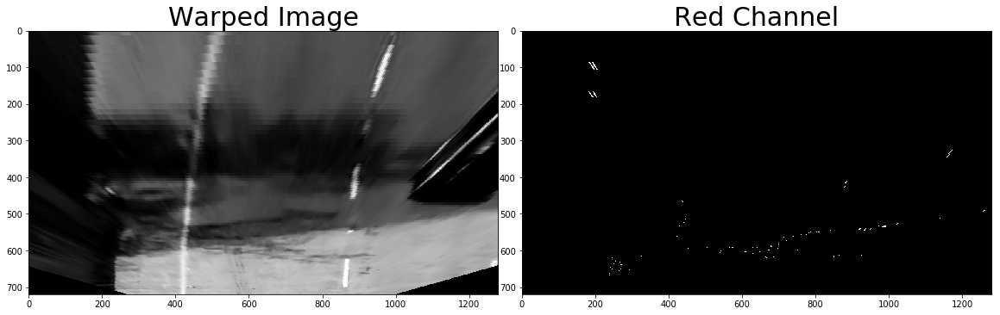

In [277]:
def rgb_rthresh_update(min_thresh, max_thresh):
    
    thresh_img = rgb_rthresh(warped, (min_thresh, max_thresh))
    
    # Plot the warped image and the result of the thresholding
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(warped[:,:,0], cmap='gray')
    ax1.set_title('Warped Image', fontsize=30)
    ax2.imshow(thresh_img, cmap='gray')
    ax2.set_title('Red Channel', fontsize=30)

interact(rgb_rthresh_update,
         min_thresh=(0,255), 
         max_thresh=(0,255))

#### Loop thorugh each image with some of the settings we've found here, and see how we do

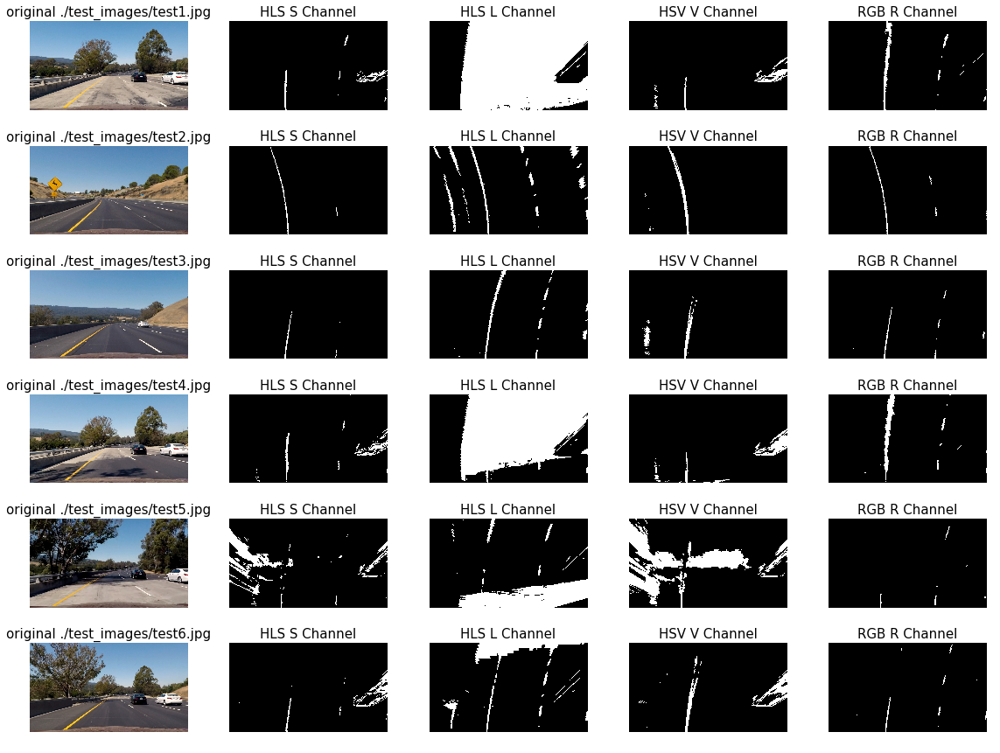

In [278]:
images = glob.glob('./test_images/test*.jpg')

f, axs = plt.subplots(6, 5, figsize=(16, 12))
f.tight_layout()
axs = axs.ravel()

i = 0
for fname in images:
    img = mpimg.imread(fname)

    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image
    warped = warper(undist)
    
    S = hls_sthresh(warped, thresh=(175, 255))
    L = hls_lthresh(warped, thresh=(125, 255))
    V = hsv_vthresh(warped, thresh=(125, 255))
    R = rgb_rthresh(warped, thresh=(225, 255))
    
    axs[i].axis('off')
    axs[i].imshow(undist)
    axs[i].set_title('original ' + str(fname) , fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(S, cmap='gray')
    axs[i].set_title('HLS S Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(L, cmap='gray')
    axs[i].set_title('HLS L Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(V, cmap='gray')
    axs[i].set_title('HSV V Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(R, cmap='gray')
    axs[i].set_title('RGB R Channel', fontsize=15)
    i += 1

Looking at this, the S and the R channel probably do the best on these example images.

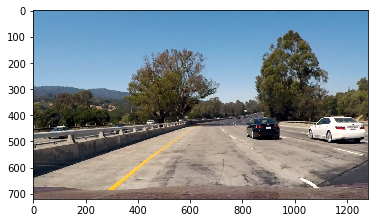

In [279]:
fname = glob.glob('./test_images/test1.jpg')
img = mpimg.imread(fname[0])

# Undistort the image based on the camera calibration
undist = undistort(img, mtx, dist)

# warp the image
warped = warper(undist)

plt.imshow(img)

In [280]:
# Define a function that applies Sobel x and y, 
# then computes the magnitude of the gradient
# and applies a threshold
def calc_sobel(img, sobel_kernel=25, mag_thresh=(25, 255)):
    
    # Convert to grayscale - sobel can only have one color channel
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    L = hls[:,:,1]
    
    # Take the sobel gradient in x and y
    sobelx = cv2.Sobel(L, cv2.CV_64F, 1, 0)
    sobely = cv2.Sobel(L, cv2.CV_64F, 0, 1)
    
    # Calculate the magnitude 
#     mag_sobel = np.sqrt(np.square(sobelx) + np.square(sobely))
    
    # Scale to 8-bit (0 - 255) and convert to type = np.uint8
#     scaled_sobel = np.uint8(255*mag_sobel/np.max(mag_sobel))
    scaled_sobel = np.uint8(255*sobelx/np.max(sobelx))
    
    # Create a binary mask where mag thresholds are met
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1
    
    return sxbinary


<function __main__.update>

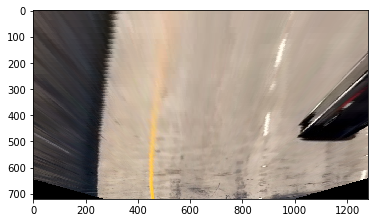

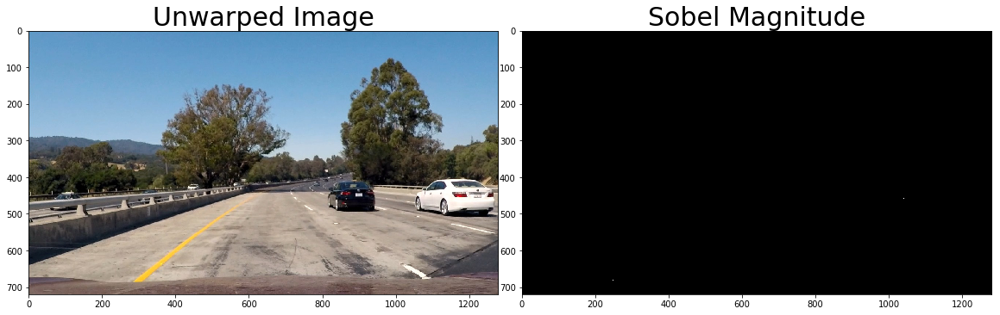

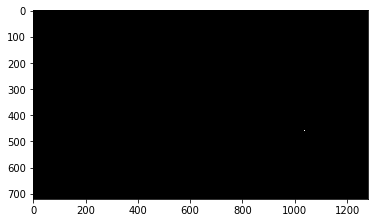

In [281]:



def update(kernel_size, min_thresh, max_thresh):
    plt.imshow(warped)
    sobel = calc_sobel(warped, kernel_size, (min_thresh, max_thresh))
    # Visualize sobel magnitude threshold
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(img)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(sobel, cmap='gray')
    ax2.set_title('Sobel Magnitude', fontsize=30)
    
#     warped_sobel = warper(sobel)
    warped_sobel = sobel
    
    plt.figure()
    plt.imshow(warped_sobel, cmap='gray')

interact(update, kernel_size=(1,31,2), 
                 min_thresh=(0,255), 
                 max_thresh=(0,255))

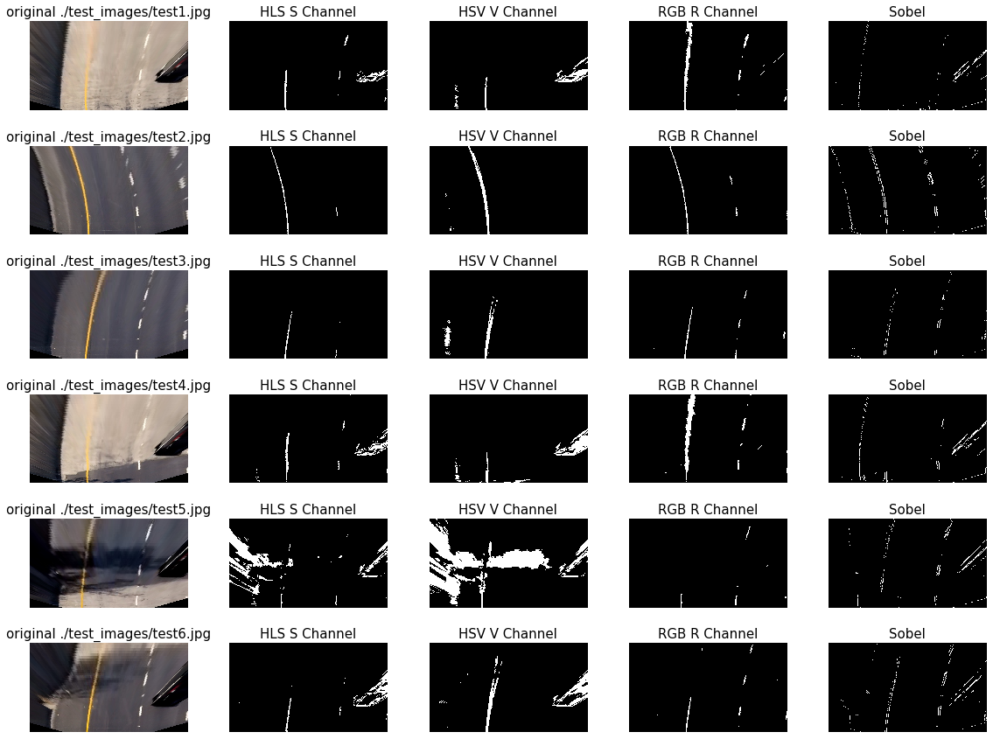

In [282]:
images = glob.glob('./test_images/test*.jpg')

f, axs = plt.subplots(6, 5, figsize=(16, 12))
f.tight_layout()
axs = axs.ravel()

i = 0
for fname in images:
    img = mpimg.imread(fname)

    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image
    warped = warper(undist)
    
    S = hls_sthresh(warped, thresh=(175, 255))
    L = hls_lthresh(warped, thresh=(200,255))
    V = hsv_vthresh(warped, thresh=(125, 255))
    R = rgb_rthresh(warped, thresh=(225, 255))
    
    # Calc the sobel stuffs
    sobel = calc_sobel(warped, sobel_kernel=15,  mag_thresh=(50, 220))
    
    axs[i].axis('off')
    axs[i].imshow(warped)
    axs[i].set_title('original ' + str(fname) , fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(S, cmap='gray')
    axs[i].set_title('HLS S Channel', fontsize=15)
    i += 1
#     axs[i].axis('off')
#     axs[i].imshow(L, cmap='gray')
#     axs[i].set_title('HLS L Channel', fontsize=15)
#     i += 1
    axs[i].axis('off')
    axs[i].imshow(V, cmap='gray')
    axs[i].set_title('HSV V Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(R, cmap='gray')
    axs[i].set_title('RGB R Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(sobel, cmap='gray')
    axs[i].set_title('Sobel', fontsize=15)
    i += 1

## Image Pipeline

In [283]:

def binaryPipe(img):
    
    # Copy the image
    img = np.copy(img)

    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image based on our perspective transform
    warped = warper(undist)
    
    # Get the Red and saturation images
    red = rgb_rthresh(warped, thresh=(225, 255))
    # sat = hls_sthresh(warped, thresh=(175, 255))
    
    # Run the sobel magnitude calculation
    sobel = calc_sobel(warped, sobel_kernel=15,  mag_thresh=(50, 220))
    
    # combine these layers
    combined_binary = np.zeros_like(sobel)
    combined_binary[ (red == 1) | sobel == 1] = 1 #(sat == 1) |
    
    return combined_binary

### Test the image pipeline, and print the intermediate images along with the final one

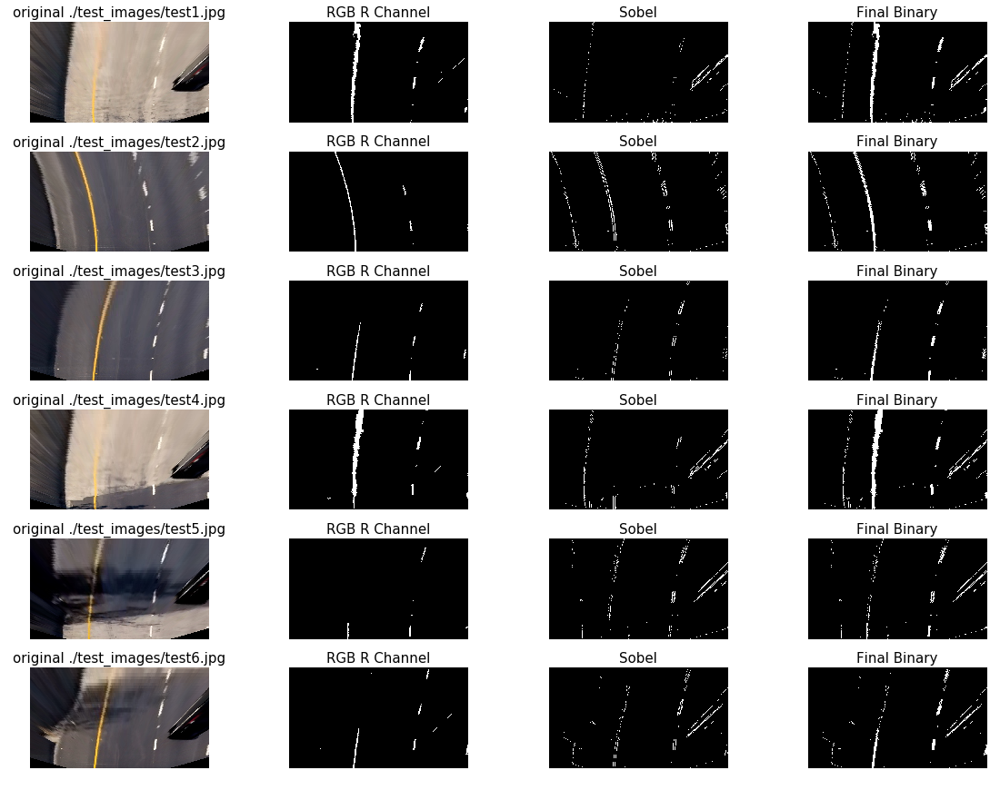

In [284]:
images = glob.glob('./test_images/test*.jpg')

f, axs = plt.subplots(6, 4, figsize=(16, 12))
f.tight_layout()
axs = axs.ravel()

i = 0
for fname in images:
    img = mpimg.imread(fname)
    
    # Run this through our binary pipeline
    binary_img = binaryPipe(img)
    
    ### The below is just so we can see the makeup of the binary pipeline
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)

    # warp the image
    warped = warper(undist)
    
    S = hls_sthresh(warped, thresh=(150, 255))
    L = hls_lthresh(warped, thresh=(200,255))
    V = hsv_vthresh(warped, thresh=(125, 255))
    R = rgb_rthresh(warped, thresh=(225, 255))
    
    # Calc the sobel stuffs
    sobel = calc_sobel(warped, sobel_kernel=15,  mag_thresh=(50, 220))
    
    axs[i].axis('off')
    axs[i].imshow(warped)
    axs[i].set_title('original ' + str(fname) , fontsize=15)
    i += 1
#     axs[i].axis('off')
#     axs[i].imshow(S, cmap='gray')
#     axs[i].set_title('HLS S Channel', fontsize=15)
#     i += 1
    axs[i].axis('off')
    axs[i].imshow(R, cmap='gray')
    axs[i].set_title('RGB R Channel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(sobel, cmap='gray')
    axs[i].set_title('Sobel', fontsize=15)
    i += 1
    axs[i].axis('off')
    axs[i].imshow(binary_img, cmap='gray')
    axs[i].set_title('Final Binary', fontsize=15)
    i += 1

This seems pretty good. The shadows in the test5 image aren't perfect, but it's looks like it's going to probably be good enough (TM). 

## Finding and fitting the lane line pixels

To find the lane lines we'll use the histogram and window technique that was described in the lectures.

In [312]:
# From lecture:
ym_per_pix = 30/720 # meters per pixel in y dimension
# xm_per_pix = 3.7/700 # meters per pixel in x dimension

# ym_per_pix = 3.0/100 # meters per pixel in y dimension, lane line is 10 ft = 3 meters
xm_per_pix = 3.7/550 # meters per pixel in x dimension, lane width is 12 ft = 3.7 meters

def calc_line_fits(img):

    ### Settings
    # Choose the number of sliding windows (for these images, the height is 450)
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Take a histogram of the bottom half of the image
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0)

    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((img, img, img))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Set height of windows
    window_height = np.int(img.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window+1)*window_height
        win_y_high = img.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2)
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2)
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Fit a second order polynomial to each
    left_fit_m = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_m = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    return left_fit, right_fit, left_fit_m, right_fit_m, out_img


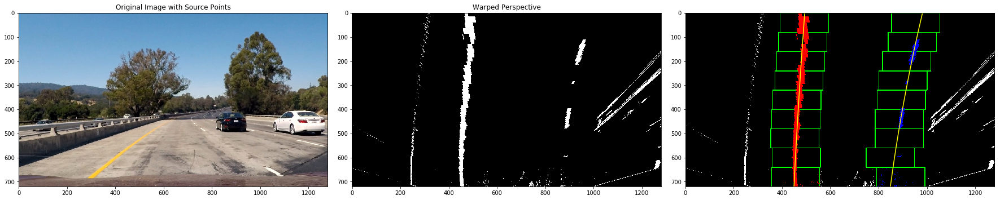

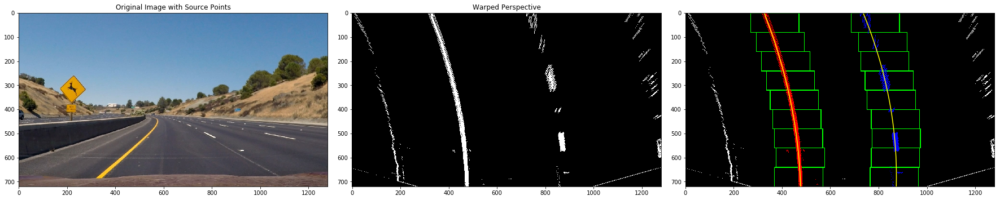

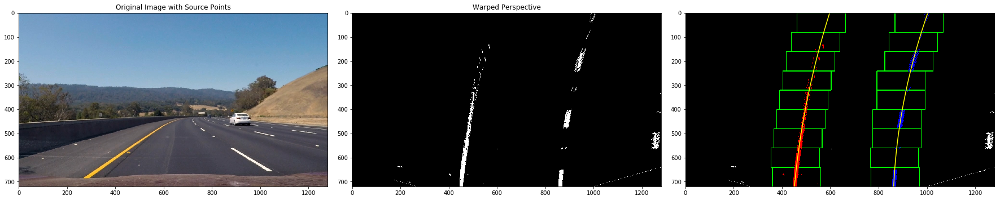

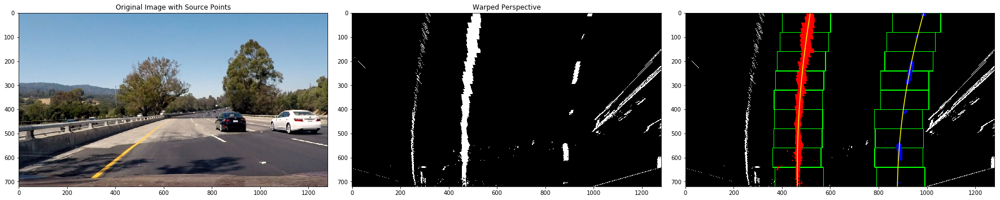

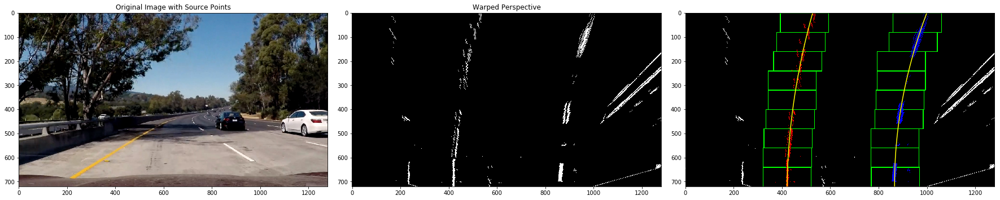

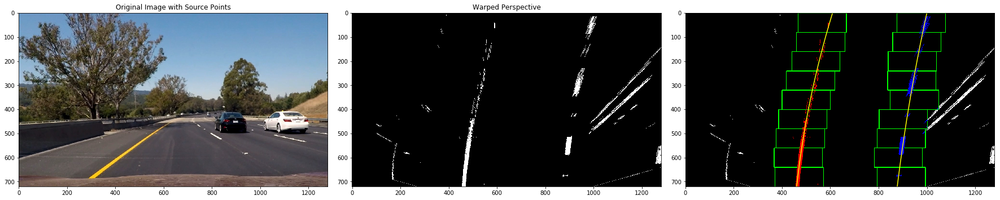

In [313]:
### get the test images from the test_images folder
images = glob.glob('./test_images/test*.jpg')


### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    img_og = np.copy(img)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    # Run the warped, binary image from the pipeline through the fitter
    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(binary_warped)

    ### Plot the original image, the binary warped image, and the visualization from the fitter
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image with Source Points')
    
    ax2.imshow(binary_warped, cmap='gray')
    ax2.set_title('Warped Perspective')
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    ax3.imshow(out_img)
    ax3.plot(left_fitx, ploty, color='yellow')
    ax3.plot(right_fitx, ploty, color='yellow')
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



These plots and fits are looking pretty good!

### Calculate lines using previous lines

We can find lines faster if we know where to look, by using the fit from the last frame.

In [314]:

def calc_line_fits_from_prev(img, leftLine, rightLine):

    left_fit = leftLine.best_fit_px
    right_fit = rightLine.best_fit_px
    
    ### Settings
    margin = 100 # Width on either side of the fitted line to search

    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin))) 
    
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Fit a second order polynomial to each in meters
    left_fit_m = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_m = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

    return left_fit, right_fit, left_fit_m, right_fit_m, result

Looking at the test images, it looks like the test6 > test4 > test5 are taken roughly right after one another from a video, so let's use these to test our fits

x0:  462.959135223
lane to camera px:  177.040864777
lane to camera m:  1.63762799918
x0:  879.739464731
lane to camera px:  239.739464731
lane to camera m:  2.21759004876
x0:  463.487055806
lane to camera px:  176.512944194
lane to camera m:  1.63274473379
x0:  878.533632747
lane to camera px:  238.533632747
lane to camera m:  2.20643610291
x0:  450.994718207
lane to camera px:  189.005281793
lane to camera m:  1.74829885659
x0:  874.42277111
lane to camera px:  234.42277111
lane to camera m:  2.16841063277


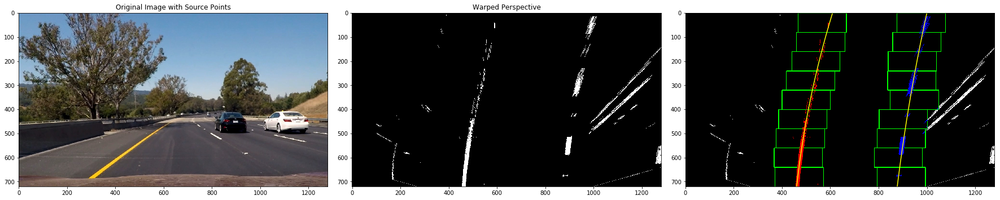

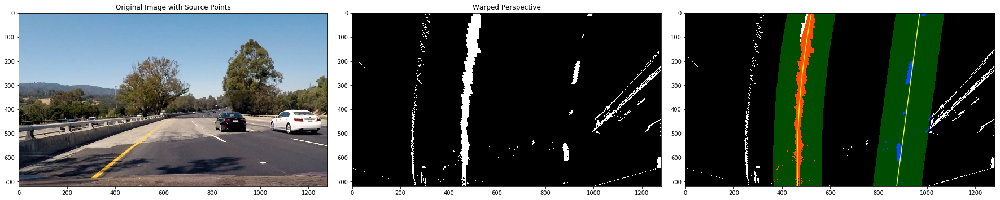

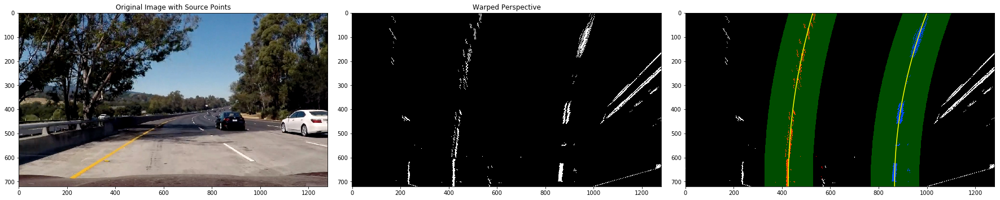

In [315]:


images = ['./test_images/test6.jpg', './test_images/test4.jpg', './test_images/test5.jpg']

leftLine = Line()
rightLine = Line()

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    img_og = np.copy(img)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    ## I know that test 6 is the first image, so use the calc_line_fits on that image,
    ## otherwise use the calc_line_fits_from_prev function to test it.
    if fname == './test_images/test6.jpg':
    
        # Run the warped, binary image from the pipeline through the fitter
        left_fit, right_fit, left_fit_m, right_fit_m, result = calc_line_fits(binary_warped)

        # Add these fits to the line classes
        leftLine.add_new_fit(left_fit, left_fit_m)
        rightLine.add_new_fit(right_fit, left_fit_m)
        
        ### Plot the original image, the binary warped image, and the visualization from the fitter
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(img)
        ax1.set_title('Original Image with Source Points')

        ax2.imshow(binary_warped, cmap='gray')
        ax2.set_title('Warped Perspective')

        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        ax3.imshow(out_img)
        ax3.plot(left_fitx, ploty, color='yellow')
        ax3.plot(right_fitx, ploty, color='yellow')

        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

    else:
    
        left_fit, right_fit, left_inds, right_inds, result = calc_line_fits_from_prev(binary_warped, leftLine, rightLine)
        
        # Add these fits to the line classes
        leftLine.add_new_fit(left_fit, left_fit_m)
        rightLine.add_new_fit(right_fit, left_fit_m)
        
        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        
        ### Plot the original image, the binary warped image, and the visualization from the fitter
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(img)
        ax1.set_title('Original Image with Source Points')

        ax2.imshow(binary_warped, cmap='gray')
        ax2.set_title('Warped Perspective')

        ax3.imshow(result)
        ax3.plot(left_fitx, ploty, color='yellow')
        ax3.plot(right_fitx, ploty, color='yellow')

        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        

Well that looks okay...we'll go with it!

## Calculating Curvature

We need to calculate the radius of curvature, in real units of distance, so we know how much to turn the steering wheel. Here are the calculations for that.

In [316]:
def calc_radius(y_eval, left_fit, right_fit_cr):
    """
    left_fit and right_fit are assumed to have already been converted to meters
    """
    y_eval = y_eval * ym_per_pix
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    
    return left_curverad, right_curverad

def calc_center_dist(y_eval, midpoint, left_fit, right_fit):
        
    # Calculate the distance from the center
    x_left_line = left_fit[0]*(y_eval**2) + left_fit[1]*y_eval + left_fit[2]
    x_right_line = right_fit[0]*(y_eval**2) + right_fit[1]*y_eval + right_fit[2]
    
    position_from_center = ((x_left_line + x_right_line)/2 - midpoint) * xm_per_pix
    
    return position_from_center


In [317]:
images = glob.glob('./test_images/test*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    img_og = np.copy(img)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    
    # Run the warped, binary image from the pipeline through the fitter
    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(binary_warped)
    
    y_eval = binary_warped.shape[0]
    midx = binary_warped.shape[1] / 2
    left_curverad, right_curverad = calc_radius(y_eval, left_fit_m, right_fit_m)
    center = calc_center_dist(y_eval, midx, left_fit, right_fit)
    print("left: ", left_curverad)
    print("right: ", right_curverad)


left:  7581.44888773
right:  7587.54882888
left:  517.336668666
right:  2048.39563382
left:  839.446192394
right:  2791.52457582
left:  1016.33969092
right:  2999.18079845
left:  700.063566646
right:  2274.73221797
left:  947.243921053
right:  8103.38091172


### Drawing the lane area

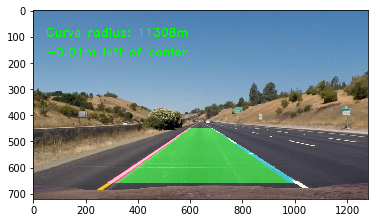

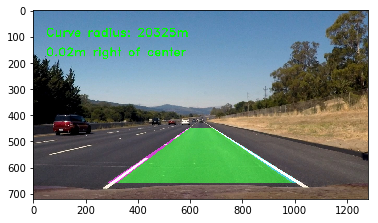

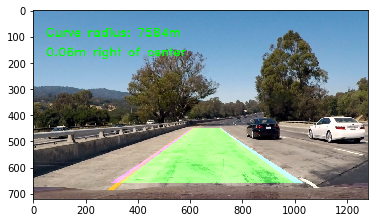

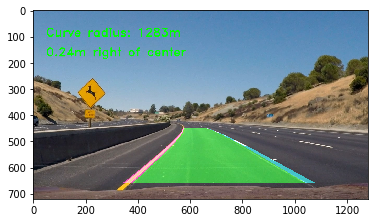

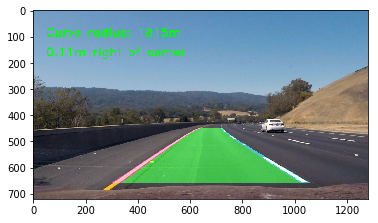

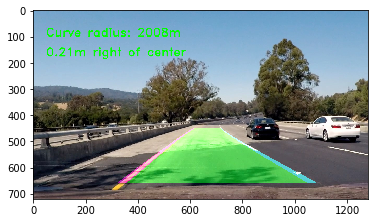

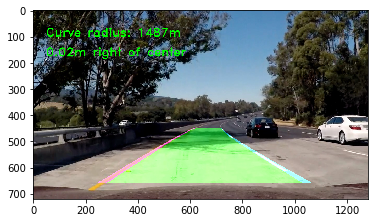

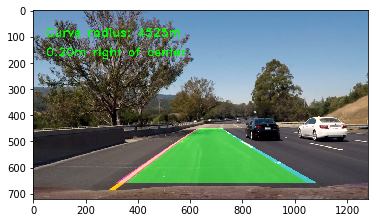

In [318]:

images = glob.glob('./test_images/*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    img = mpimg.imread(fname)
    img_og = np.copy(img)
    
    # warp the image based on our perspective transform
    warped = warper(undist)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    # Run the warped, binary image from the pipeline through the fitter
    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(binary_warped)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    y_eval = binary_warped.shape[0]
    midx = binary_warped.shape[1] / 2
    
    # calc the radius and center distance
    left_curverad, right_curverad = calc_radius(y_eval, left_fit_m, right_fit_m)
    center = calc_center_dist(y_eval, midx, left_fit, right_fit)

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=20)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=20)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = unwarp(color_warp)
    # Combine the result with the original image
    result = cv2.addWeighted(img_og, 1, newwarp, 0.5, 0)
    
    curve_rad = (left_curverad + right_curverad) / 2.
    
    # Add the radius and center
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Curve radius: ' + '{:04.0f}'.format(curve_rad) + 'm'
    cv2.putText(result, text, (50,100), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)
    if center < 0:
        dir = 'left'
    else:
        dir = 'right'
    text = '{:03.2f}'.format(center) + 'm '+ dir + ' of center'
    cv2.putText(result, text, (50,175), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)

    plt.figure()
    plt.imshow(result)
#     name = fname.split('/')[-1][:-4]
#     plt.imsave('./output_images/' + name + '-output.jpg', result)
    

## Almost Final Image Pipeline

In [319]:

def final_pipeline(img):

    img_og = np.copy(img)
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)
    
    # warp the image based on our perspective transform
    warped = warper(undist)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    # Run the warped, binary image from the pipeline through the fitter
    left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(binary_warped)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    y_eval = binary_warped.shape[0]
    midx = binary_warped.shape[1] / 2
    
    # calc the radius and center distance
    left_curverad, right_curverad = calc_radius(y_eval, left_fit_m, right_fit_m)
    center = calc_center_dist(y_eval, midx, left_fit, right_fit)

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=20)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=20)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = unwarp(color_warp) 
    # Combine the result with the original image
    result = cv2.addWeighted(img_og, 1, newwarp, 0.5, 0)
    
    curve_rad = (left_curverad + right_curverad) / 2.
    
    # Add the radius and center
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Curve radius: ' + '{:04.0f}'.format(curve_rad) + 'm'
    cv2.putText(result, text, (50,100), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)
    if center < 0:
        dir = 'left'
    else:
        dir = 'right'
    text = '{:03.2f}'.format(abs(center)) + 'm '+ dir + ' of center'
    cv2.putText(result, text, (50,175), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)

    return result

## Line Class

Before we move forward, I'm going to create a line class to keep track of the current and past line data.

In [348]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        
        # was the line detected in the last iteration?
        self.detected = False  
        
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        
        # polynomial coefficients averaged over the last n iterations
        self.best_fit_px = None
        self.best_fit_m = None
        
        #polynomial coefficients for the most recent fit
        self.current_fit_px = None  
        self.current_fit_m = None
        
        #radius of curvature of the line in some units
        self.radius_of_curvature = None
        
        # center position of car
        self.lane_to_camera = None
        
        # Previous Fits
        self.previous_fits_px = []
        self.previous_fits_m = []
        
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float')
        
        # meters per pixel in y dimension
        self.ym_per_pix = 30/720
        
        # y_eval is where we want to evaluate the fits for the line radius calcuation 
        # for us it's at the bottom of the image for us, and because we know 
        # the size of our video/images we can just hardcode it
        self.y_eval = 720. * self.ym_per_pix
        
        # camera position is where the camera is located relative to the image
        # we're assuming it's in the middle
        self.camera_position = 640.

    def run_line_pipe(self):
        self.calc_best_fit()
        self.calc_radius()
        self.calc_center_dist()
        
    def add_new_fit(self, new_fit_px, new_fit_m):
        """
        Add a new fit to the Line class
        """
        
        if new_fit_px != None and new_fit_m != None:
            # If this is our first line, then we will have to take it
            if self.current_fit_px == None and self.previous_fits_px == []:
                self.detected = True
                self.current_fit_px = new_fit_px
                self.current_fit_m = new_fit_m
                self.run_line_pipe()
                return
            else:
                # measure the diff to the old fit
                self.diffs = np.abs(new_fit_px - self.current_fit_px)
                # check the size of the diff
                if self.diff_check():
                    print("Found a fit diff that was too big")
                    print(self.diffs)
                    self.defected = False
                    return
                self.detected = True
                self.current_fit_px = new_fit_px
                self.current_fit_m = new_fit_m
                self.run_line_pipe()
                return
        else:
            self.detected = False
            return

            
    def diff_check(self):
        if self.diffs[0] > 0.001:
            return True
        if self.diffs[1] > 0.25:
            return True
        if self.diffs[2] > 1000.:
            return True
        return False

    def calc_best_fit(self):
        """
        calculate the average, if needed
        """
        # add the latest fit to the previous fit list
        self.previous_fits_px.append(self.current_fit_px)
        self.previous_fits_m.append(self.current_fit_m)
        
        # If we currently have 5 fits, throw the oldest out
        if len(self.previous_fits_px) > 5:
            self.previous_fits_px = self.previous_fits_px[1:]
        if len(self.previous_fits_m) > 5:
            self.previous_fits_m = self.previous_fits_m[1:]
        
        # Just average everything
        self.best_fit_px = np.average(self.previous_fits_px, axis=0)
        self.best_fit_m = np.average(self.previous_fits_m, axis=0)
        return
        
        
    def calc_radius(self):
        """
        left_fit and right_fit are assumed to have already been converted to meters
        """
        y_eval = self.y_eval
        fit = self.best_fit_m

        curve_rad = ((1 + (2*fit[0]*y_eval + fit[1])**2)**1.5) / np.absolute(2*fit[0])
        self.radius_of_curvature = curve_rad
        return
        
    def calc_center_dist(self):
        """
        calculate the distance of this line to the center of the image (where the camera is)
        """
        # meters per pixel in x dimension
        xm_per_pix = 3.7/550
        y = 700. # calculate the x's at the bottom of the image
        
        x0 = self.best_fit_px[0]*(y**2) + self.best_fit_px[1]*y + self.best_fit_px[2]
#         print("x0: ", x0)
        lane_to_camera_px = abs(self.camera_position - x0)
#         print('lane to camera px: ', lane_to_camera_px)
        self.lane_to_camera = lane_to_camera_px * xm_per_pix
#         print('lane to camera m: ', self.lane_to_camera)
        return
        
        

In [349]:
def get_center_dist(leftLine, rightLine):
    
    x_left = leftLine.lane_to_camera
    x_right = rightLine.lane_to_camera
    
    return x_right - x_left

def get_center_dist_2(leftLine, rightLine):
    
    # 10th value for x 
    # lane_middle = int((pts_right[10][0] - pts_left[10][0])/2.)+pts_left[10][0]
    
    # instead of the above, I'm going to grab the x and y fits at px 700
    # because I don't really know what pts_right/left are.
    y = 700.
    leftPos = leftLine.best_fit_px[0]*(y**2) + leftLine.best_fit_px[1]*y + leftLine.best_fit_px[2]
    rightPos = rightLine.best_fit_px[0]*(y**2) + rightLine.best_fit_px[1]*y + rightLine.best_fit_px[2]
    lane_middle = int((rightPos - leftPos)/2.)+leftPos
    
    
    if (lane_middle-640 > 0):
            leng = 3.66/2
            mag = ((lane_middle-640)/640.*leng)
            head = "Right"
    else:
            leng = 3.66/2.
            mag = ((lane_middle-640)/640.*leng)*-1
            head = "Left"
            
    return head, mag

def combine_radii(leftLine, rightLine):
    
    left = leftLine.radius_of_curvature
    right = rightLine.radius_of_curvature
    
    return np.average([left, right])


In [350]:
def create_final_image(img, binary_warped, leftLine, rightLine):
    
    left_fit = leftLine.best_fit_px
    right_fit = rightLine.best_fit_px
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=20)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=20)
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = unwarp(color_warp)
    
    # Combine the result with the original image
    result = cv2.addWeighted(img, 1, newwarp, 0.5, 0)
    
    return result

def add_image_text(img, radius, head, center):
    
    # Add the radius and center position to the image
    font = cv2.FONT_HERSHEY_DUPLEX
    
    text = 'Radius of curvature: ' + '{:04.0f}'.format(radius) + 'm'
    cv2.putText(img, text, (50,100), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)
    
#     if center > 0:
#         dir = 'left'
#     else:
#         dir = 'right'
    text = '{:03.2f}'.format(abs(center)) + 'm '+ head + ' of center'
    cv2.putText(img, text, (50,175), font, 1.5, (0,255, 0), 2, cv2.LINE_AA)
    
    return img
    

## The Final, Final Pipeline


Now lets recreate the final pipeline function to use these Line classes to track the lane lines

In [351]:
def final_pipeline(img):

    diagnostic_output = True
    
    img_og = np.copy(img)
    
    # Undistort the image based on the camera calibration
    undist = undistort(img, mtx, dist)
    
    # warp the image based on our perspective transform
    warped = warper(undist)
    
    # Run this through our binary pipeline
    binary_warped = binaryPipe(img)
    
    # If we found lines previously, run the simplified line fitter
    if leftLine.detected == True and rightLine.detected == True:
        left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits_from_prev(binary_warped, leftLine, rightLine)
    else:
        # Run the warped, binary image from the pipeline through the complex fitter
        left_fit, right_fit, left_fit_m, right_fit_m, out_img = calc_line_fits(binary_warped)
    
    
    # Add these fits to the line classes
    leftLine.add_new_fit(left_fit, left_fit_m)
    rightLine.add_new_fit(right_fit, left_fit_m)
    
    # get radius and center distance
    curve_rad = combine_radii(leftLine, rightLine)
    head, center = get_center_dist_2(leftLine, rightLine)

    # create the final image
    result = create_final_image(img, binary_warped, leftLine, rightLine)
    
    # add the text to the image 
    result = add_image_text(result, curve_rad, head, center)
    
    return result

Run the pipeline on the test images

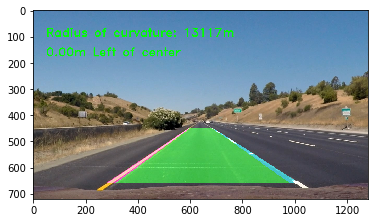

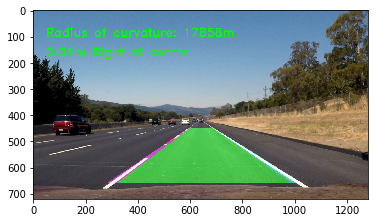

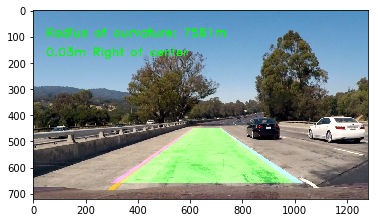

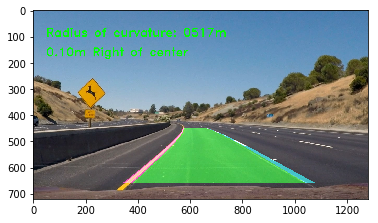

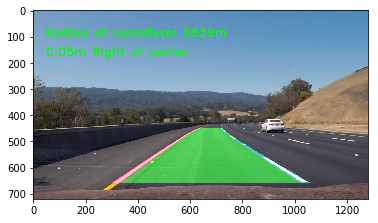

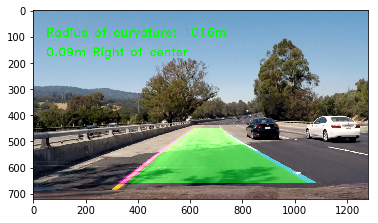

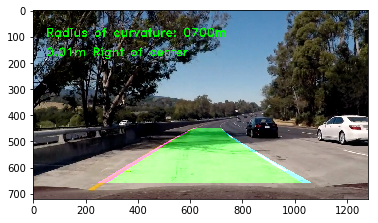

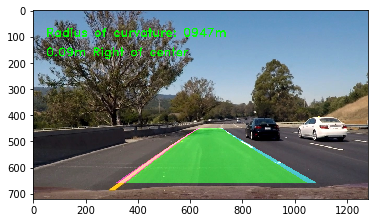

In [355]:
images = glob.glob('./test_images/*.jpg')

### Loop through each image and send it to the pipeline
for fname in images:
    
    # Initialize two lines for left and right on every image since the images don't
    # come from a continous video
    rightLine = Line()
    leftLine = Line()
    
    # Read the image
    img = mpimg.imread(fname)
    
    # Run the image through the pipeline
    result = final_pipeline(img)

    # Let's plot the image
    plt.figure()
    plt.imshow(result)
#     name = fname.split('/')[-1][:-4]
#     plt.imsave('./output_images/' + name + '-output.jpg', result)

## Video!

In [353]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [354]:
leftLine = Line()
rightLine = Line()

output = 'output_video/project_video_output.mp4'
clip1 = VideoFileClip("test_videos/project_video.mp4")
clip = clip1.fl_image(final_pipeline)
%time clip.write_videofile(output, audio=False)
    

[MoviePy] >>>> Building video output_video/project_video_output.mp4
[MoviePy] Writing video output_video/project_video_output.mp4


 45%|████▍     | 565/1261 [01:35<01:54,  6.10it/s]

Found a fit diff that was too big
[  2.38171458e-04   3.16771087e-01   1.09420365e+02]


 45%|████▌     | 568/1261 [01:36<01:51,  6.24it/s]

Found a fit diff that was too big
[  2.61346470e-04   3.15066101e-01   9.57183438e+01]


 45%|████▌     | 572/1261 [01:36<01:49,  6.29it/s]

Found a fit diff that was too big
[  2.63897805e-04   3.13272737e-01   8.96046979e+01]


 46%|████▌     | 579/1261 [01:37<01:47,  6.37it/s]

Found a fit diff that was too big
[  2.33559884e-04   2.64852075e-01   7.20763743e+01]


 46%|████▌     | 582/1261 [01:38<01:47,  6.33it/s]

Found a fit diff that was too big
[  3.40543552e-04   4.44334972e-01   1.43917276e+02]
Found a fit diff that was too big
[  6.57210170e-04   8.29687824e-01   2.62202105e+02]


 46%|████▋     | 584/1261 [01:38<01:47,  6.31it/s]

Found a fit diff that was too big
[  1.97317498e-03   2.47376304e+00   7.74339417e+02]
Found a fit diff that was too big
[  2.27953268e-03   2.89190819e+00   9.13389200e+02]


 46%|████▋     | 586/1261 [01:38<01:45,  6.37it/s]

Found a fit diff that was too big
[  1.43853681e-03   1.85321842e+00   5.95736720e+02]


 47%|████▋     | 588/1261 [01:39<01:46,  6.35it/s]

Found a fit diff that was too big
[  2.46190689e-04   3.25236427e-01   1.09314136e+02]


 78%|███████▊  | 978/1261 [02:44<00:47,  5.99it/s]

Found a fit diff that was too big
[  1.10121217e-03   8.88129105e-01   1.63826977e+02]


 80%|████████  | 1009/1261 [02:49<00:41,  6.02it/s]

Found a fit diff that was too big
[  3.02582069e-04   3.32785609e-01   8.44255455e+01]


 80%|████████  | 1013/1261 [02:50<00:40,  6.08it/s]

Found a fit diff that was too big
[  3.86515960e-04   5.05164018e-01   1.70535384e+02]
Found a fit diff that was too big
[  3.15922726e-04   4.24004141e-01   1.50524417e+02]


 80%|████████  | 1015/1261 [02:50<00:39,  6.17it/s]

Found a fit diff that was too big
[  1.76193823e-04   2.55300591e-01   9.94604766e+01]


100%|█████████▉| 1260/1261 [03:31<00:00,  5.77it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_video/project_video_output.mp4 

CPU times: user 4min 19s, sys: 41.6 s, total: 5min
Wall time: 3min 32s


In [300]:
output = 'output_video/challenge_video_output.mp4'
clip1 = VideoFileClip("test_videos/challenge_video.mp4")
clip = clip1.fl_image(final_pipeline)
%time clip.write_videofile(output, audio=False)

Found a fit diff that was too big
[  2.69855559e-03   3.07692462e+00   8.25189960e+02]
x0:  874.819252576
lane to camera px:  234.819252576
lane to camera m:  1.57969315369
[MoviePy] >>>> Building video output_video/challenge_video_output.mp4
[MoviePy] Writing video output_video/challenge_video_output.mp4


  0%|          | 0/485 [00:00<?, ?it/s]

Found a fit diff that was too big
[  2.69855559e-03   3.07692462e+00   8.25189960e+02]
x0:  867.504432195
lane to camera px:  227.504432195
lane to camera m:  1.53048436204


  0%|          | 2/485 [00:00<01:20,  5.97it/s]

Found a fit diff that was too big
[  2.81449643e-03   3.28686831e+00   9.13301385e+02]
Found a fit diff that was too big
[  6.55335369e-04   7.18433694e-01   1.88657252e+02]


  1%|          | 3/485 [00:00<01:19,  6.06it/s]

Found a fit diff that was too big
[  2.85042776e-03   3.35228277e+00   9.40066760e+02]
Found a fit diff that was too big
[  4.78701651e-04   5.20912160e-01   1.34638386e+02]
Found a fit diff that was too big
[  3.28846089e-03   3.90998972e+00   1.11738699e+03]
Found a fit diff that was too big
[  4.50344309e-04   4.96136816e-01   1.31466399e+02]


  1%|          | 5/485 [00:00<01:22,  5.83it/s]

Found a fit diff that was too big
[  3.25267907e-03   3.92832747e+00   1.14499134e+03]
Found a fit diff that was too big
[  3.84346821e-04   4.22299679e-01   1.10343170e+02]


  1%|          | 6/485 [00:01<01:20,  5.92it/s]

Found a fit diff that was too big
[  7.93594225e-04   8.35505656e-01   1.76846849e+02]
Found a fit diff that was too big
[  2.57703232e-04   2.92714492e-01   8.03023322e+01]


  1%|▏         | 7/485 [00:01<01:19,  6.02it/s]

Found a fit diff that was too big
[  9.33848999e-04   1.03896401e+00   2.49264519e+02]
Found a fit diff that was too big
[  3.84613547e-04   4.31549887e-01   1.16874354e+02]


  2%|▏         | 8/485 [00:01<01:18,  6.07it/s]

Found a fit diff that was too big
[  9.99179671e-04   1.07856237e+00   2.47037302e+02]
Found a fit diff that was too big
[  2.46695896e-04   2.74365584e-01   7.40427910e+01]


  2%|▏         | 9/485 [00:01<01:18,  6.08it/s]

Found a fit diff that was too big
[  4.23565281e-04   4.16560613e-01   6.08099542e+01]
Found a fit diff that was too big
[  2.42502853e-04   2.63714627e-01   6.99467787e+01]


  2%|▏         | 10/485 [00:01<01:17,  6.10it/s]

x0:  486.126251355
lane to camera px:  153.873748645
lane to camera m:  1.0351506727
Found a fit diff that was too big
[  2.40384489e-04   2.61783183e-01   7.02123755e+01]


  2%|▏         | 11/485 [00:01<01:16,  6.17it/s]

Found a fit diff that was too big
[  5.00647919e-04   5.60183397e-01   1.50419702e+02]
Found a fit diff that was too big
[  3.99719454e-04   4.43795793e-01   1.22442790e+02]


  2%|▏         | 12/485 [00:01<01:15,  6.23it/s]

x0:  489.976599928
lane to camera px:  150.023400072
lane to camera m:  1.00924832776
x0:  861.957979471
lane to camera px:  221.957979471
lane to camera m:  1.49317186189


  3%|▎         | 13/485 [00:02<01:15,  6.25it/s]

x0:  492.534820463
lane to camera px:  147.465179537
lane to camera m:  0.992038480523
Found a fit diff that was too big
[  2.44246850e-04   2.57997684e-01   6.60142677e+01]


  3%|▎         | 14/485 [00:02<01:14,  6.29it/s]

x0:  494.805087352
lane to camera px:  145.194912648
lane to camera m:  0.976765775996
x0:  855.035072935
lane to camera px:  215.035072935
lane to camera m:  1.44659958156


  3%|▎         | 15/485 [00:02<01:14,  6.27it/s]

x0:  497.80593871
lane to camera px:  142.19406129
lane to camera m:  0.9565782305
x0:  847.096179715
lane to camera px:  207.096179715
lane to camera m:  1.39319248172


  3%|▎         | 16/485 [00:02<01:14,  6.30it/s]

x0:  495.19573606
lane to camera px:  144.80426394
lane to camera m:  0.974137775598
x0:  849.663789821
lane to camera px:  209.663789821
lane to camera m:  1.41046549516
x0:  493.908126711
lane to camera px:  146.091873289
lane to camera m:  0.982799874855
Found a fit diff that was too big
[  2.89338801e-04   3.37000458e-01   9.56701210e+01]


  4%|▍         | 19/485 [00:03<01:23,  5.56it/s]

Found a fit diff that was too big
[  1.76480782e-04   2.56187511e-01   9.42868637e+01]
Found a fit diff that was too big
[  4.28921406e-04   5.35061601e-01   1.65802240e+02]
Found a fit diff that was too big
[  9.26758037e-04   1.21417659e+00   3.97590516e+02]
Found a fit diff that was too big
[  4.63616371e-04   5.78515099e-01   1.78469826e+02]


  4%|▍         | 21/485 [00:03<01:19,  5.84it/s]

Found a fit diff that was too big
[  3.82659448e-04   4.49577358e-01   1.28977050e+02]
Found a fit diff that was too big
[  3.21426660e-04   3.09926906e-01   6.86690688e+01]
x0:  494.125403486
lane to camera px:  145.874596514
lane to camera m:  0.981338194728
x0:  852.231706122
lane to camera px:  212.231706122
lane to camera m:  1.42774056845


  5%|▍         | 23/485 [00:03<01:16,  6.02it/s]

x0:  495.315882209
lane to camera px:  144.684117791
lane to camera m:  0.973329519686
x0:  853.414175596
lane to camera px:  213.414175596
lane to camera m:  1.4356953631
Found a fit diff that was too big
[  3.59468155e-04   4.09997055e-01   1.13326854e+02]
Found a fit diff that was too big
[  3.81234006e-04   3.62158294e-01   7.87859903e+01]


  5%|▌         | 25/485 [00:04<01:14,  6.16it/s]

Found a fit diff that was too big
[  9.83547302e-04   1.31926923e+00   4.42609663e+02]
x0:  855.253981096
lane to camera px:  215.253981096
lane to camera m:  1.44807223647
x0:  496.108831755
lane to camera px:  143.891168245
lane to camera m:  0.967995131832
x0:  857.25663744
lane to camera px:  217.25663744
lane to camera m:  1.46154465187


  6%|▌         | 27/485 [00:04<01:12,  6.29it/s]

Found a fit diff that was too big
[  2.83139837e-04   3.11211057e-01   8.18356375e+01]
x0:  858.563882166
lane to camera px:  218.563882166
lane to camera m:  1.47033884366
Found a fit diff that was too big
[  3.01038940e-04   3.18267919e-01   7.86236028e+01]
x0:  859.875487925
lane to camera px:  219.875487925
lane to camera m:  1.47916237331


  6%|▌         | 29/485 [00:04<01:11,  6.34it/s]

Found a fit diff that was too big
[  3.01288967e-04   2.69173006e-01   4.27918938e+01]
x0:  860.560243175
lane to camera px:  220.560243175
lane to camera m:  1.48376890863
Found a fit diff that was too big
[  3.67013811e-04   4.84571053e-01   1.63598541e+02]
x0:  859.558464994
lane to camera px:  219.558464994
lane to camera m:  1.47702967359


  6%|▋         | 31/485 [00:05<01:11,  6.38it/s]

Found a fit diff that was too big
[  1.01999532e-03   1.34379398e+00   4.49288807e+02]
x0:  858.11433139
lane to camera px:  218.11433139
lane to camera m:  1.46731459299
Found a fit diff that was too big
[  6.26268929e-04   7.82690955e-01   2.35699741e+02]
Found a fit diff that was too big
[  2.86374414e-04   3.08984045e-01   8.11005922e+01]


  7%|▋         | 33/485 [00:05<01:10,  6.37it/s]

Found a fit diff that was too big
[  1.18750847e-03   1.57975439e+00   5.30707751e+02]
x0:  858.82038327
lane to camera px:  218.82038327
lane to camera m:  1.47206439654
x0:  498.787990405
lane to camera px:  141.212009595
lane to camera m:  0.949971700913
x0:  859.705948557
lane to camera px:  219.705948557
lane to camera m:  1.47802183575


  7%|▋         | 35/485 [00:05<01:11,  6.33it/s]

x0:  501.488833983
lane to camera px:  138.511166017
lane to camera m:  0.931802389568
Found a fit diff that was too big
[  3.06374044e-04   2.78896049e-01   5.40636120e+01]
Found a fit diff that was too big
[  4.36702073e-04   4.45485087e-01   9.79846369e+01]
Found a fit diff that was too big
[  3.80672904e-04   3.93844078e-01   1.03291244e+02]


  8%|▊         | 37/485 [00:06<01:11,  6.29it/s]

Found a fit diff that was too big
[  4.32266624e-04   4.79004659e-01   1.23470112e+02]
Found a fit diff that was too big
[  3.99479331e-04   4.18838295e-01   1.08710050e+02]
Found a fit diff that was too big
[  2.35636032e-04   3.20380267e-01   1.06190161e+02]
Found a fit diff that was too big
[  5.25618463e-04   5.49544387e-01   1.36658109e+02]


  8%|▊         | 39/485 [00:06<01:10,  6.32it/s]

x0:  503.385835545
lane to camera px:  136.614164455
lane to camera m:  0.919040742694
Found a fit diff that was too big
[  4.11133150e-04   4.36401431e-01   1.09495801e+02]
Found a fit diff that was too big
[  1.12242055e-03   1.52696448e+00   5.18967828e+02]
Found a fit diff that was too big
[  4.28389727e-04   4.53539046e-01   1.14362811e+02]


  8%|▊         | 41/485 [00:06<01:10,  6.32it/s]

Found a fit diff that was too big
[  3.52118084e-04   2.98276993e-01   3.95385638e+01]
Found a fit diff that was too big
[  3.38157137e-04   4.07006909e-01   1.24808529e+02]
Found a fit diff that was too big
[  4.53709467e-04   3.98761486e-01   6.04976026e+01]
Found a fit diff that was too big
[  3.02717031e-04   3.61953349e-01   1.12378956e+02]


  9%|▉         | 43/485 [00:06<01:09,  6.33it/s]

x0:  504.943086154
lane to camera px:  135.056913846
lane to camera m:  0.908564693143
Found a fit diff that was too big
[  3.38939945e-04   3.79332955e-01   1.08218708e+02]
Found a fit diff that was too big
[  5.37932198e-04   5.75016060e-01   1.38207361e+02]
Found a fit diff that was too big
[  4.04426934e-04   4.25335781e-01   1.05734671e+02]


  9%|▉         | 45/485 [00:07<01:10,  6.26it/s]

Found a fit diff that was too big
[  8.80998317e-04   9.88847546e-01   2.61178006e+02]
x0:  862.016980198
lane to camera px:  222.016980198
lane to camera m:  1.49356877588
Found a fit diff that was too big
[  1.19647352e-03   1.31133978e+00   3.26388800e+02]
x0:  863.230248005
lane to camera px:  223.230248005
lane to camera m:  1.50173075931


 10%|▉         | 47/485 [00:07<01:09,  6.30it/s]

Found a fit diff that was too big
[  1.42518031e-03   1.59749794e+00   4.16380575e+02]
x0:  866.430861446
lane to camera px:  226.430861446
lane to camera m:  1.52326215882
Found a fit diff that was too big
[  1.31894839e-03   1.44168025e+00   3.57752983e+02]
x0:  870.150254885
lane to camera px:  230.150254885
lane to camera m:  1.54828353286


 10%|█         | 49/485 [00:07<01:10,  6.23it/s]

Found a fit diff that was too big
[  1.57941780e-03   1.71115222e+00   4.14123478e+02]
x0:  875.635015364
lane to camera px:  235.635015364
lane to camera m:  1.58518101245
Found a fit diff that was too big
[  3.02720898e-04   2.93002862e-01   7.05198075e+01]
x0:  881.794141869
lane to camera px:  241.794141869
lane to camera m:  1.62661513621


 11%|█         | 51/485 [00:08<01:08,  6.30it/s]

Found a fit diff that was too big
[  9.52419717e-04   1.01905828e+00   2.36527619e+02]
x0:  889.350211698
lane to camera px:  249.350211698
lane to camera m:  1.67744687869
Found a fit diff that was too big
[  5.31472812e-04   6.08804058e-01   1.43698134e+02]
x0:  894.154861036
lane to camera px:  254.154861036
lane to camera m:  1.70976906515


 11%|█         | 53/485 [00:08<01:08,  6.35it/s]

Found a fit diff that was too big
[  3.46600597e-03   4.14854591e+00   1.18481615e+03]
x0:  896.905990334
lane to camera px:  256.905990334
lane to camera m:  1.72827666225
Found a fit diff that was too big
[  2.51847583e-04   2.96844742e-01   6.92361984e+01]
Found a fit diff that was too big
[  4.31722189e-04   3.21221709e-01   1.05197934e+01]


 11%|█▏        | 55/485 [00:08<01:08,  6.26it/s]

Found a fit diff that was too big
[  4.20464897e-04   3.78183937e-01   8.51899551e+01]
Found a fit diff that was too big
[  4.92665483e-04   3.93833184e-01   2.88595944e+01]
Found a fit diff that was too big
[  7.62741324e-04   7.07755563e-01   1.53565935e+02]
Found a fit diff that was too big
[  5.52901730e-04   4.49386579e-01   3.64934601e+01]


 12%|█▏        | 57/485 [00:09<01:07,  6.34it/s]

Found a fit diff that was too big
[  4.97671480e-04   4.21480622e-01   9.12753609e+01]
Found a fit diff that was too big
[  5.45126374e-04   4.41922620e-01   3.98324601e+01]
Found a fit diff that was too big
[  6.08976764e-04   5.43751229e-01   1.26433375e+02]
Found a fit diff that was too big
[  5.08813853e-04   4.07013961e-01   3.60673329e+01]


 12%|█▏        | 59/485 [00:09<01:06,  6.40it/s]

x0:  516.803822882
lane to camera px:  123.196177118
lane to camera m:  0.82877428243
Found a fit diff that was too big
[  4.56708678e-04   3.41983622e-01   1.69648101e+01]
Found a fit diff that was too big
[  4.36165108e-04   4.51898766e-01   1.05405532e+02]
Found a fit diff that was too big
[  5.38817645e-04   4.33455156e-01   3.66147101e+01]


 13%|█▎        | 61/485 [00:09<01:06,  6.39it/s]

Found a fit diff that was too big
[  2.21367757e-04   2.54154904e-01   6.39849225e+01]
Found a fit diff that was too big
[  3.95956383e-04   3.25416608e-01   1.96497346e+01]
Found a fit diff that was too big
[  3.40530570e-04   4.07529419e-01   1.25964906e+02]
x0:  901.545782272
lane to camera px:  261.545782272
lane to camera m:  1.75948980801


 13%|█▎        | 63/485 [00:10<01:05,  6.43it/s]

Found a fit diff that was too big
[  2.95771101e-04   3.25188925e-01   8.90461896e+01]
x0:  907.727345291
lane to camera px:  267.727345291
lane to camera m:  1.80107486832
Found a fit diff that was too big
[  5.51699300e-04   5.81134352e-01   1.25103461e+02]
x0:  913.612249109
lane to camera px:  273.612249109
lane to camera m:  1.84066422128


 13%|█▎        | 65/485 [00:10<01:05,  6.41it/s]

Found a fit diff that was too big
[  3.99040473e-04   4.56440897e-01   1.12151025e+02]
x0:  922.867864554
lane to camera px:  282.867864554
lane to camera m:  1.90292927064
Found a fit diff that was too big
[  4.29027036e-04   4.07974803e-01   9.01678248e+01]
x0:  931.781465889
lane to camera px:  291.781465889
lane to camera m:  1.9628934978


 14%|█▍        | 67/485 [00:10<01:05,  6.40it/s]

Found a fit diff that was too big
[  1.15218765e-03   1.14837932e+00   2.60221637e+02]
x0:  936.160956768
lane to camera px:  296.160956768
lane to camera m:  1.99235552735
x0:  533.447100091
lane to camera px:  106.552899909
lane to camera m:  0.716810417567
x0:  938.429133643
lane to camera px:  298.429133643
lane to camera m:  2.00761417178


 14%|█▍        | 69/485 [00:11<01:04,  6.43it/s]

Found a fit diff that was too big
[  1.10339088e-03   1.27716037e+00   3.47005722e+02]
x0:  940.980712303
lane to camera px:  300.980712303
lane to camera m:  2.02477933731
Found a fit diff that was too big
[  8.97518522e-04   1.11433778e+00   3.27875688e+02]
x0:  943.494587793
lane to camera px:  303.494587793
lane to camera m:  2.04169086333


 15%|█▍        | 71/485 [00:11<01:04,  6.42it/s]

Found a fit diff that was too big
[  1.68785975e-03   1.84963714e+00   4.81193486e+02]
x0:  949.291961263
lane to camera px:  309.291961263
lane to camera m:  2.08069137577
Found a fit diff that was too big
[  2.16557871e-03   2.33360364e+00   5.89149773e+02]
x0:  956.468363443
lane to camera px:  316.468363443
lane to camera m:  2.12896899044


 15%|█▌        | 73/485 [00:11<01:04,  6.34it/s]

Found a fit diff that was too big
[  1.92648549e-03   2.05389370e+00   5.11995957e+02]
x0:  963.942662759
lane to camera px:  323.942662759
lane to camera m:  2.17925064038
Found a fit diff that was too big
[  2.03877239e-03   2.15829360e+00   5.38021805e+02]
x0:  971.883326238
lane to camera px:  331.883326238
lane to camera m:  2.23266964924


 15%|█▌        | 75/485 [00:12<01:04,  6.40it/s]

Found a fit diff that was too big
[  1.57552882e-03   1.67736106e+00   4.22987828e+02]
x0:  978.561151233
lane to camera px:  338.561151233
lane to camera m:  2.2775931992
Found a fit diff that was too big
[  1.89311338e-03   1.99949986e+00   4.90045545e+02]
x0:  982.341067956
lane to camera px:  342.341067956
lane to camera m:  2.30302172989


 16%|█▌        | 77/485 [00:12<01:03,  6.46it/s]

Found a fit diff that was too big
[  2.12805034e-03   2.23036798e+00   5.31951396e+02]
x0:  985.662788136
lane to camera px:  345.662788136
lane to camera m:  2.32536784746
Found a fit diff that was too big
[  2.81938083e-03   2.86980572e+00   6.67788806e+02]
x0:  988.005843544
lane to camera px:  348.005843544
lane to camera m:  2.34113022021


 16%|█▋        | 79/485 [00:12<01:03,  6.41it/s]

Found a fit diff that was too big
[  2.37207740e-03   2.51590849e+00   6.08352050e+02]
x0:  989.12177991
lane to camera px:  349.12177991
lane to camera m:  2.34863742849
Found a fit diff that was too big
[  2.05652202e-03   2.27989162e+00   5.72023864e+02]
x0:  990.176682399
lane to camera px:  350.176682399
lane to camera m:  2.35573404523


 17%|█▋        | 81/485 [00:12<01:03,  6.38it/s]

Found a fit diff that was too big
[  2.32960025e-03   2.54153352e+00   6.29106424e+02]
x0:  991.085686716
lane to camera px:  351.085686716
lane to camera m:  2.36184916518
Found a fit diff that was too big
[  2.30691152e-03   2.55694541e+00   6.43176338e+02]
x0:  992.177121093
lane to camera px:  352.177121093
lane to camera m:  2.3691915419


 17%|█▋        | 83/485 [00:13<01:02,  6.44it/s]

Found a fit diff that was too big
[  1.95449038e-03   2.14440677e+00   5.29201402e+02]
x0:  994.260692998
lane to camera px:  354.260692998
lane to camera m:  2.38320829835
Found a fit diff that was too big
[  2.44138806e-03   2.53786938e+00   5.99194668e+02]
x0:  997.086452009
lane to camera px:  357.086452009
lane to camera m:  2.40221794988


 18%|█▊        | 85/485 [00:13<01:03,  6.30it/s]

Found a fit diff that was too big
[  1.99625377e-03   2.18042902e+00   5.30185149e+02]
x0:  998.223388553
lane to camera px:  358.223388553
lane to camera m:  2.40986643208
Found a fit diff that was too big
[  2.18262298e-03   2.36891739e+00   5.73377487e+02]
x0:  998.305780992
lane to camera px:  358.305780992
lane to camera m:  2.41042070849


 18%|█▊        | 87/485 [00:13<01:03,  6.24it/s]

Found a fit diff that was too big
[  1.99006035e-03   2.24436905e+00   5.56971226e+02]
x0:  997.72220819
lane to camera px:  357.72220819
lane to camera m:  2.4064948551
Found a fit diff that was too big
[  2.51542776e-03   2.84067969e+00   7.14672817e+02]
x0:  995.259291053
lane to camera px:  355.259291053
lane to camera m:  2.38992613981


 18%|█▊        | 89/485 [00:14<01:03,  6.28it/s]

Found a fit diff that was too big
[  1.61408384e-03   2.08486822e+00   5.68028821e+02]
x0:  991.729517316
lane to camera px:  351.729517316
lane to camera m:  2.36618038922
Found a fit diff that was too big
[  1.21019751e-03   1.73638067e+00   4.99367915e+02]
Found a fit diff that was too big
[  3.31920953e-04   3.08130072e-01   6.13895332e+01]


 19%|█▉        | 91/485 [00:14<01:03,  6.24it/s]

Found a fit diff that was too big
[  1.16570845e-03   1.65471831e+00   4.67708457e+02]
Found a fit diff that was too big
[  4.50061176e-04   3.96382853e-01   7.56128408e+01]
Found a fit diff that was too big
[  1.18351701e-03   1.69296749e+00   4.82162841e+02]
Found a fit diff that was too big
[  7.03531598e-04   6.46107967e-01   1.28372728e+02]


 19%|█▉        | 93/485 [00:14<01:03,  6.18it/s]

Found a fit diff that was too big
[  1.09700626e-03   1.60845202e+00   4.62176400e+02]
Found a fit diff that was too big
[  9.76366400e-04   9.27651533e-01   1.92774665e+02]
Found a fit diff that was too big
[  1.04907170e-03   1.56525939e+00   4.48847912e+02]
Found a fit diff that was too big
[  9.64892943e-04   9.18303656e-01   1.89158895e+02]


 20%|█▉        | 95/485 [00:15<01:02,  6.23it/s]

Found a fit diff that was too big
[  1.14956044e-03   1.64285402e+00   4.59614820e+02]
Found a fit diff that was too big
[  8.79265768e-04   8.32363612e-01   1.71584429e+02]
Found a fit diff that was too big
[  1.27106700e-03   1.78520869e+00   5.03731511e+02]
Found a fit diff that was too big
[  8.41262189e-04   8.18437579e-01   1.77000618e+02]


 20%|██        | 97/485 [00:15<01:02,  6.23it/s]

Found a fit diff that was too big
[  1.47252218e-03   2.04090832e+00   5.82248023e+02]
Found a fit diff that was too big
[  6.87470871e-04   6.62269740e-01   1.42192265e+02]
Found a fit diff that was too big
[  1.43387490e-03   2.02580704e+00   5.97552680e+02]
x0:  990.356365953
lane to camera px:  350.356365953
lane to camera m:  2.3569428255


 20%|██        | 99/485 [00:15<01:01,  6.27it/s]

Found a fit diff that was too big
[  1.40629975e-03   2.02963331e+00   6.09662956e+02]
x0:  989.951871012
lane to camera px:  349.951871012
lane to camera m:  2.35422167772
Found a fit diff that was too big
[  1.30339531e-03   1.96561283e+00   6.08652880e+02]
Found a fit diff that was too big
[  1.55843448e-03   1.69800589e+00   4.33056342e+02]


 21%|██        | 101/485 [00:16<01:00,  6.37it/s]

Found a fit diff that was too big
[  1.19167652e-03   1.82472696e+00   5.61935436e+02]
Found a fit diff that was too big
[  1.80109249e-03   1.91809758e+00   4.81973919e+02]
Found a fit diff that was too big
[  1.14247549e-03   1.75714232e+00   5.33094346e+02]
Found a fit diff that was too big
[  1.71123417e-03   1.81691346e+00   4.55500891e+02]


 21%|██        | 103/485 [00:16<00:59,  6.45it/s]

Found a fit diff that was too big
[  1.48707504e-03   2.10599794e+00   6.15749250e+02]
Found a fit diff that was too big
[  1.93066862e-03   2.01804793e+00   4.99369871e+02]
Found a fit diff that was too big
[  1.68275901e-03   2.28830308e+00   6.56281226e+02]
Found a fit diff that was too big
[  1.97084548e-03   2.09827292e+00   5.26162109e+02]


 22%|██▏       | 105/485 [00:16<00:58,  6.46it/s]

Found a fit diff that was too big
[  2.18934703e-03   2.76321085e+00   7.55735463e+02]
Found a fit diff that was too big
[  1.90190458e-03   2.02465961e+00   5.05809811e+02]
Found a fit diff that was too big
[  1.99733667e-03   2.50895909e+00   6.79973971e+02]
Found a fit diff that was too big
[  2.36119325e-03   2.52212330e+00   6.32162096e+02]


 22%|██▏       | 107/485 [00:17<00:58,  6.47it/s]

Found a fit diff that was too big
[  2.18186957e-03   2.68387532e+00   7.20587621e+02]
Found a fit diff that was too big
[  2.71254102e-03   2.94371143e+00   7.49659829e+02]
Found a fit diff that was too big
[  2.53463504e-03   3.11099780e+00   8.44626160e+02]
Found a fit diff that was too big
[  3.39490791e-03   3.73286304e+00   9.64924157e+02]


 22%|██▏       | 109/485 [00:17<00:58,  6.44it/s]

Found a fit diff that was too big
[  4.07579639e-04   7.52162711e-01   2.06099427e+02]
Found a fit diff that was too big
[  4.36002783e-03   4.83831082e+00   1.26983556e+03]
Found a fit diff that was too big
[  4.38145844e-04   7.65383852e-01   2.06575927e+02]
x0:  985.136245822
lane to camera px:  345.136245822
lane to camera m:  2.32182565371


 23%|██▎       | 111/485 [00:17<00:58,  6.38it/s]

Found a fit diff that was too big
[  5.77083520e-04   8.66819976e-01   2.12163516e+02]
Found a fit diff that was too big
[  2.63223715e-04   3.22066502e-01   9.76965932e+01]
Found a fit diff that was too big
[  5.83214711e-04   8.72351890e-01   2.14168006e+02]
x0:  987.033103547
lane to camera px:  347.033103547
lane to camera m:  2.33458633295


 23%|██▎       | 113/485 [00:18<00:58,  6.34it/s]

Found a fit diff that was too big
[  5.14844687e-04   7.99125026e-01   1.98703978e+02]
x0:  992.221241187
lane to camera px:  352.221241187
lane to camera m:  2.3694883498
Found a fit diff that was too big
[  5.58434110e-04   8.53177370e-01   2.13468989e+02]
Found a fit diff that was too big
[  4.35609848e-04   3.79107516e-01   7.13759455e+01]


 24%|██▎       | 115/485 [00:18<00:58,  6.37it/s]

Found a fit diff that was too big
[  5.97492799e-04   8.33628622e-01   1.89996845e+02]
Found a fit diff that was too big
[  3.22067151e-04   2.56714761e-01   4.11244368e+01]
Found a fit diff that was too big
[  6.20291670e-04   8.35492969e-01   1.82019832e+02]
Found a fit diff that was too big
[  4.13538634e-04   3.53538390e-01   5.99130693e+01]


 24%|██▍       | 117/485 [00:18<00:57,  6.35it/s]

Found a fit diff that was too big
[  6.50931228e-04   8.28365920e-01   1.64305144e+02]
x0:  998.687385623
lane to camera px:  358.687385623
lane to camera m:  2.41298786692
Found a fit diff that was too big
[  6.27130041e-04   8.36862286e-01   1.77694242e+02]
Found a fit diff that was too big
[  3.25090267e-04   3.21097614e-01   6.39681839e+01]


 25%|██▍       | 119/485 [00:18<00:57,  6.35it/s]

Found a fit diff that was too big
[  5.40264271e-04   7.75434633e-01   1.74419936e+02]
Found a fit diff that was too big
[  6.13399551e-04   5.93624976e-01   1.15537714e+02]
Found a fit diff that was too big
[  5.55505364e-04   8.20298704e-01   1.94212589e+02]
x0:  999.259260161
lane to camera px:  359.259260161
lane to camera m:  2.4168350229


 25%|██▍       | 121/485 [00:19<00:57,  6.30it/s]

Found a fit diff that was too big
[  5.25361024e-04   8.27265635e-01   2.05718233e+02]
x0:  1003.58982123
lane to camera px:  363.589821231
lane to camera m:  2.44596788828
Found a fit diff that was too big
[  4.47540346e-04   7.68088095e-01   1.98715715e+02]
Found a fit diff that was too big
[  6.47599475e-04   6.17158032e-01   1.21854126e+02]


 25%|██▌       | 123/485 [00:19<00:56,  6.39it/s]

Found a fit diff that was too big
[  4.62929590e-04   7.75232266e-01   2.00171072e+02]
x0:  995.940593865
lane to camera px:  355.940593865
lane to camera m:  2.39450944964
Found a fit diff that was too big
[  4.46598061e-04   7.70537337e-01   2.00937486e+02]
Found a fit diff that was too big
[  3.21382590e-04   3.33196633e-01   6.71192863e+01]


 26%|██▌       | 125/485 [00:19<00:55,  6.45it/s]

Found a fit diff that was too big
[  3.85570870e-04   7.18322782e-01   1.89905552e+02]
x0:  980.477036782
lane to camera px:  340.477036782
lane to camera m:  2.29048188381
Found a fit diff that was too big
[  4.00684932e-04   7.41480248e-01   1.99908782e+02]
x0:  959.79266966
lane to camera px:  319.79266966
lane to camera m:  2.15133250498


 26%|██▌       | 127/485 [00:20<00:56,  6.39it/s]

Found a fit diff that was too big
[  3.95206815e-04   7.14318535e-01   1.87462047e+02]
Found a fit diff that was too big
[  7.28264209e-04   6.25825796e-01   1.16593082e+02]
Found a fit diff that was too big
[  4.62396263e-04   7.67967843e-01   1.96155727e+02]
Found a fit diff that was too big
[  6.33918224e-04   5.79004708e-01   1.18573226e+02]


 27%|██▋       | 129/485 [00:20<00:55,  6.37it/s]

Found a fit diff that was too big
[  5.30752140e-04   8.14524380e-01   2.01303993e+02]
x0:  946.480912078
lane to camera px:  306.480912078
lane to camera m:  2.06178068125
Found a fit diff that was too big
[  5.80093546e-04   8.34253417e-01   1.98774084e+02]
x0:  932.956570782
lane to camera px:  292.956570782
lane to camera m:  1.9707987489


 27%|██▋       | 131/485 [00:20<00:55,  6.33it/s]

Found a fit diff that was too big
[  6.40508174e-04   8.57549360e-01   1.97516802e+02]
x0:  924.3840488
lane to camera px:  284.3840488
lane to camera m:  1.91312905556
Found a fit diff that was too big
[  6.50588249e-04   8.57265658e-01   1.98082881e+02]
x0:  929.713105163
lane to camera px:  289.713105163
lane to camera m:  1.94897907109


 27%|██▋       | 133/485 [00:21<00:55,  6.39it/s]

Found a fit diff that was too big
[  6.47027714e-04   8.77855621e-01   2.04830485e+02]
Found a fit diff that was too big
[  2.69837286e-04   3.12770869e-01   7.04745419e+01]
Found a fit diff that was too big
[  9.57996672e-04   1.03941353e+00   2.36785944e+02]
Found a fit diff that was too big
[  4.47785668e-04   3.48405771e-01   7.74926657e+01]


 28%|██▊       | 135/485 [00:21<00:54,  6.37it/s]

Found a fit diff that was too big
[  9.68710167e-04   1.04101011e+00   2.32309067e+02]
Found a fit diff that was too big
[  5.19809988e-04   4.06869694e-01   8.68036203e+01]
Found a fit diff that was too big
[  9.90625942e-04   1.08006426e+00   2.41650413e+02]
Found a fit diff that was too big
[  4.26191906e-04   3.24613818e-01   7.09549059e+01]


 28%|██▊       | 137/485 [00:21<00:54,  6.37it/s]

Found a fit diff that was too big
[  9.71686321e-04   1.08746035e+00   2.42301721e+02]
Found a fit diff that was too big
[  4.36182196e-04   3.38256964e-01   6.18043937e+01]
Found a fit diff that was too big
[  8.64266548e-04   1.02517883e+00   2.31874768e+02]
x0:  934.443777868
lane to camera px:  294.443777868
lane to camera m:  1.98080359656


 29%|██▊       | 139/485 [00:22<00:54,  6.38it/s]

Found a fit diff that was too big
[  8.15442879e-04   1.01224618e+00   2.33751280e+02]
x0:  937.22701093
lane to camera px:  297.22701093
lane to camera m:  1.99952716444
Found a fit diff that was too big
[  6.80057832e-04   9.27572319e-01   2.22736791e+02]
x0:  940.087328171
lane to camera px:  300.087328171
lane to camera m:  2.01876929861


 29%|██▉       | 141/485 [00:22<00:55,  6.25it/s]

Found a fit diff that was too big
[  6.95458364e-04   9.42556628e-01   2.28643670e+02]
x0:  942.287387252
lane to camera px:  302.287387252
lane to camera m:  2.03356969606
Found a fit diff that was too big
[  7.33497038e-04   9.70732765e-01   2.38098335e+02]
x0:  935.103006609
lane to camera px:  295.103006609
lane to camera m:  1.9852384081


 29%|██▉       | 143/485 [00:22<00:54,  6.25it/s]

Found a fit diff that was too big
[  7.90117105e-04   1.03888766e+00   2.56084390e+02]
Found a fit diff that was too big
[  5.46522889e-04   4.91277448e-01   9.61998326e+01]
Found a fit diff that was too big
[  8.35164772e-04   1.09589353e+00   2.76929024e+02]
Found a fit diff that was too big
[  2.99519045e-04   3.15072506e-01   7.24012889e+01]


 30%|██▉       | 145/485 [00:23<00:53,  6.34it/s]

Found a fit diff that was too big
[  6.71242035e-04   9.91553600e-01   2.55694992e+02]
Found a fit diff that was too big
[  5.60374959e-04   5.34019839e-01   9.19256106e+01]
Found a fit diff that was too big
[  6.44756674e-04   9.72833120e-01   2.53697671e+02]
Found a fit diff that was too big
[  6.22336650e-04   5.72855642e-01   9.37679667e+01]


 30%|███       | 147/485 [00:23<00:52,  6.42it/s]

Found a fit diff that was too big
[  4.72752750e-04   8.04299057e-01   2.04201677e+02]
Found a fit diff that was too big
[  3.79743219e-04   3.45019863e-01   4.27943451e+01]
Found a fit diff that was too big
[  4.94002700e-04   8.06595042e-01   2.00302833e+02]
Found a fit diff that was too big
[  4.83928687e-04   4.41910220e-01   6.99661963e+01]


 31%|███       | 149/485 [00:23<00:52,  6.42it/s]

Found a fit diff that was too big
[  5.67261533e-04   8.46608974e-01   2.05132808e+02]
Found a fit diff that was too big
[  6.86940604e-04   6.09312961e-01   1.02270583e+02]
Found a fit diff that was too big
[  6.32416292e-04   8.91275148e-01   2.13754408e+02]
Found a fit diff that was too big
[  7.38429389e-04   6.41544019e-01   1.07202234e+02]


 31%|███       | 151/485 [00:23<00:52,  6.40it/s]

Found a fit diff that was too big
[  6.14127248e-04   8.68366634e-01   2.08584797e+02]
Found a fit diff that was too big
[  5.61441709e-04   4.72189253e-01   7.18880062e+01]
Found a fit diff that was too big
[  6.53288143e-04   9.40362490e-01   2.34724677e+02]
Found a fit diff that was too big
[  4.76938071e-04   3.92395035e-01   5.80956611e+01]


 32%|███▏      | 153/485 [00:24<00:52,  6.33it/s]

Found a fit diff that was too big
[  7.13383583e-04   9.97950115e-01   2.48623491e+02]
Found a fit diff that was too big
[  4.73081989e-04   3.64727079e-01   5.00653778e+01]
Found a fit diff that was too big
[  7.54598465e-04   1.04690916e+00   2.63974276e+02]
Found a fit diff that was too big
[  5.73657718e-04   4.08390100e-01   4.60566211e+01]


 32%|███▏      | 155/485 [00:24<00:52,  6.23it/s]

Found a fit diff that was too big
[  7.55190197e-04   1.02836279e+00   2.53619014e+02]
Found a fit diff that was too big
[  4.95331445e-04   3.61785347e-01   4.69183010e+01]
Found a fit diff that was too big
[  7.46815149e-04   1.00920371e+00   2.44258947e+02]
Found a fit diff that was too big
[  4.92923839e-04   3.27964523e-01   2.93916166e+01]


 32%|███▏      | 157/485 [00:24<00:52,  6.24it/s]

Found a fit diff that was too big
[  7.37446913e-04   1.00751828e+00   2.44998802e+02]
Found a fit diff that was too big
[  5.85970219e-04   4.28757738e-01   4.93197160e+01]
Found a fit diff that was too big
[  7.42230931e-04   1.00864136e+00   2.42843930e+02]
x0:  926.862395329
lane to camera px:  286.862395329
lane to camera m:  1.92980156858


 33%|███▎      | 159/485 [00:25<00:51,  6.35it/s]

Found a fit diff that was too big
[  7.53373256e-04   1.03172070e+00   2.53730092e+02]
x0:  924.527403403
lane to camera px:  284.527403403
lane to camera m:  1.91409344108
Found a fit diff that was too big
[  7.38261446e-04   1.01641878e+00   2.48121688e+02]
Found a fit diff that was too big
[  2.89064274e-04   2.54372992e-01   5.54771588e+01]


 33%|███▎      | 161/485 [00:25<00:51,  6.27it/s]

Found a fit diff that was too big
[  7.63546791e-04   1.04542108e+00   2.56431041e+02]
Found a fit diff that was too big
[  3.39419168e-04   3.30852035e-01   7.71946248e+01]
Found a fit diff that was too big
[  7.45178172e-04   1.02325690e+00   2.48537126e+02]
Found a fit diff that was too big
[  3.12149918e-04   2.91029403e-01   6.50572753e+01]


 34%|███▎      | 163/485 [00:25<00:51,  6.23it/s]

Found a fit diff that was too big
[  7.87501983e-04   1.07059152e+00   2.62005450e+02]
Found a fit diff that was too big
[  3.20012676e-04   2.54636365e-01   4.63731994e+01]
Found a fit diff that was too big
[  8.17547863e-04   1.10608227e+00   2.70676440e+02]
Found a fit diff that was too big
[  5.66852171e-04   4.27065102e-01   6.75617070e+01]


 34%|███▍      | 165/485 [00:26<00:50,  6.28it/s]

Found a fit diff that was too big
[  7.87874621e-04   1.06606857e+00   2.57250842e+02]
Found a fit diff that was too big
[  4.51488742e-04   3.23270862e-01   5.12069795e+01]
Found a fit diff that was too big
[  8.23114726e-04   1.11101910e+00   2.70711450e+02]
Found a fit diff that was too big
[  5.56411966e-04   3.79233248e-01   5.24012165e+01]


 34%|███▍      | 167/485 [00:26<00:49,  6.37it/s]

Found a fit diff that was too big
[  8.73686499e-04   1.16642831e+00   2.84957613e+02]
Found a fit diff that was too big
[  5.24934557e-04   3.10364522e-01   2.73376371e+01]
Found a fit diff that was too big
[  8.71207946e-04   1.16125110e+00   2.81978348e+02]
Found a fit diff that was too big
[  7.00480495e-04   4.91364580e-01   7.70355382e+01]


 35%|███▍      | 169/485 [00:26<00:51,  6.14it/s]

Found a fit diff that was too big
[  9.26483523e-04   1.22256242e+00   2.97929316e+02]
Found a fit diff that was too big
[  8.16246950e-04   5.36031503e-01   6.15979320e+01]
Found a fit diff that was too big
[  9.59122198e-04   1.26629557e+00   3.11825973e+02]
Found a fit diff that was too big
[  8.26104985e-04   5.49005880e-01   6.31951581e+01]


 35%|███▌      | 171/485 [00:27<00:51,  6.09it/s]

Found a fit diff that was too big
[  1.03471188e-03   1.37568275e+00   3.48637644e+02]
Found a fit diff that was too big
[  6.19677144e-04   4.02206202e-01   4.82791454e+01]
Found a fit diff that was too big
[  1.11566952e-03   1.46129324e+00   3.67806679e+02]
x0:  917.948550287
lane to camera px:  277.948550287
lane to camera m:  1.86983570193


 36%|███▌      | 173/485 [00:27<00:51,  6.08it/s]

Found a fit diff that was too big
[  1.09507269e-03   1.41163716e+00   3.47828664e+02]
x0:  920.423493627
lane to camera px:  280.423493627
lane to camera m:  1.88648532076
Found a fit diff that was too big
[  1.03810986e-03   1.36754047e+00   3.41426030e+02]
x0:  926.987081959
lane to camera px:  286.987081959
lane to camera m:  1.93064036954


 36%|███▌      | 175/485 [00:27<00:50,  6.15it/s]

Found a fit diff that was too big
[  1.10987460e-03   1.43954717e+00   3.53520483e+02]
x0:  935.424902395
lane to camera px:  295.424902395
lane to camera m:  1.98740388884
Found a fit diff that was too big
[  1.05571382e-03   1.39068903e+00   3.42771421e+02]
x0:  936.422388256
lane to camera px:  296.422388256
lane to camera m:  1.99411424826


 36%|███▋      | 177/485 [00:28<00:49,  6.23it/s]

Found a fit diff that was too big
[  9.92906353e-04   1.31229858e+00   3.21434565e+02]
Found a fit diff that was too big
[  3.29625820e-04   3.35779362e-01   8.65557121e+01]
Found a fit diff that was too big
[  1.19985121e-03   1.56709277e+00   3.87551080e+02]
x0:  942.263276574
lane to camera px:  302.263276574
lane to camera m:  2.03340749695


 37%|███▋      | 179/485 [00:28<00:48,  6.27it/s]

Found a fit diff that was too big
[  1.10711706e-03   1.49209630e+00   3.76762128e+02]
Found a fit diff that was too big
[  2.67815440e-04   2.98384784e-01   7.05220665e+01]
Found a fit diff that was too big
[  1.12796256e-04   3.07796013e-01   3.08120813e+01]
Found a fit diff that was too big
[  2.75039915e-04   3.91218016e-01   1.15829159e+02]


 37%|███▋      | 181/485 [00:28<00:48,  6.22it/s]

Found a fit diff that was too big
[  8.66369639e-04   1.19838707e+00   3.00532490e+02]
Found a fit diff that was too big
[  1.32882342e-03   1.20086760e+00   2.59895684e+02]
Found a fit diff that was too big
[  8.18809501e-04   1.09829725e+00   2.69735130e+02]
Found a fit diff that was too big
[  1.78186342e-03   1.67274662e+00   3.74309364e+02]


 38%|███▊      | 183/485 [00:29<00:47,  6.35it/s]

Found a fit diff that was too big
[  8.30327776e-04   1.13569650e+00   2.89104800e+02]
Found a fit diff that was too big
[  1.89355677e-03   1.81973146e+00   4.18738646e+02]
Found a fit diff that was too big
[  8.62480522e-04   1.16869479e+00   2.98251025e+02]
Found a fit diff that was too big
[  1.58452386e-03   1.57436217e+00   3.72726787e+02]


 38%|███▊      | 185/485 [00:29<00:46,  6.43it/s]

Found a fit diff that was too big
[  7.59335848e-04   1.04860687e+00   2.67737933e+02]
Found a fit diff that was too big
[  1.18442512e-03   1.27803193e+00   3.20349363e+02]
Found a fit diff that was too big
[  7.56441728e-04   1.04613263e+00   2.68681191e+02]
Found a fit diff that was too big
[  6.94302023e-04   8.67980366e-01   2.40608086e+02]


 39%|███▊      | 187/485 [00:29<00:46,  6.44it/s]

Found a fit diff that was too big
[  7.95486718e-04   1.08929647e+00   2.81095244e+02]
Found a fit diff that was too big
[  7.33350243e-04   8.65434919e-01   2.32562725e+02]
Found a fit diff that was too big
[  7.77302333e-04   1.06887998e+00   2.80385945e+02]
Found a fit diff that was too big
[  2.52597684e-04   3.94657642e-01   1.26368536e+02]


 39%|███▉      | 189/485 [00:30<00:46,  6.41it/s]

Found a fit diff that was too big
[  8.37314740e-04   1.13430468e+00   2.96917092e+02]
x0:  944.519077714
lane to camera px:  304.519077714
lane to camera m:  2.04858288644
Found a fit diff that was too big
[  8.73701139e-04   1.17083901e+00   3.06865364e+02]
x0:  941.034599995
lane to camera px:  301.034599995
lane to camera m:  2.02514185451


 39%|███▉      | 191/485 [00:30<00:45,  6.46it/s]

Found a fit diff that was too big
[  8.36169620e-04   1.14207744e+00   3.04886054e+02]
Found a fit diff that was too big
[  2.10007769e-04   2.79420646e-01   8.42451080e+01]
Found a fit diff that was too big
[  9.27863257e-04   1.21411838e+00   3.13006827e+02]
x0:  935.863920588
lane to camera px:  295.863920588
lane to camera m:  1.99035728396


 40%|███▉      | 193/485 [00:30<00:45,  6.44it/s]

Found a fit diff that was too big
[  5.11597546e-04   7.42416592e-01   1.89622251e+02]
x0:  929.428694862
lane to camera px:  289.428694862
lane to camera m:  1.94706576544
Found a fit diff that was too big
[  7.05899331e-04   9.51047680e-01   2.40840970e+02]
Found a fit diff that was too big
[  3.97309312e-04   4.59720472e-01   1.23474891e+02]


 40%|████      | 195/485 [00:30<00:45,  6.35it/s]

Found a fit diff that was too big
[  1.09855209e-03   1.35730978e+00   3.38047403e+02]
Found a fit diff that was too big
[  3.45172497e-04   4.70426710e-01   1.40112912e+02]
Found a fit diff that was too big
[  1.61094482e-03   1.89829761e+00   4.69990424e+02]
Found a fit diff that was too big
[  2.89076273e-04   4.67052316e-01   1.52543747e+02]


 41%|████      | 197/485 [00:31<00:45,  6.36it/s]

Found a fit diff that was too big
[  1.94163970e-03   2.26696782e+00   5.66334639e+02]
Found a fit diff that was too big
[  4.82470627e-04   6.89952208e-01   2.17348524e+02]
Found a fit diff that was too big
[  1.58751298e-03   1.73983429e+00   3.74801097e+02]
x0:  920.014301005
lane to camera px:  280.014301005
lane to camera m:  1.8837325704


 41%|████      | 199/485 [00:31<00:44,  6.44it/s]

Found a fit diff that was too big
[  3.28653112e-03   3.83513182e+00   1.01126747e+03]
Found a fit diff that was too big
[  7.45176853e-04   7.77167866e-01   1.87973598e+02]
Found a fit diff that was too big
[  2.07795143e-03   2.39038866e+00   5.81290446e+02]
Found a fit diff that was too big
[  4.48291166e-04   6.46683535e-01   1.92109085e+02]


 41%|████▏     | 201/485 [00:31<00:44,  6.40it/s]

Found a fit diff that was too big
[  1.50743305e-03   1.89300187e+00   4.84194693e+02]
x0:  921.64956533
lane to camera px:  281.64956533
lane to camera m:  1.89473343949
Found a fit diff that was too big
[  1.22453677e-03   1.59294575e+00   4.14084340e+02]
x0:  920.879448107
lane to camera px:  280.879448107
lane to camera m:  1.8895526509


 42%|████▏     | 203/485 [00:32<00:44,  6.30it/s]

Found a fit diff that was too big
[  1.24994554e-03   1.62577288e+00   4.24431874e+02]
Found a fit diff that was too big
[  3.69448050e-04   3.14378223e-01   6.48402758e+01]
Found a fit diff that was too big
[  1.31524483e-03   1.70190333e+00   4.47110784e+02]
Found a fit diff that was too big
[  8.37124966e-04   7.53443484e-01   1.65145773e+02]


 42%|████▏     | 205/485 [00:32<00:44,  6.34it/s]

Found a fit diff that was too big
[  1.35375206e-03   1.75453167e+00   4.63396622e+02]
Found a fit diff that was too big
[  1.98806215e-04   3.17127677e-01   1.00191987e+02]
Found a fit diff that was too big
[  1.36179643e-03   1.78018101e+00   4.76663649e+02]
x0:  916.528281673
lane to camera px:  276.528281673
lane to camera m:  1.86028116762


 43%|████▎     | 207/485 [00:32<00:43,  6.33it/s]

x0:  522.885408352
lane to camera px:  117.114591648
lane to camera m:  0.787861798356
x0:  914.833679523
lane to camera px:  274.833679523
lane to camera m:  1.84888111679
Found a fit diff that was too big
[  1.33979285e-03   1.49497710e+00   3.94838399e+02]
Found a fit diff that was too big
[  5.22262374e-04   5.63207117e-01   1.46724232e+02]


 43%|████▎     | 209/485 [00:33<00:43,  6.39it/s]

Found a fit diff that was too big
[  1.34594326e-03   1.48916529e+00   3.85708745e+02]
Found a fit diff that was too big
[  1.14325010e-03   1.12548592e+00   2.66052688e+02]
Found a fit diff that was too big
[  1.53209534e-03   1.63214001e+00   4.03399287e+02]
Found a fit diff that was too big
[  1.54934627e-03   1.50431770e+00   3.47953596e+02]


 44%|████▎     | 211/485 [00:33<00:42,  6.49it/s]

Found a fit diff that was too big
[  1.63108684e-03   1.71139307e+00   4.14767091e+02]
Found a fit diff that was too big
[  1.61585711e-03   1.56767556e+00   3.61709660e+02]
Found a fit diff that was too big
[  1.75830008e-03   1.85952867e+00   4.53625298e+02]
Found a fit diff that was too big
[  1.29478342e-03   1.26277070e+00   2.92551143e+02]


 44%|████▍     | 213/485 [00:33<00:41,  6.48it/s]

Found a fit diff that was too big
[  1.56876853e-03   1.72934618e+00   4.43911978e+02]
Found a fit diff that was too big
[  8.99081784e-04   8.96724732e-01   2.11883302e+02]
Found a fit diff that was too big
[  2.17962881e-04   3.45343341e-01   1.13690288e+02]
x0:  923.248686364
lane to camera px:  283.248686364
lane to camera m:  1.90549116281


 44%|████▍     | 215/485 [00:34<00:42,  6.41it/s]

Found a fit diff that was too big
[  1.70040359e-03   1.82439361e+00   4.55185034e+02]
x0:  917.936872008
lane to camera px:  277.936872008
lane to camera m:  1.86975713896
Found a fit diff that was too big
[  1.69594121e-03   1.82361257e+00   4.52332972e+02]
Found a fit diff that was too big
[  7.46857864e-04   7.52696008e-01   1.83379240e+02]


 45%|████▍     | 217/485 [00:34<00:42,  6.35it/s]

Found a fit diff that was too big
[  1.66372670e-03   1.75776207e+00   4.28728176e+02]
x0:  915.965222318
lane to camera px:  275.965222318
lane to camera m:  1.85649331378
Found a fit diff that was too big
[  1.65678101e-03   1.77224328e+00   4.39445802e+02]
x0:  919.368860713
lane to camera px:  279.368860713
lane to camera m:  1.87939051753


 45%|████▌     | 219/485 [00:34<00:41,  6.43it/s]

Found a fit diff that was too big
[  1.57870718e-03   1.70292063e+00   4.27576414e+02]
Found a fit diff that was too big
[  2.96274435e-04   2.96722732e-01   7.29275199e+01]
Found a fit diff that was too big
[  1.51874987e-03   1.69234570e+00   4.40721850e+02]
x0:  920.633824013
lane to camera px:  280.633824013
lane to camera m:  1.88790027063


 46%|████▌     | 221/485 [00:35<00:40,  6.46it/s]

Found a fit diff that was too big
[  1.56244641e-03   1.69199413e+00   4.27051138e+02]
Found a fit diff that was too big
[  6.20143805e-04   6.02338618e-01   1.40044912e+02]
Found a fit diff that was too big
[  1.60565518e-03   1.72098716e+00   4.29312450e+02]
Found a fit diff that was too big
[  1.12189571e-03   1.11031339e+00   2.63705069e+02]


 46%|████▌     | 223/485 [00:35<00:40,  6.45it/s]

Found a fit diff that was too big
[  1.66462712e-03   1.74634772e+00   4.24210510e+02]
Found a fit diff that was too big
[  1.50049954e-03   1.46622902e+00   3.41426624e+02]
Found a fit diff that was too big
[  1.56634059e-03   1.65050725e+00   4.00839219e+02]
Found a fit diff that was too big
[  1.59944027e-03   1.55227326e+00   3.58262567e+02]


 46%|████▋     | 225/485 [00:35<00:40,  6.46it/s]

Found a fit diff that was too big
[  1.57422614e-03   1.65871874e+00   4.01318796e+02]
Found a fit diff that was too big
[  1.61010087e-03   1.58138184e+00   3.69134956e+02]
Found a fit diff that was too big
[  1.53839931e-03   1.66764057e+00   4.19486071e+02]
Found a fit diff that was too big
[  1.44531856e-03   1.45605431e+00   3.50243464e+02]


 47%|████▋     | 227/485 [00:35<00:39,  6.46it/s]

Found a fit diff that was too big
[  1.41715936e-03   1.58138689e+00   4.11076285e+02]
Found a fit diff that was too big
[  8.04635927e-04   8.95405350e-01   2.33545004e+02]
x0:  507.10733818
lane to camera px:  132.89266182
lane to camera m:  0.89400517952
x0:  923.11085635
lane to camera px:  283.11085635
lane to camera m:  1.90456394272


 47%|████▋     | 229/485 [00:36<00:39,  6.42it/s]

x0:  491.96842008
lane to camera px:  148.03157992
lane to camera m:  0.995848810374
Found a fit diff that was too big
[  3.08452672e-04   2.50830084e-01   4.82958129e+01]
x0:  465.975508008
lane to camera px:  174.024491992
lane to camera m:  1.17071021886
Found a fit diff that was too big
[  4.92783518e-04   5.38741509e-01   1.36363900e+02]


 48%|████▊     | 231/485 [00:36<00:39,  6.47it/s]

x0:  433.178856634
lane to camera px:  206.821143366
lane to camera m:  1.39134223719
x0:  918.717115702
lane to camera px:  278.717115702
lane to camera m:  1.87500605109
x0:  426.603551402
lane to camera px:  213.396448598
lane to camera m:  1.43557610875
x0:  917.964833404
lane to camera px:  277.964833404
lane to camera m:  1.8699452429


 48%|████▊     | 233/485 [00:36<00:39,  6.43it/s]

x0:  426.01047536
lane to camera px:  213.98952464
lane to camera m:  1.43956589303
Found a fit diff that was too big
[  2.90649972e-04   2.70100713e-01   5.78796441e+01]
x0:  425.417915481
lane to camera px:  214.582084519
lane to camera m:  1.44355220495
Found a fit diff that was too big
[  7.10597691e-04   8.47546426e-01   2.35481006e+02]


 48%|████▊     | 235/485 [00:37<00:38,  6.41it/s]

x0:  423.324233028
lane to camera px:  216.675766972
lane to camera m:  1.45763697781
Found a fit diff that was too big
[  1.03415627e-03   1.00260125e+00   2.35525270e+02]
x0:  421.667809587
lane to camera px:  218.332190413
lane to camera m:  1.46878019005
Found a fit diff that was too big
[  1.11402942e-03   1.08636578e+00   2.55033651e+02]


 49%|████▉     | 237/485 [00:37<00:39,  6.33it/s]

Found a fit diff that was too big
[  5.38122516e-04   5.27840752e-01   1.16087476e+02]
Found a fit diff that was too big
[  1.41037507e-03   1.36504304e+00   3.14599684e+02]
x0:  421.923871327
lane to camera px:  218.076128673
lane to camera m:  1.46705759289
Found a fit diff that was too big
[  1.29878168e-03   1.21377529e+00   2.71894329e+02]


 49%|████▉     | 239/485 [00:37<00:39,  6.24it/s]

x0:  421.22548223
lane to camera px:  218.77451777
lane to camera m:  1.47175584681
Found a fit diff that was too big
[  1.41951812e-03   1.31804422e+00   2.91124235e+02]
x0:  421.898437711
lane to camera px:  218.101562289
lane to camera m:  1.46722869176
Found a fit diff that was too big
[  5.45649922e-04   5.30750324e-01   1.19784258e+02]


 50%|████▉     | 241/485 [00:38<00:39,  6.10it/s]

x0:  424.600118237
lane to camera px:  215.399881763
lane to camera m:  1.44905375004
x0:  922.875039271
lane to camera px:  282.875039271
lane to camera m:  1.90297753692
x0:  428.001482546
lane to camera px:  211.998517454
lane to camera m:  1.42617184469
Found a fit diff that was too big
[  3.10503881e-04   3.04380519e-01   7.41055906e+01]


 50%|█████     | 243/485 [00:38<00:39,  6.10it/s]

x0:  427.679691758
lane to camera px:  212.320308242
lane to camera m:  1.42833661909
Found a fit diff that was too big
[  3.71000025e-04   4.30153211e-01   1.17914046e+02]
x0:  429.146420786
lane to camera px:  210.853579214
lane to camera m:  1.4184695329
Found a fit diff that was too big
[  3.72508159e-04   3.26583914e-01   6.88123079e+01]


 51%|█████     | 245/485 [00:38<00:39,  6.07it/s]

x0:  428.252621466
lane to camera px:  211.747378534
lane to camera m:  1.42448236468
Found a fit diff that was too big
[  6.72000792e-04   6.80245601e-01   1.67893083e+02]
x0:  426.732007311
lane to camera px:  213.267992689
lane to camera m:  1.43471195082
Found a fit diff that was too big
[  9.83689608e-04   9.69949985e-01   2.30798908e+02]


 51%|█████     | 247/485 [00:39<00:38,  6.11it/s]

x0:  425.643603658
lane to camera px:  214.356396342
lane to camera m:  1.44203393903
Found a fit diff that was too big
[  8.97265161e-04   8.27917064e-01   1.85128958e+02]
Found a fit diff that was too big
[  3.27207393e-04   2.68078682e-01   3.14910841e+01]
Found a fit diff that was too big
[  1.11730958e-03   1.07532917e+00   2.48994913e+02]


 51%|█████▏    | 249/485 [00:39<00:40,  5.82it/s]

x0:  426.321273635
lane to camera px:  213.678726365
lane to camera m:  1.43747506827
Found a fit diff that was too big
[  1.29536744e-03   1.19933296e+00   2.65908146e+02]
x0:  426.890008225
lane to camera px:  213.109991775
lane to camera m:  1.43364903557
Found a fit diff that was too big
[  1.46159643e-03   1.33101547e+00   2.88649050e+02]


 52%|█████▏    | 251/485 [00:39<00:39,  5.98it/s]

x0:  428.182400131
lane to camera px:  211.817599869
lane to camera m:  1.42495476275
Found a fit diff that was too big
[  1.71483361e-03   1.54800206e+00   3.29837397e+02]
x0:  431.658588899
lane to camera px:  208.341411101
lane to camera m:  1.40156949286
Found a fit diff that was too big
[  1.57981868e-03   1.40143339e+00   2.91629117e+02]


 52%|█████▏    | 253/485 [00:40<00:37,  6.17it/s]

x0:  433.487512703
lane to camera px:  206.512487297
lane to camera m:  1.38926582363
Found a fit diff that was too big
[  1.63599817e-03   1.49200670e+00   3.19759740e+02]
x0:  435.948340186
lane to camera px:  204.051659814
lane to camera m:  1.37271116602
Found a fit diff that was too big
[  1.06559286e-03   9.79798392e-01   2.07818054e+02]


 53%|█████▎    | 255/485 [00:40<00:37,  6.21it/s]

x0:  437.199346158
lane to camera px:  202.800653842
lane to camera m:  1.36429530766
Found a fit diff that was too big
[  7.09628117e-04   7.25092831e-01   1.69127753e+02]
x0:  437.967492847
lane to camera px:  202.032507153
lane to camera m:  1.35912777539
Found a fit diff that was too big
[  5.57291102e-04   5.78584958e-01   1.33856500e+02]


 53%|█████▎    | 257/485 [00:40<00:36,  6.31it/s]

x0:  436.350476178
lane to camera px:  203.649523822
lane to camera m:  1.37000588753
Found a fit diff that was too big
[  4.57731889e-04   4.68382781e-01   1.05054111e+02]
x0:  434.366431578
lane to camera px:  205.633568422
lane to camera m:  1.38335309666
Found a fit diff that was too big
[  7.20043288e-04   7.12960701e-01   1.60499498e+02]


 53%|█████▎    | 259/485 [00:41<00:35,  6.33it/s]

x0:  433.287971291
lane to camera px:  206.712028709
lane to camera m:  1.39060819313
Found a fit diff that was too big
[  7.90433571e-04   7.10112336e-01   1.42767872e+02]
Found a fit diff that was too big
[  2.77316103e-03   3.13142687e+00   8.54823694e+02]
x0:  926.235489174
lane to camera px:  286.235489174
lane to camera m:  1.9255841999


 54%|█████▍    | 261/485 [00:41<00:36,  6.14it/s]

Found a fit diff that was too big
[  2.86637649e-03   3.24013266e+00   8.84184804e+02]
Found a fit diff that was too big
[  5.96197086e-04   6.10622285e-01   1.46126051e+02]
Found a fit diff that was too big
[  2.84697219e-03   3.22320643e+00   8.86504198e+02]
Found a fit diff that was too big
[  4.98763630e-04   5.10188269e-01   1.34181117e+02]


 54%|█████▍    | 263/485 [00:41<00:36,  6.10it/s]

Found a fit diff that was too big
[  2.91205746e-03   3.30097245e+00   9.08579234e+02]
Found a fit diff that was too big
[  7.48105558e-04   7.03729843e-01   1.65510589e+02]
Found a fit diff that was too big
[  4.75746403e-04   4.79645194e-01   1.09836997e+02]
Found a fit diff that was too big
[  6.75546762e-04   6.04541530e-01   1.37155960e+02]


 55%|█████▍    | 265/485 [00:42<00:35,  6.19it/s]

Found a fit diff that was too big
[  3.57057576e-04   3.39408725e-01   7.01464294e+01]
Found a fit diff that was too big
[  9.13099193e-04   8.54325936e-01   2.02635534e+02]
Found a fit diff that was too big
[  3.08564737e-04   2.78686933e-01   5.18536907e+01]
Found a fit diff that was too big
[  9.48174064e-04   9.13175241e-01   2.20091082e+02]


 55%|█████▌    | 267/485 [00:42<00:35,  6.12it/s]

Found a fit diff that was too big
[  3.89526549e-04   3.04336311e-01   2.85368045e+01]
Found a fit diff that was too big
[  8.47868097e-04   8.02639768e-01   1.82068787e+02]
Found a fit diff that was too big
[  4.00491691e-04   4.08633085e-01   9.29073693e+01]
Found a fit diff that was too big
[  8.17764418e-04   7.91636280e-01   1.80736854e+02]


 55%|█████▌    | 269/485 [00:42<00:34,  6.26it/s]

Found a fit diff that was too big
[  3.62185463e-04   4.24323920e-01   1.19096770e+02]
x0:  928.944072363
lane to camera px:  288.944072363
lane to camera m:  1.94380557771
Found a fit diff that was too big
[  7.28172198e-04   6.82508840e-01   1.25305967e+02]
Found a fit diff that was too big
[  2.40714379e-04   2.56090349e-01   6.69659975e+01]


 56%|█████▌    | 271/485 [00:43<00:34,  6.28it/s]

Found a fit diff that was too big
[  2.12517475e-04   2.96958643e-01   9.69748219e+01]
x0:  936.628490659
lane to camera px:  296.628490659
lane to camera m:  1.99550075534
x0:  431.343007997
lane to camera px:  208.656992003
lane to camera m:  1.40369249166
x0:  942.368735934
lane to camera px:  302.368735934
lane to camera m:  2.03411695083


 56%|█████▌    | 272/485 [00:43<00:35,  6.01it/s]

x0:  431.249135535
lane to camera px:  208.750864465
lane to camera m:  1.40432399731
Found a fit diff that was too big
[  1.14066040e-03   1.23951995e+00   3.22644924e+02]
x0:  434.783199087
lane to camera px:  205.216800913
lane to camera m:  1.38054938796
Found a fit diff that was too big
[  5.15873063e-04   6.06511129e-01   1.62448995e+02]


 57%|█████▋    | 275/485 [00:43<00:35,  5.93it/s]

x0:  439.693657327
lane to camera px:  200.306342673
lane to camera m:  1.34751539616
Found a fit diff that was too big
[  1.07343166e-03   1.23876819e+00   3.28018246e+02]
Found a fit diff that was too big
[  7.66282627e-04   5.62683883e-01   3.52287738e+01]
x0:  936.347966628
lane to camera px:  296.347966628
lane to camera m:  1.99361359368


 57%|█████▋    | 277/485 [00:44<00:35,  5.90it/s]

Found a fit diff that was too big
[  9.65827097e-04   7.04224104e-01   4.42530346e+01]
Found a fit diff that was too big
[  5.97665025e-04   5.67709764e-01   1.29697949e+02]
Found a fit diff that was too big
[  8.47926265e-04   6.10603756e-01   3.44403097e+01]
Found a fit diff that was too big
[  6.88196082e-04   6.27341902e-01   1.36597313e+02]


 58%|█████▊    | 279/485 [00:44<00:34,  6.05it/s]

x0:  442.177332178
lane to camera px:  197.822667822
lane to camera m:  1.33080703808
Found a fit diff that was too big
[  4.43840193e-04   4.70501957e-01   1.22438541e+02]
x0:  447.139102904
lane to camera px:  192.860897096
lane to camera m:  1.29742785319
Found a fit diff that was too big
[  3.18665490e-04   4.09928567e-01   1.19374323e+02]


 58%|█████▊    | 281/485 [00:44<00:34,  5.90it/s]

x0:  452.692832522
lane to camera px:  187.307167478
lane to camera m:  1.2600663994
Found a fit diff that was too big
[  2.07624837e-04   3.58895442e-01   1.16987251e+02]
x0:  456.748262936
lane to camera px:  183.251737064
lane to camera m:  1.23278441298
Found a fit diff that was too big
[  1.36046264e-04   3.20528501e-01   1.16230467e+02]


 58%|█████▊    | 283/485 [00:45<00:33,  5.94it/s]

x0:  459.3827723
lane to camera px:  180.6172277
lane to camera m:  1.21506134998
Found a fit diff that was too big
[  1.02951656e-03   9.32005679e-01   2.08968407e+02]
x0:  462.102167361
lane to camera px:  177.897832639
lane to camera m:  1.19676723776
Found a fit diff that was too big
[  2.15956337e-03   2.20769652e+00   5.59428288e+02]


 59%|█████▉    | 285/485 [00:45<00:33,  6.06it/s]

x0:  463.234929018
lane to camera px:  176.765070982
lane to camera m:  1.18914684115
Found a fit diff that was too big
[  5.61861699e-04   3.77522777e-01   4.58564530e+01]
x0:  464.502504555
lane to camera px:  175.497495445
lane to camera m:  1.18061951481
Found a fit diff that was too big
[  3.28442807e-04   4.41772088e-01   1.31613107e+02]


 59%|█████▉    | 287/485 [00:45<00:33,  5.99it/s]

x0:  464.834192916
lane to camera px:  175.165807084
lane to camera m:  1.17838815675
Found a fit diff that was too big
[  4.15085546e-04   5.30404214e-01   1.53095840e+02]
x0:  462.03878986
lane to camera px:  177.96121014
lane to camera m:  1.19719359549
x0:  939.174677716
lane to camera px:  299.174677716
lane to camera m:  2.01262965009


 60%|█████▉    | 289/485 [00:46<00:32,  6.02it/s]

x0:  459.803561112
lane to camera px:  180.196438888
lane to camera m:  1.21223058888
Found a fit diff that was too big
[  4.36515658e-04   4.42705660e-01   1.11613541e+02]
x0:  458.572960176
lane to camera px:  181.427039824
lane to camera m:  1.220509177
Found a fit diff that was too big
[  8.20985324e-04   7.97629177e-01   1.88967334e+02]


 60%|██████    | 291/485 [00:46<00:31,  6.11it/s]

x0:  453.990944436
lane to camera px:  186.009055564
lane to camera m:  1.25133364652
Found a fit diff that was too big
[  1.22101047e-03   1.14834296e+00   2.63474254e+02]
x0:  448.565117798
lane to camera px:  191.434882202
lane to camera m:  1.28783466209
Found a fit diff that was too big
[  1.20782599e-03   1.12105516e+00   2.52896231e+02]


 60%|██████    | 293/485 [00:46<00:31,  6.03it/s]

x0:  449.46301283
lane to camera px:  190.53698717
lane to camera m:  1.28179427733
Found a fit diff that was too big
[  1.07801590e-03   1.02407413e+00   2.38129845e+02]
x0:  453.174551857
lane to camera px:  186.825448143
lane to camera m:  1.25682574205
Found a fit diff that was too big
[  7.96475554e-04   7.92983776e-01   1.91764364e+02]


 61%|██████    | 294/485 [00:46<00:32,  5.95it/s]

x0:  454.088847039
lane to camera px:  185.911152961
lane to camera m:  1.25067502901
Found a fit diff that was too big
[  3.60283181e-04   4.54125071e-01   1.29350014e+02]
x0:  455.694435642
lane to camera px:  184.305564358
lane to camera m:  1.23987379659
x0:  942.073896402
lane to camera px:  302.073896402
lane to camera m:  2.03213348488


 61%|██████    | 297/485 [00:47<00:32,  5.76it/s]

Found a fit diff that was too big
[  3.94317936e-04   2.56241793e-01   7.66609443e+00]
Found a fit diff that was too big
[  2.90390101e-04   2.65378428e-01   5.80848942e+01]
x0:  454.191272629
lane to camera px:  185.808727371
lane to camera m:  1.24998598414
x0:  943.264830548
lane to camera px:  303.264830548
lane to camera m:  2.04014522369


 61%|██████▏   | 298/485 [00:47<00:32,  5.72it/s]

x0:  451.507999213
lane to camera px:  188.492000787
lane to camera m:  1.2680370962
x0:  940.631785683
lane to camera px:  300.631785683
lane to camera m:  2.02243201278
x0:  446.983768349
lane to camera px:  193.016231651
lane to camera m:  1.29847283111
x0:  948.080428779
lane to camera px:  308.080428779
lane to camera m:  2.07254106633


 62%|██████▏   | 301/485 [00:48<00:32,  5.64it/s]

x0:  443.119947008
lane to camera px:  196.880052992
lane to camera m:  1.32446581104
Found a fit diff that was too big
[  5.52601941e-04   5.28735423e-01   1.16921955e+02]
x0:  439.895867624
lane to camera px:  200.104132376
lane to camera m:  1.34615507235
Found a fit diff that was too big
[  4.67721429e-04   4.61088494e-01   1.11798457e+02]


 62%|██████▏   | 302/485 [00:48<00:33,  5.53it/s]

Found a fit diff that was too big
[  4.11100466e-04   3.69651933e-01   6.00246166e+01]
Found a fit diff that was too big
[  1.00563074e-03   9.28075832e-01   2.06936590e+02]
x0:  438.829481713
lane to camera px:  201.170518287
lane to camera m:  1.35332894121
Found a fit diff that was too big
[  1.28230168e-03   1.15598469e+00   2.48461725e+02]


 63%|██████▎   | 305/485 [00:48<00:31,  5.71it/s]

Found a fit diff that was too big
[  3.08999422e-04   3.56057097e-01   1.01148322e+02]
Found a fit diff that was too big
[  1.02715503e-03   8.92856795e-01   1.87552565e+02]
Found a fit diff that was too big
[  4.43253173e-04   4.29396534e-01   8.82375645e+01]
Found a fit diff that was too big
[  8.13930004e-04   7.07919725e-01   1.49747009e+02]


 63%|██████▎   | 307/485 [00:49<00:30,  5.89it/s]

Found a fit diff that was too big
[  4.24557649e-04   3.00408817e-01   1.95185545e+01]
Found a fit diff that was too big
[  5.16282609e-04   4.57986115e-01   1.00486220e+02]
x0:  440.719723677
lane to camera px:  199.280276323
lane to camera m:  1.34061276799
Found a fit diff that was too big
[  4.45504477e-04   4.93783497e-01   1.29476778e+02]


 64%|██████▎   | 309/485 [00:49<00:29,  6.00it/s]

Found a fit diff that was too big
[  2.78641023e-04   2.80021559e-01   6.62879277e+01]
x0:  957.766309461
lane to camera px:  317.766309461
lane to camera m:  2.13770062728
x0:  440.220203532
lane to camera px:  199.779796468
lane to camera m:  1.34397317624
Found a fit diff that was too big
[  2.54066907e-04   2.82001210e-01   7.73659998e+01]


 64%|██████▍   | 310/485 [00:49<00:28,  6.05it/s]

x0:  441.535176297
lane to camera px:  198.464823703
lane to camera m:  1.33512699582
Found a fit diff that was too big
[  2.56400873e-04   2.78265389e-01   7.44288939e+01]
x0:  441.60183023
lane to camera px:  198.39816977
lane to camera m:  1.33467859664
x0:  956.858446732
lane to camera px:  316.858446732
lane to camera m:  2.13159318711


 65%|██████▍   | 313/485 [00:50<00:30,  5.73it/s]

Found a fit diff that was too big
[  1.14849196e-03   1.33498342e+00   3.78787976e+02]
x0:  958.316738453
lane to camera px:  318.316738453
lane to camera m:  2.14140351323
Found a fit diff that was too big
[  5.40953018e-04   6.60533449e-01   1.98185825e+02]
x0:  961.596969105
lane to camera px:  321.596969105
lane to camera m:  2.16347051943


 65%|██████▍   | 314/485 [00:50<00:29,  5.72it/s]

Found a fit diff that was too big
[  5.63900169e-04   6.37628130e-01   1.69539862e+02]
Found a fit diff that was too big
[  8.33661050e-04   8.99349337e-01   2.28344945e+02]
Found a fit diff that was too big
[  5.17962492e-04   5.48783224e-01   1.33351285e+02]
x0:  959.086243766
lane to camera px:  319.086243766
lane to camera m:  2.14658018534


 65%|██████▌   | 317/485 [00:50<00:29,  5.69it/s]

Found a fit diff that was too big
[  7.25041639e-04   6.45491055e-01   1.06279946e+02]
Found a fit diff that was too big
[  5.68518085e-04   6.18678580e-01   1.53972668e+02]
Found a fit diff that was too big
[  1.53387023e-03   1.23409905e+00   1.46520884e+02]
Found a fit diff that was too big
[  6.00398159e-04   7.06968474e-01   1.88736484e+02]


 66%|██████▌   | 318/485 [00:51<00:29,  5.76it/s]

Found a fit diff that was too big
[  1.61008867e-03   1.29900350e+00   1.44587288e+02]
x0:  949.639623292
lane to camera px:  309.639623292
lane to camera m:  2.08303019305
Found a fit diff that was too big
[  6.60266503e-04   5.36094140e-01   6.12147300e+01]
x0:  940.642755242
lane to camera px:  300.642755242
lane to camera m:  2.02250580799


 66%|██████▌   | 320/485 [00:51<00:32,  5.10it/s]

Found a fit diff that was too big
[  3.53269299e-04   2.97602152e-01   4.14175332e+01]
Found a fit diff that was too big
[  5.99109100e-04   5.30509409e-01   1.08857340e+02]


 66%|██████▌   | 321/485 [00:51<00:31,  5.15it/s]

Found a fit diff that was too big
[  3.86712886e-04   4.04464001e-01   9.48491117e+01]
Found a fit diff that was too big
[  3.73012475e-04   3.48227106e-01   7.06271313e+01]
Found a fit diff that was too big
[  3.32386571e-04   3.43116579e-01   8.27558620e+01]
x0:  939.209248522
lane to camera px:  299.209248522
lane to camera m:  2.01286221733


 67%|██████▋   | 323/485 [00:52<00:29,  5.42it/s]

Found a fit diff that was too big
[  6.10848927e-04   5.26913603e-01   8.63041431e+01]
x0:  942.218764384
lane to camera px:  302.218764384
lane to camera m:  2.03310805131
Found a fit diff that was too big
[  6.07518033e-04   5.11698041e-01   7.96288175e+01]
x0:  945.134755757
lane to camera px:  305.134755757
lane to camera m:  2.05272472055


 67%|██████▋   | 325/485 [00:52<00:30,  5.18it/s]

x0:  444.831808081
lane to camera px:  195.168191919
lane to camera m:  1.31294965473
x0:  948.536163261
lane to camera px:  308.536163261
lane to camera m:  2.07560691649


 67%|██████▋   | 327/485 [00:52<00:29,  5.34it/s]

Found a fit diff that was too big
[  4.56639829e-04   3.15070904e-01   5.98499930e+00]
x0:  955.021921805
lane to camera px:  315.021921805
lane to camera m:  2.11923838305
x0:  445.247635181
lane to camera px:  194.752364819
lane to camera m:  1.31015227242
x0:  956.259478532
lane to camera px:  316.259478532
lane to camera m:  2.12756376467


 68%|██████▊   | 328/485 [00:53<00:29,  5.41it/s]

Found a fit diff that was too big
[  4.56186548e-04   3.78353464e-01   4.43454933e+01]
x0:  951.116834368
lane to camera px:  311.116834368
lane to camera m:  2.09296779484
Found a fit diff that was too big
[  4.61703343e-04   3.48160170e-01   2.16900314e+01]
x0:  947.052484578
lane to camera px:  307.052484578
lane to camera m:  2.06562580534


 68%|██████▊   | 331/485 [00:53<00:27,  5.56it/s]

x0:  449.504058127
lane to camera px:  190.495941873
lane to camera m:  1.28151815442
x0:  938.40996378
lane to camera px:  298.40996378
lane to camera m:  2.00748521088
x0:  453.106202499
lane to camera px:  186.893797501
lane to camera m:  1.25728554682
x0:  928.299070404
lane to camera px:  288.299070404
lane to camera m:  1.93946647362


 69%|██████▊   | 333/485 [00:53<00:26,  5.78it/s]

Found a fit diff that was too big
[  3.34017975e-04   2.60379579e-01   2.38496327e+01]
x0:  910.139938941
lane to camera px:  270.139938941
lane to camera m:  1.81730504378
Found a fit diff that was too big
[  3.30762140e-04   2.92555307e-01   4.39066065e+01]
x0:  892.416714728
lane to camera px:  252.416714728
lane to camera m:  1.6980760809


 69%|██████▉   | 335/485 [00:54<00:25,  5.83it/s]

Found a fit diff that was too big
[  3.32279714e-04   3.03441155e-01   5.24869201e+01]
x0:  874.089635981
lane to camera px:  234.089635981
lane to camera m:  1.57478482387
x0:  458.171570173
lane to camera px:  181.828429827
lane to camera m:  1.22320943702
x0:  856.700269126
lane to camera px:  216.700269126
lane to camera m:  1.45780181048


 69%|██████▉   | 337/485 [00:54<00:25,  5.85it/s]

x0:  462.88767653
lane to camera px:  177.11232347
lane to camera m:  1.19148290334
x0:  839.183337395
lane to camera px:  199.183337395
lane to camera m:  1.33996063339
x0:  465.385577521
lane to camera px:  174.614422479
lane to camera m:  1.17467884213
x0:  825.758413366
lane to camera px:  185.758413366
lane to camera m:  1.2496475081


 70%|██████▉   | 339/485 [00:54<00:24,  5.95it/s]

x0:  466.647551366
lane to camera px:  173.352448634
lane to camera m:  1.1661891999
x0:  812.182830772
lane to camera px:  172.182830772
lane to camera m:  1.15832086156
x0:  466.579982461
lane to camera px:  173.420017539
lane to camera m:  1.16664375435
x0:  796.251145231
lane to camera px:  156.251145231
lane to camera m:  1.05114406792


 70%|███████   | 341/485 [00:55<00:24,  5.94it/s]

x0:  465.370703447
lane to camera px:  174.629296553
lane to camera m:  1.17477890408
x0:  779.253020495
lane to camera px:  139.253020495
lane to camera m:  0.936793046964
x0:  462.061662833
lane to camera px:  177.938337167
lane to camera m:  1.19703972276
x0:  763.58199363
lane to camera px:  123.58199363
lane to camera m:  0.831369775329


 71%|███████   | 343/485 [00:55<00:23,  6.12it/s]

x0:  459.177852919
lane to camera px:  180.822147081
lane to camera m:  1.21643989855
x0:  749.622322436
lane to camera px:  109.622322436
lane to camera m:  0.737459260023
x0:  456.92022029
lane to camera px:  183.07977971
lane to camera m:  1.23162760896
x0:  732.048526078
lane to camera px:  92.0485260779
lane to camera m:  0.61923553907


 71%|███████   | 345/485 [00:55<00:23,  6.00it/s]

Found a fit diff that was too big
[  3.68759589e-04   3.45311108e-01   6.99607339e+01]
x0:  721.29177918
lane to camera px:  81.2917791799
lane to camera m:  0.546871969029
Found a fit diff that was too big
[  3.98328218e-04   3.43772896e-01   6.23400995e+01]
x0:  717.132808903
lane to camera px:  77.1328089025
lane to camera m:  0.518893441708


 72%|███████▏  | 347/485 [00:56<00:23,  5.99it/s]

x0:  453.505949379
lane to camera px:  186.494050621
lane to camera m:  1.25459634054
x0:  713.938333095
lane to camera px:  73.9383330945
lane to camera m:  0.497403331727
Found a fit diff that was too big
[  3.27894280e-04   3.80619416e-01   1.07391320e+02]
x0:  711.33876446
lane to camera px:  71.3387644603
lane to camera m:  0.479915324551


 72%|███████▏  | 348/485 [00:56<00:25,  5.34it/s]

Found a fit diff that was too big
[  2.59404467e-04   3.13079423e-01   9.35512103e+01]
x0:  713.101853412
lane to camera px:  73.101853412
lane to camera m:  0.491776104771
Found a fit diff that was too big

 72%|███████▏  | 350/485 [00:56<00:24,  5.53it/s]


[  3.32803969e-04   3.72420986e-01   9.85633255e+01]
x0:  714.871224981
lane to camera px:  74.8712249809
lane to camera m:  0.503679149872
Found a fit diff that was too big
[  5.77271624e-04   5.57953037e-01   1.13546528e+02]
x0:  714.256860739
lane to camera px:  74.2568607394
lane to camera m:  0.499546154065


 73%|███████▎  | 352/485 [00:57<00:22,  5.82it/s]

Found a fit diff that was too big
[  4.14776247e-04   4.30130377e-01   1.00229120e+02]
x0:  710.26140258
lane to camera px:  70.2614025797
lane to camera m:  0.472667617354
Found a fit diff that was too big
[  6.89391295e-04   6.08943458e-01   1.00582198e+02]
x0:  701.628419909
lane to camera px:  61.6284199087
lane to camera m:  0.414591188476


 73%|███████▎  | 353/485 [00:57<00:22,  5.85it/s]

Found a fit diff that was too big
[  6.34707789e-04   5.53636459e-01   8.80629971e+01]
x0:  693.887949163
lane to camera px:  53.8879491627
lane to camera m:  0.362518930731
Found a fit diff that was too big
[  5.38739247e-04   4.72587940e-01   7.65726698e+01]
x0:  684.583708147
lane to camera px:  44.5837081471
lane to camera m:  0.299926763899


 73%|███████▎  | 355/485 [00:57<00:23,  5.57it/s]

Found a fit diff that was too big
[  6.21467465e-04   5.25830465e-01   7.41616540e+01]
x0:  674.420580488
lane to camera px:  34.4205804884
lane to camera m:  0.231556632377
Found a fit diff that was too big
[  4.27044238e-04   3.24152450e-01   3.14916190e+01]
x0:  663.494445743
lane to camera px:  23.4944457434
lane to camera m:  0.158053544092


 74%|███████▎  | 357/485 [00:58<00:23,  5.49it/s]

x0:  452.621347884
lane to camera px:  187.378652116
lane to camera m:  1.26054729605
x0:  654.936794034
lane to camera px:  14.9367940339
lane to camera m:  0.100483887137
x0:  451.799236924
lane to camera px:  188.200763076
lane to camera m:  1.2660778607
x0:  649.760050053
lane to camera px:  9.760050053
lane to camera m:  0.0656585185384


 74%|███████▍  | 359/485 [00:58<00:23,  5.45it/s]

x0:  450.845210513
lane to camera px:  189.154789487
lane to camera m:  1.27249585655
x0:  644.840012984
lane to camera px:  4.84001298438
lane to camera m:  0.0325600873495
x0:  448.622193824
lane to camera px:  191.377806176
lane to camera m:  1.2874506961
x0:  641.16995554
lane to camera px:  1.1699555398
lane to camera m:  0.00787060999501


 75%|███████▍  | 362/485 [00:58<00:21,  5.72it/s]

x0:  450.262135001
lane to camera px:  189.737864999
lane to camera m:  1.27641836454
x0:  640.84754274
lane to camera px:  0.847542739704
lane to camera m:  0.00570165115801
x0:  449.666663123
lane to camera px:  190.333336877
lane to camera m:  1.28042426626
x0:  642.590100587
lane to camera px:  2.59010058708
lane to camera m:  0.0174243130404


 75%|███████▌  | 364/485 [00:59<00:21,  5.71it/s]

x0:  449.315651841
lane to camera px:  190.684348159
lane to camera m:  1.28278561489
x0:  644.444796165
lane to camera px:  4.44479616501
lane to camera m:  0.0299013560192
x0:  450.452539792
lane to camera px:  189.547460208
lane to camera m:  1.27513745958
x0:  645.96028912
lane to camera px:  5.96028912003
lane to camera m:  0.0400964904438


 75%|███████▌  | 366/485 [00:59<00:20,  5.80it/s]

x0:  451.665104701
lane to camera px:  188.334895299
lane to camera m:  1.26698020474
x0:  645.532863879
lane to camera px:  5.53286387869
lane to camera m:  0.0372210842748
x0:  454.549189941
lane to camera px:  185.450810059
lane to camera m:  1.24757817676
x0:  642.780901653
lane to camera px:  2.7809016531
lane to camera m:  0.0187078838481


 76%|███████▌  | 368/485 [01:00<00:19,  5.90it/s]

x0:  458.75102584
lane to camera px:  181.24897416
lane to camera m:  1.21931128071
x0:  639.29747397
lane to camera px:  0.70252602951
lane to camera m:  0.00472608419852
x0:  462.4834074
lane to camera px:  177.5165926
lane to camera m:  1.19420253203
x0:  632.608508837
lane to camera px:  7.39149116302
lane to camera m:  0.0497245769148


 76%|███████▋  | 370/485 [01:00<00:19,  5.76it/s]

x0:  465.17056659
lane to camera px:  174.82943341
lane to camera m:  1.1761252793
x0:  627.801544289
lane to camera px:  12.1984557109
lane to camera m:  0.0820623384189
x0:  465.652608691
lane to camera px:  174.347391309
lane to camera m:  1.17288245062
x0:  626.121206954
lane to camera px:  13.8787930463
lane to camera m:  0.0933664259477


 77%|███████▋  | 372/485 [01:00<00:19,  5.89it/s]

x0:  462.674640037
lane to camera px:  177.325359963
lane to camera m:  1.19291605793
x0:  626.325205334
lane to camera px:  13.674794666
lane to camera m:  0.0919940732073
x0:  457.105082491
lane to camera px:  182.894917509
lane to camera m:  1.23038399052
x0:  627.338551368
lane to camera px:  12.6614486318
lane to camera m:  0.0851770180683


 77%|███████▋  | 374/485 [01:01<00:19,  5.81it/s]

x0:  451.658918162
lane to camera px:  188.341081838
lane to camera m:  1.26702182327
x0:  630.368271382
lane to camera px:  9.63172861803
lane to camera m:  0.0647952652486
x0:  446.718403747
lane to camera px:  193.281596253
lane to camera m:  1.30025801116
x0:  632.228905993
lane to camera px:  7.77109400693
lane to camera m:  0.0522782687739


 78%|███████▊  | 376/485 [01:01<00:18,  5.81it/s]

Found a fit diff that was too big
[  3.50533420e-04   3.43606709e-01   7.89444340e+01]
x0:  632.592465495
lane to camera px:  7.40753450548
lane to camera m:  0.0498325048551
x0:  443.175656514
lane to camera px:  196.824343486
lane to camera m:  1.32409103799
x0:  632.338842107
lane to camera px:  7.66115789347
lane to camera m:  0.0515386985561


 78%|███████▊  | 378/485 [01:01<00:17,  5.97it/s]

Found a fit diff that was too big
[  3.56773298e-04   3.71358467e-01   8.29976682e+01]
x0:  631.39553567
lane to camera px:  8.60446432997
lane to camera m:  0.0578845782198
x0:  439.718124203
lane to camera px:  200.281875797
lane to camera m:  1.34735080082
x0:  630.592607207
lane to camera px:  9.40739279301
lane to camera m:  0.0632860969712


 78%|███████▊  | 379/485 [01:01<00:18,  5.81it/s]

Found a fit diff that was too big
[  3.92993866e-04   2.88443839e-01   1.56494771e+01]
x0:  628.444282668
lane to camera px:  11.5557173323
lane to camera m:  0.0777384620537


 78%|███████▊  | 380/485 [01:02<00:20,  5.23it/s]

x0:  437.475456206
lane to camera px:  202.524543794
lane to camera m:  1.36243784007
x0:  628.239685361
lane to camera px:  11.7603146392
lane to camera m:  0.0791148439364
x0:  436.458806374
lane to camera px:  203.541193626
lane to camera m:  1.36927712076
x0:  627.785942806
lane to camera px:  12.2140571937
lane to camera m:  0.0821672938486


 79%|███████▉  | 383/485 [01:02<00:18,  5.64it/s]

x0:  433.348061454
lane to camera px:  206.651938546
lane to camera m:  1.39020395022
x0:  624.717030824
lane to camera px:  15.282969176
lane to camera m:  0.10281270173
x0:  431.275513699
lane to camera px:  208.724486301
lane to camera m:  1.40414654421
x0:  620.802089928
lane to camera px:  19.1979100722
lane to camera m:  0.129149576849


 79%|███████▉  | 384/485 [01:02<00:18,  5.61it/s]

x0:  427.305997507
lane to camera px:  212.694002493
lane to camera m:  1.43085056223
Found a fit diff that was too big
[  8.34716662e-04   8.41040284e-01   1.90757711e+02]


 80%|███████▉  | 386/485 [01:03<00:17,  5.64it/s]

x0:  424.335833104
lane to camera px:  215.664166896
lane to camera m:  1.45083166821
x0:  618.963720732
lane to camera px:  21.0362792676
lane to camera m:  0.1415167878
x0:  421.562612033
lane to camera px:  218.437387967
lane to camera m:  1.46948788268
x0:  616.025493196
lane to camera px:  23.9745068039
lane to camera m:  0.161283045772


 80%|████████  | 388/485 [01:03<00:16,  5.86it/s]

x0:  420.355641335
lane to camera px:  219.644358665
lane to camera m:  1.47760750375
x0:  614.150066734
lane to camera px:  25.8499332665
lane to camera m:  0.173899551065
x0:  419.027794274
lane to camera px:  220.972205726
lane to camera m:  1.48654029306
x0:  615.273052664
lane to camera px:  24.7269473363
lane to camera m:  0.166344918444


 80%|████████  | 390/485 [01:03<00:15,  6.10it/s]

x0:  418.654060344
lane to camera px:  221.345939656
lane to camera m:  1.48905450314
x0:  615.586031991
lane to camera px:  24.4139680089
lane to camera m:  0.164239421151
x0:  416.131519358
lane to camera px:  223.868480642
lane to camera m:  1.50602432432
x0:  613.387015497
lane to camera px:  26.6129845034
lane to camera m:  0.179032804841


 81%|████████  | 392/485 [01:04<00:15,  6.16it/s]

Found a fit diff that was too big
[  2.00704647e-03   2.42133645e+00   7.16146557e+02]
x0:  610.984116453
lane to camera px:  29.0158835472
lane to camera m:  0.195197762045
Found a fit diff that was too big
[  2.24199871e-03   2.68583132e+00   7.89304032e+02]
x0:  608.653499838
lane to camera px:  31.3465001615
lane to camera m:  0.210876455632


 81%|████████  | 394/485 [01:04<00:14,  6.11it/s]

Found a fit diff that was too big
[  2.66044584e-03   3.20274017e+00   9.46992979e+02]
x0:  606.6243046
lane to camera px:  33.3756954004
lane to camera m:  0.224527405421
Found a fit diff that was too big
[  1.93844018e-03   2.36314052e+00   7.02249897e+02]
x0:  608.02354473
lane to camera px:  31.9764552704
lane to camera m:  0.215114335455


 81%|████████▏ | 395/485 [01:04<00:15,  5.97it/s]

Found a fit diff that was too big
[  1.12694732e-03   1.35423125e+00   4.15572597e+02]
x0:  611.946109197
lane to camera px:  28.0538908026
lane to camera m:  0.18872617449


 82%|████████▏ | 396/485 [01:04<00:17,  5.19it/s]

Found a fit diff that was too big
[  4.02252107e-04   5.66786293e-01   2.02276972e+02]
x0:  614.104539053
lane to camera px:  25.8954609469
lane to camera m:  0.174205828188


 82%|████████▏ | 397/485 [01:05<00:19,  4.51it/s]

Found a fit diff that was too big
[  1.34948892e-03   1.61475542e+00   4.82660663e+02]
x0:  612.703517415
lane to camera px:  27.2964825852
lane to camera m:  0.183630882846


 82%|████████▏ | 398/485 [01:05<00:20,  4.34it/s]

Found a fit diff that was too big
[  4.56460098e-04   5.68943705e-01   1.78395342e+02]
x0:  609.329616365
lane to camera px:  30.6703836349
lane to camera m:  0.206328035362


 82%|████████▏ | 400/485 [01:05<00:17,  4.81it/s]

Found a fit diff that was too big
[  2.66449905e-04   3.75822689e-01   1.36287973e+02]
x0:  604.05622616
lane to camera px:  35.9437738396
lane to camera m:  0.241803569466
Found a fit diff that was too big
[  1.43416353e-04   2.69994735e-01   1.26443598e+02]
x0:  597.444598835
lane to camera px:  42.5554011652
lane to camera m:  0.286281789657


 83%|████████▎ | 402/485 [01:06<00:15,  5.35it/s]

Found a fit diff that was too big
[  1.46872009e-04   2.62295314e-01   1.16392975e+02]
x0:  592.50147841
lane to camera px:  47.4985215901
lane to camera m:  0.319535508879
x0:  413.497181022
lane to camera px:  226.502818978
lane to camera m:  1.52374623676
x0:  591.547319647
lane to camera px:  48.452680353
lane to camera m:  0.325954395102


 83%|████████▎ | 404/485 [01:06<00:14,  5.65it/s]

x0:  410.987451353
lane to camera px:  229.012548647
lane to camera m:  1.54062987272
x0:  592.25536077
lane to camera px:  47.7446392295
lane to camera m:  0.321191209362
x0:  408.535421519
lane to camera px:  231.464578481
lane to camera m:  1.55712534614
x0:  591.461300724
lane to camera px:  48.5386992757
lane to camera m:  0.326533067855


 84%|████████▎ | 406/485 [01:06<00:13,  5.77it/s]

x0:  408.816347542
lane to camera px:  231.183652458
lane to camera m:  1.55523548017
x0:  590.424940628
lane to camera px:  49.5750593722
lane to camera m:  0.333504944868
x0:  413.680330463
lane to camera px:  226.319669537
lane to camera m:  1.52251414052
x0:  588.299567614
lane to camera px:  51.7004323855
lane to camera m:  0.347802908775


 84%|████████▍ | 408/485 [01:07<00:13,  5.77it/s]

x0:  417.959058347
lane to camera px:  222.040941653
lane to camera m:  1.49372997112
x0:  584.204302634
lane to camera px:  55.7956973656
lane to camera m:  0.375352873187
Found a fit diff that was too big
[  2.74414210e-04   2.62389734e-01   4.00945008e+01]
x0:  580.731211052
lane to camera px:  59.2687889485
lane to camera m:  0.398717307472


 84%|████████▍ | 409/485 [01:07<00:13,  5.73it/s]

x0:  419.995283333
lane to camera px:  220.004716667
lane to camera m:  1.4800317303
x0:  575.524238567
lane to camera px:  64.4757614335
lane to camera m:  0.433746031461


 85%|████████▍ | 411/485 [01:07<00:13,  5.61it/s]

x0:  421.085102835
lane to camera px:  218.914897165
lane to camera m:  1.47270021729
x0:  568.424597246
lane to camera px:  71.5754027542
lane to camera m:  0.481507254892
x0:  419.837175806
lane to camera px:  220.162824194
lane to camera m:  1.48109536276
x0:  559.834392101
lane to camera px:  80.165607899
lane to camera m:  0.539295907684


 85%|████████▌ | 413/485 [01:08<00:12,  5.90it/s]

x0:  415.494190197
lane to camera px:  224.505809803
lane to camera m:  1.5103118114
x0:  551.447268282
lane to camera px:  88.5527317175
lane to camera m:  0.595718377009
x0:  410.168286642
lane to camera px:  229.831713358
lane to camera m:  1.54614061714
x0:  542.655367966
lane to camera px:  97.3446320342
lane to camera m:  0.65486388823


 86%|████████▌ | 415/485 [01:08<00:11,  6.01it/s]

x0:  407.306316712
lane to camera px:  232.693683288
lane to camera m:  1.56539386939
x0:  535.268268425
lane to camera px:  104.731731575
lane to camera m:  0.704558921505
x0:  405.470174839
lane to camera px:  234.529825161
lane to camera m:  1.57774609654
x0:  530.766472581
lane to camera px:  109.233527419
lane to camera m:  0.734843729912


 86%|████████▌ | 417/485 [01:08<00:11,  6.11it/s]

x0:  404.528004649
lane to camera px:  235.471995351
lane to camera m:  1.58408433236
x0:  529.862980513
lane to camera px:  110.137019487
lane to camera m:  0.740921767457
x0:  403.651763727
lane to camera px:  236.348236273
lane to camera m:  1.58997904402
x0:  530.316974547
lane to camera px:  109.683025453
lane to camera m:  0.737867625774


 86%|████████▋ | 419/485 [01:09<00:10,  6.21it/s]

x0:  403.327379831
lane to camera px:  236.672620169
lane to camera m:  1.59216126295
x0:  532.260030835
lane to camera px:  107.739969165
lane to camera m:  0.724796156199
x0:  404.420591819
lane to camera px:  235.579408181
lane to camera m:  1.58480692776
x0:  535.330530063
lane to camera px:  104.669469937
lane to camera m:  0.704140070485


 87%|████████▋ | 421/485 [01:09<00:10,  6.26it/s]

x0:  405.195285117
lane to camera px:  234.804714883
lane to camera m:  1.57959535467
x0:  537.27956447
lane to camera px:  102.72043553
lane to camera m:  0.691028384473
x0:  405.063367279
lane to camera px:  234.936632721
lane to camera m:  1.58048280194
x0:  540.633470945
lane to camera px:  99.3665290552
lane to camera m:  0.668465740917


 87%|████████▋ | 423/485 [01:09<00:10,  6.18it/s]

x0:  409.344410388
lane to camera px:  230.655589612
lane to camera m:  1.55168305739
x0:  538.968286924
lane to camera px:  101.031713076
lane to camera m:  0.679667887968
x0:  414.529782902
lane to camera px:  225.470217098
lane to camera m:  1.5167996423
x0:  535.33960155
lane to camera px:  104.66039845
lane to camera m:  0.704079044119


 88%|████████▊ | 425/485 [01:10<00:09,  6.17it/s]

x0:  419.619197318
lane to camera px:  220.380802682
lane to camera m:  1.4825617635
x0:  529.831940845
lane to camera px:  110.168059155
lane to camera m:  0.741130579768
x0:  424.780251087
lane to camera px:  215.219748913
lane to camera m:  1.44784194723
x0:  524.207911834
lane to camera px:  115.792088166
lane to camera m:  0.778964956751


 88%|████████▊ | 427/485 [01:10<00:09,  5.84it/s]

x0:  427.512882722
lane to camera px:  212.487117278
lane to camera m:  1.42945878896
x0:  514.580297041
lane to camera px:  125.419702959
lane to camera m:  0.84373254718
Found a fit diff that was too big
[  2.85641552e-04   2.70557705e-01   5.20826764e+01]
x0:  508.56468433
lane to camera px:  131.43531567
lane to camera m:  0.884201214508


 88%|████████▊ | 428/485 [01:10<00:09,  5.75it/s]

Found a fit diff that was too big
[  2.40665192e-04   2.90642591e-01   8.64553158e+01]
x0:  504.377098119
lane to camera px:  135.622901881
lane to camera m:  0.912372249019
x0:  425.896504602
lane to camera px:  214.103495398
lane to camera m:  1.44033260541
x0:  502.542909616
lane to camera px:  137.457090384
lane to camera m:  0.924711335311


 89%|████████▉ | 431/485 [01:11<00:09,  5.86it/s]

x0:  420.67958546
lane to camera px:  219.32041454
lane to camera m:  1.47542824327
x0:  501.697082003
lane to camera px:  138.302917997
lane to camera m:  0.930401448346
Found a fit diff that was too big
[  3.69725552e-03   4.61705619e+00   1.41564369e+03]
x0:  503.694713335
lane to camera px:  136.305286665
lane to camera m:  0.916962837564


 89%|████████▉ | 433/485 [01:11<00:08,  6.00it/s]

Found a fit diff that was too big
[  2.21245421e-03   2.85658268e+00   9.02474540e+02]
x0:  506.509062441
lane to camera px:  133.490937559
lane to camera m:  0.89802994358
Found a fit diff that was too big
[  3.17135783e-03   4.15890628e+00   1.31932854e+03]
x0:  511.461067563
lane to camera px:  128.538932437
lane to camera m:  0.864716454577


 90%|████████▉ | 435/485 [01:11<00:08,  6.19it/s]

Found a fit diff that was too big
[  3.06009755e-03   3.82119342e+00   1.16032621e+03]
Found a fit diff that was too big
[  4.22051664e-04   2.97658377e-01   2.27801152e+01]
Found a fit diff that was too big
[  4.57069539e-03   5.60841258e+00   1.67713830e+03]
Found a fit diff that was too big
[  1.52642520e-04   2.71787579e-01   9.96750077e+01]


 90%|█████████ | 437/485 [01:12<00:07,  6.20it/s]

Found a fit diff that was too big
[  2.07571034e-04   3.55430581e-01   1.45642702e+02]
x0:  510.257002689
lane to camera px:  129.742997311
lane to camera m:  0.872816527367
Found a fit diff that was too big
[  1.47447617e-04   2.85384321e-01   1.29274849e+02]
x0:  508.287312525
lane to camera px:  131.712687475
lane to camera m:  0.886067170283


 91%|█████████ | 439/485 [01:12<00:07,  6.23it/s]

Found a fit diff that was too big
[  2.61756364e-04   3.64309341e-01   1.25425787e+02]
x0:  504.644573937
lane to camera px:  135.355426063
lane to camera m:  0.910572866239
Found a fit diff that was too big
[  3.78047229e-04   4.61519367e-01   1.33120398e+02]
x0:  500.496367327
lane to camera px:  139.503632673
lane to camera m:  0.938478983436


 91%|█████████ | 441/485 [01:12<00:07,  6.24it/s]

Found a fit diff that was too big
[  3.96005092e-03   4.68701610e+00   1.34780505e+03]
x0:  493.183463671
lane to camera px:  146.816536329
lane to camera m:  0.987674880759
Found a fit diff that was too big
[  3.94114013e-03   4.39063546e+00   1.19438996e+03]
x0:  488.120921462
lane to camera px:  151.879078538
lane to camera m:  1.02173198289


 91%|█████████▏| 443/485 [01:12<00:06,  6.09it/s]

Found a fit diff that was too big
[  4.19892240e-03   4.61335060e+00   1.23566040e+03]
x0:  484.158104471
lane to camera px:  155.841895529
lane to camera m:  1.04839093356
Found a fit diff that was too big
[  4.15566639e-03   4.56673604e+00   1.22031936e+03]
x0:  480.698039516
lane to camera px:  159.301960484
lane to camera m:  1.07166773416


 92%|█████████▏| 445/485 [01:13<00:06,  6.10it/s]

Found a fit diff that was too big
[  4.50284474e-03   4.95274867e+00   1.32465800e+03]
x0:  479.944625313
lane to camera px:  160.055374687
lane to camera m:  1.07673615699
Found a fit diff that was too big
[  4.44369823e-03   4.86621539e+00   1.30103653e+03]
x0:  478.51991168
lane to camera px:  161.48008832
lane to camera m:  1.08632059415


 92%|█████████▏| 447/485 [01:13<00:06,  6.00it/s]

Found a fit diff that was too big
[  1.05744551e-03   1.14726093e+00   3.11628226e+02]
x0:  481.076813184
lane to camera px:  158.923186816
lane to camera m:  1.0691196204
Found a fit diff that was too big
[  6.71608365e-04   7.17733007e-01   1.91628897e+02]
x0:  484.555056876
lane to camera px:  155.444943124
lane to camera m:  1.04572052647


 93%|█████████▎| 449/485 [01:13<00:05,  6.12it/s]

Found a fit diff that was too big
[  6.83026796e-04   7.32091701e-01   1.96905437e+02]
x0:  488.040985865
lane to camera px:  151.959014135
lane to camera m:  1.02226973145
Found a fit diff that was too big
[  9.46804446e-04   9.59009224e-01   2.40533657e+02]
Found a fit diff that was too big
[  3.53247018e-04   2.74341202e-01   1.54735854e+01]


 93%|█████████▎| 451/485 [01:14<00:05,  6.01it/s]

Found a fit diff that was too big
[  5.72020858e-04   5.81206830e-01   1.52517131e+02]
x0:  485.726131612
lane to camera px:  154.273868388
lane to camera m:  1.03784238734
Found a fit diff that was too big
[  7.03359529e-04   6.88390544e-01   1.67796616e+02]
x0:  483.900707806
lane to camera px:  156.099292194
lane to camera m:  1.05012251113


 93%|█████████▎| 453/485 [01:14<00:05,  6.03it/s]

Found a fit diff that was too big
[  1.68757491e-03   1.75175696e+00   4.48817325e+02]
x0:  480.97242881
lane to camera px:  159.02757119
lane to camera m:  1.06982184255
Found a fit diff that was too big
[  5.39431338e-03   5.83418660e+00   1.52616534e+03]
x0:  478.38038616
lane to camera px:  161.61961384
lane to camera m:  1.08725922038


 94%|█████████▍| 455/485 [01:14<00:04,  6.15it/s]

Found a fit diff that was too big
[  5.41206879e-03   5.84234402e+00   1.52386437e+03]
x0:  474.950905944
lane to camera px:  165.049094056
lane to camera m:  1.1103302691
Found a fit diff that was too big
[  4.54380613e-03   4.75082600e+00   1.20753670e+03]
x0:  471.921622438
lane to camera px:  168.078377562
lane to camera m:  1.13070908542


 94%|█████████▍| 457/485 [01:15<00:04,  6.03it/s]

Found a fit diff that was too big
[  4.52568766e-03   4.70409579e+00   1.18662344e+03]
x0:  468.214341709
lane to camera px:  171.785658291
lane to camera m:  1.15564897396
Found a fit diff that was too big
[  4.53205155e-03   4.73344923e+00   1.19722188e+03]
Found a fit diff that was too big
[  1.47699591e-03   1.67774262e+00   4.64985104e+02]


 95%|█████████▍| 459/485 [01:15<00:04,  6.12it/s]

Found a fit diff that was too big
[  5.14377833e-03   5.43100261e+00   1.38825670e+03]
x0:  468.535999096
lane to camera px:  171.464000904
lane to camera m:  1.15348509699
Found a fit diff that was too big
[  2.07418035e-03   1.90266655e+00   4.01690740e+02]
x0:  466.692211276
lane to camera px:  173.307788724
lane to camera m:  1.1658887605


 95%|█████████▌| 461/485 [01:15<00:03,  6.04it/s]

Found a fit diff that was too big
[  1.62322263e-03   1.28062186e+00   1.85704622e+02]
Found a fit diff that was too big
[  4.62994256e-04   3.04581900e-01   1.99522873e+00]
Found a fit diff that was too big
[  5.67894656e-03   6.07597200e+00   1.57215886e+03]
Found a fit diff that was too big
[  8.18777168e-04   5.47770354e-01   4.53467881e+00]


 95%|█████████▌| 463/485 [01:16<00:03,  6.07it/s]

Found a fit diff that was too big
[  3.79910837e-03   3.83709764e+00   9.28199361e+02]
Found a fit diff that was too big
[  2.11748701e-03   1.45442490e+00   1.51358064e+01]
Found a fit diff that was too big
[  3.62265833e-03   3.65303460e+00   8.72914992e+02]
Found a fit diff that was too big
[  2.07645103e-03   1.41998336e+00   9.13504819e+00]


 96%|█████████▌| 465/485 [01:16<00:03,  6.15it/s]

Found a fit diff that was too big
[  4.24219161e-03   4.32551897e+00   1.06684192e+03]
Found a fit diff that was too big
[ 0.00070936  0.49330503  0.30524041]
Found a fit diff that was too big
[  4.06899504e-03   4.12274445e+00   1.01167549e+03]
Found a fit diff that was too big
[  8.67655349e-04   7.33234379e-01   8.71526616e+01]


 96%|█████████▋| 467/485 [01:16<00:02,  6.16it/s]

Found a fit diff that was too big
[  3.49269465e-03   3.45279934e+00   8.22088847e+02]
Found a fit diff that was too big
[  7.65387117e-04   6.14432488e-01   5.49858870e+01]
Found a fit diff that was too big
[  2.77795596e-03   2.68698936e+00   6.25886311e+02]
Found a fit diff that was too big
[  6.61706692e-04   4.60290084e-01   1.44076814e+00]


 97%|█████████▋| 469/485 [01:17<00:02,  6.19it/s]

Found a fit diff that was too big
[  3.22115278e-03   3.16227366e+00   7.56290102e+02]
Found a fit diff that was too big
[  4.52422032e-04   3.29435497e-01   2.76427418e+00]
Found a fit diff that was too big
[  1.94435684e-03   1.68983624e+00   3.45876311e+02]
Found a fit diff that was too big
[  4.48717455e-04   3.36504552e-01   1.15925738e+01]


 97%|█████████▋| 471/485 [01:17<00:02,  6.20it/s]

Found a fit diff that was too big
[  5.32950337e-03   7.32685447e+00   2.41378317e+03]
Found a fit diff that was too big
[  5.35482371e-04   3.70324462e-01   4.79142797e+00]
Found a fit diff that was too big
[  2.92734613e-03   4.22578873e+00   1.41747248e+03]
Found a fit diff that was too big
[  4.26204528e-04   3.18406367e-01   4.49774322e+00]


 98%|█████████▊| 473/485 [01:17<00:01,  6.02it/s]

Found a fit diff that was too big
[  3.31622858e-03   3.26593706e+00   7.92276823e+02]
x0:  461.98934734
lane to camera px:  178.01065266
lane to camera m:  1.1975262088
Found a fit diff that was too big
[  2.83922053e-03   4.03728735e+00   1.33324791e+03]
Found a fit diff that was too big
[  4.70812916e-04   3.17565091e-01   2.87256335e+00]


 98%|█████████▊| 475/485 [01:18<00:01,  6.00it/s]

Found a fit diff that was too big
[  1.67219930e-03   1.40731930e+00   2.83008636e+02]
Found a fit diff that was too big
[  4.54390767e-04   3.23538982e-01   1.14620916e+01]
Found a fit diff that was too big
[  1.16208942e-03   8.08587007e-01   1.09110704e+02]
Found a fit diff that was too big
[  6.31229135e-04   4.35853707e-01   1.01716988e+01]


 98%|█████████▊| 477/485 [01:18<00:01,  6.13it/s]

Found a fit diff that was too big
[  2.49062791e-03   2.35583212e+00   5.42767809e+02]
x0:  463.828588159
lane to camera px:  176.171411841
lane to camera m:  1.18515313421
Found a fit diff that was too big
[  2.75150398e-03   2.65986738e+00   6.26056008e+02]
x0:  466.531340513
lane to camera px:  173.468659487
lane to camera m:  1.166970982


 99%|█████████▉| 479/485 [01:18<00:00,  6.18it/s]

Found a fit diff that was too big
[  3.70162477e-03   3.77543695e+00   9.44992581e+02]
x0:  465.459366111
lane to camera px:  174.540633889
lane to camera m:  1.17418244616
Found a fit diff that was too big
[  2.38328747e-03   2.21702013e+00   4.83427699e+02]
x0:  468.107054357
lane to camera px:  171.892945643
lane to camera m:  1.15637072523


 99%|█████████▉| 481/485 [01:19<00:00,  6.25it/s]

Found a fit diff that was too big
[  4.01750739e-03   4.16585916e+00   1.05716478e+03]
Found a fit diff that was too big
[  4.68586687e-04   3.29703087e-01   1.28138788e+01]
Found a fit diff that was too big
[  4.00852347e-03   4.16540953e+00   1.05572821e+03]
x0:  472.623600397
lane to camera px:  167.376399603
lane to camera m:  1.12598668824


100%|█████████▉| 483/485 [01:19<00:00,  6.33it/s]

Found a fit diff that was too big
[  4.12459249e-03   4.30450029e+00   1.09786436e+03]
x0:  473.592198424
lane to camera px:  166.407801576
lane to camera m:  1.11947066515
Found a fit diff that was too big
[  4.19796093e-03   4.37439738e+00   1.11266393e+03]
x0:  473.917438318
lane to camera px:  166.082561682
lane to camera m:  1.11728268768


100%|██████████| 485/485 [01:19<00:00,  6.24it/s]

Found a fit diff that was too big
[  4.07758769e-03   4.28058717e+00   1.09169720e+03]
x0:  478.111293009
lane to camera px:  161.888706991
lane to camera m:  1.0890694834
Found a fit diff that was too big
[  4.07758769e-03   4.28058717e+00   1.09169720e+03]
x0:  479.320485163
lane to camera px:  160.679514837
lane to camera m:  1.08093491799


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_video/challenge_video_output.mp4 

CPU times: user 1min 39s, sys: 15.9 s, total: 1min 55s
Wall time: 1min 20s


In [301]:
np.max(ploty)

719.0